In [4]:
## load useful libraries
suppressWarnings(suppressPackageStartupMessages(library(rhdf5)))
suppressWarnings(suppressPackageStartupMessages(library(qvalue)))
suppressWarnings(suppressPackageStartupMessages(library(dplyr)))
suppressWarnings(suppressPackageStartupMessages(library(cowplot)))
suppressWarnings(suppressPackageStartupMessages(library(tidyverse)))
suppressWarnings(suppressPackageStartupMessages(library(ggbeeswarm)))
suppressWarnings(suppressPackageStartupMessages(library(ggthemes)))
suppressWarnings(suppressPackageStartupMessages(library(scater)))
suppressWarnings(suppressPackageStartupMessages(library(SingleCellExperiment)))
suppressWarnings(suppressPackageStartupMessages(library(edgeR)))
suppressWarnings(suppressPackageStartupMessages(library(limma)))
suppressWarnings(suppressPackageStartupMessages(library(ggplot2)))
# suppressWarnings(suppressPackageStartupMessages(library(ISLR)))
# suppressWarnings(suppressPackageStartupMessages(library(GGally)))
suppressWarnings(suppressPackageStartupMessages(library(scran)))
# suppressWarnings(suppressPackageStartupMessages(library(ComplexHeatmap)))
# suppressWarnings(suppressPackageStartupMessages(library(circlize)))

In [12]:
selftag_filename = "/nfs/leia/research/stegle/dseaton/hipsci/singlecell_endodiff/data/qtl_annotation/all_results_combined.self_tagging.endodiff_donor_ref.txt"
selftag = read.csv(selftag_filename, sep = "\t", row.names = 1)

In [13]:
head(selftag)

,beta.mean,beta_se,empirical_feature_p_value,p_value.mean,snp_id,feature,global_corr_p_value,snp_chromosome,snp_position,ref_allele,⋯,stage,sign.mean,stage_specific,p_value.int,q_value,beta.int,sign.int,GWAS_Variant,GWAS_Annotation,GWAS_LD
0,-1.386281,0.1083733,1.592971e-18,1.823854e-37,6_31132414_G_A,ENSG00000204531_POU5F1,5.264237e-16,6,31132414,G,⋯,ips,True,False,2.225074e-308,1.184094e-305,0.017999188,True,{6_31108485};{6_31132414};{6_31107087};{6_31128552},{6_31108485_G_A:mesendo:ENSG00000204536_CCHCR1};{6_31132414_G_A:ips:ENSG00000204531_POU5F1};{6_31107087_T_C:defendo:ENSG00000204536_CCHCR1};{6_31128552_A_C:defendo:ENSG00000204531_POU5F1},{0.5857297523121495};{0.9999999999999996};{0.5702417257046958};{0.9817251461988299}
1,-1.270786,0.1469673,1.977147e-11,5.299864e-18,6_32634922_A_G,ENSG00000179344_HLA-DQB1,1.340269e-09,6,32634922,A,⋯,ips,True,False,2.225074e-308,1.184094e-305,-0.014912210,True,{6_32634922};{6_32604969};{6_32597313},{6_32634922_A_G:defendo:ENSG00000179344_HLA-DQB1};{6_32604969_A_G:defendo:ENSG00000196126_HLA-DRB1};{6_32597313_T_C:mesendo:ENSG00000196126_HLA-DRB1},{1.000000000000001};{0.47027588836953516};{0.49702237244487263}
2,-1.375988,0.1478612,8.485500e-15,1.328104e-20,6_32634922_A_G,ENSG00000179344_HLA-DQB1,1.519887e-12,6,32634922,A,⋯,mesendo,True,False,2.225074e-308,1.184094e-305,-0.014912210,True,{6_32634922};{6_32604969};{6_32597313},{6_32634922_A_G:defendo:ENSG00000179344_HLA-DQB1};{6_32604969_A_G:defendo:ENSG00000196126_HLA-DRB1};{6_32597313_T_C:mesendo:ENSG00000196126_HLA-DRB1},{1.000000000000001};{0.47027588836953516};{0.49702237244487263}
3,-1.438379,0.1499301,3.298243e-12,8.500689e-22,6_32634922_A_G,ENSG00000179344_HLA-DQB1,5.981274e-10,6,32634922,A,⋯,defendo,True,False,2.225074e-308,1.184094e-305,-0.014912210,True,{6_32634922};{6_32604969};{6_32597313},{6_32634922_A_G:defendo:ENSG00000179344_HLA-DQB1};{6_32604969_A_G:defendo:ENSG00000196126_HLA-DRB1};{6_32597313_T_C:mesendo:ENSG00000196126_HLA-DRB1},{1.000000000000001};{0.47027588836953516};{0.49702237244487263}
4,-1.371767,0.1094063,1.461609e-19,4.608624e-36,9_136227260_A_G,ENSG00000148291_SURF2,5.796154e-17,9,136227260,A,⋯,ips,True,False,1.630308e-200,5.783893e-198,0.009027511,True,{9_136195374};{9_136227260};{9_136268038};{9_136291063};{9_136211248};{9_136281925};{9_136195734};{9_136288929},{9_136195374_A_G:mesendo:ENSG00000148300_REXO4};{9_136227260_A_G:mesendo:ENSG00000148297_MED22};{9_136268038_C_T:defendo:ENSG00000148300_REXO4};{9_136291063_C_T:defendo:ENSG00000148290_SURF1};{9_136211248_A_G:ips:ENSG00000148297_MED22};{9_136281925_A_G:defendo:ENSG00000148297_MED22};{9_136195734_A_C:ips:ENSG00000148296_SURF6};{9_136288929_C_T:ips:ENSG00000148300_REXO4},{0.7570830691244369};{1.0000000000000007};{0.47464275707481046};{0.38811386605171216};{0.6134982407506132};{0.8968690965528704};{0.4555155794771531};{0.8243997067133426}
5,-1.410832,0.1143974,6.363028e-20,6.036677e-35,9_136227260_A_G,ENSG00000148291_SURF2,2.949861e-17,9,136227260,A,⋯,mesendo,True,False,1.630308e-200,5.783893e-198,0.009027511,True,{9_136195374};{9_136227260};{9_136268038};{9_136291063};{9_136211248};{9_136281925};{9_136195734};{9_136288929},{9_136195374_A_G:mesendo:ENSG00000148300_REXO4};{9_136227260_A_G:mesendo:ENSG00000148297_MED22};{9_136268038_C_T:defendo:ENSG00000148300_REXO4};{9_136291063_C_T:defendo:ENSG00000148290_SURF1};{9_136211248_A_G:ips:ENSG00000148297_MED22};{9_136281925_A_G:defendo:ENSG00000148297_MED22};{9_136195734_A_C:ips:ENSG00000148296_SURF6};{9_136288929_C_T:ips:ENSG00000148300_REXO4},{0.7570830691244369};{1.0000000000000007};{0.47464275707481046};{0.38811386605171216};{0.6134982407506132};{0.8968690965528704};{0.4555155794771531};{0.8243997067133426}


In [14]:
# retain only genes that are present more than once
dupl = selftag[selftag$feature %in% selftag$feature[duplicated(selftag$feature)],]
dim(selftag)
dim(dupl)

[1] 4824   31

[1] 2677   31

In [15]:
dupl = dupl[order(dupl$feature),]
head(dupl)

,beta.mean,beta_se,empirical_feature_p_value,p_value.mean,snp_id,feature,global_corr_p_value,snp_chromosome,snp_position,ref_allele,⋯,stage,sign.mean,stage_specific,p_value.int,q_value,beta.int,sign.int,GWAS_Variant,GWAS_Annotation,GWAS_LD
1105,-0.2962102,0.06745771,6.815066e-04,1.128044e-05,7_91764128_C_A,ENSG00000001630_CYP51A1,0.0092285559,7,91764128,C,⋯,mesendo,True,False,2.117326e-03,2.274699e-03,-9.196375e-04,True,{7_91764128};{7_91643402},{7_91764128_C_A:mesendo:ENSG00000001630_CYP51A1};{7_91643402_G_T:ips:ENSG00000001630_CYP51A1},{1.0};{0.5915537531854735}
3652,-0.1922148,0.06100889,2.122657e-02,1.629340e-03,7_91643402_G_T,ENSG00000001630_CYP51A1,0.0946862109,7,91643402,G,⋯,ips,True,False,NA,NA,NA,,{7_91764128};{7_91643402},{7_91764128_C_A:mesendo:ENSG00000001630_CYP51A1};{7_91643402_G_T:ips:ENSG00000001630_CYP51A1},{0.5915537531854735};{0.9999999999999999}
3383,0.4542769,0.10175926,4.998896e-03,8.035653e-06,12_1058688_A_C,ENSG00000002016_RAD52,0.0343612783,12,1058688,A,⋯,ips,True,False,9.554530e-01,3.289896e-01,-1.863243e-05,False,{12_1058688},{12_1058688_A_C:ips:ENSG00000002016_RAD52},{0.9999999999999998}
4009,0.4526755,0.10683039,1.917074e-03,2.261946e-05,12_1021159_C_T,ENSG00000002016_RAD52,0.0203119606,12,1021159,C,⋯,mesendo,True,False,NA,NA,NA,,{12_1021159},{12_1021159_C_T:mesendo:ENSG00000002016_RAD52},{0.9999999999999998}
422,0.6751852,0.13803669,1.885308e-05,1.001488e-06,16_90063890_T_G,ENSG00000003249_DBNDD1,0.0006499914,16,90063890,T,⋯,defendo,True,False,2.242526e-08,6.468193e-08,2.419779e-03,True,{16_90100471};{16_90063890};{16_90026512},{16_90100471_T_C:mesendo:ENSG00000003249_DBNDD1};{16_90063890_T_G:defendo:ENSG00000003249_DBNDD1};{16_90026512_T_C:defendo:ENSG00000141013_GAS8},{0.5812049576028244};{0.9999999999999998};{0.3536498355245956}
4252,0.5177406,0.13384554,1.522025e-02,1.096440e-04,16_90100471_T_C,ENSG00000003249_DBNDD1,0.0811036063,16,90100471,T,⋯,mesendo,True,False,NA,NA,NA,,{16_90100471};{16_90063890},{16_90100471_T_C:mesendo:ENSG00000003249_DBNDD1};{16_90063890_T_G:defendo:ENSG00000003249_DBNDD1},{1.0};{0.5812049576028244}


In [16]:
dupl$eQTL = gsub("\\}","",gsub("\\{","",gsub(":ips:","-",gsub(":mesendo:","-",gsub(":defendo:","-",dupl$GWAS_Annotation)))))
head(dupl)

,beta.mean,beta_se,empirical_feature_p_value,p_value.mean,snp_id,feature,global_corr_p_value,snp_chromosome,snp_position,ref_allele,⋯,sign.mean,stage_specific,p_value.int,q_value,beta.int,sign.int,GWAS_Variant,GWAS_Annotation,GWAS_LD,eQTL
1105,-0.2962102,0.06745771,6.815066e-04,1.128044e-05,7_91764128_C_A,ENSG00000001630_CYP51A1,0.0092285559,7,91764128,C,⋯,True,False,2.117326e-03,2.274699e-03,-9.196375e-04,True,{7_91764128};{7_91643402},{7_91764128_C_A:mesendo:ENSG00000001630_CYP51A1};{7_91643402_G_T:ips:ENSG00000001630_CYP51A1},{1.0};{0.5915537531854735},7_91764128_C_A-ENSG00000001630_CYP51A1;7_91643402_G_T-ENSG00000001630_CYP51A1
3652,-0.1922148,0.06100889,2.122657e-02,1.629340e-03,7_91643402_G_T,ENSG00000001630_CYP51A1,0.0946862109,7,91643402,G,⋯,True,False,NA,NA,NA,,{7_91764128};{7_91643402},{7_91764128_C_A:mesendo:ENSG00000001630_CYP51A1};{7_91643402_G_T:ips:ENSG00000001630_CYP51A1},{0.5915537531854735};{0.9999999999999999},7_91764128_C_A-ENSG00000001630_CYP51A1;7_91643402_G_T-ENSG00000001630_CYP51A1
3383,0.4542769,0.10175926,4.998896e-03,8.035653e-06,12_1058688_A_C,ENSG00000002016_RAD52,0.0343612783,12,1058688,A,⋯,True,False,9.554530e-01,3.289896e-01,-1.863243e-05,False,{12_1058688},{12_1058688_A_C:ips:ENSG00000002016_RAD52},{0.9999999999999998},12_1058688_A_C-ENSG00000002016_RAD52
4009,0.4526755,0.10683039,1.917074e-03,2.261946e-05,12_1021159_C_T,ENSG00000002016_RAD52,0.0203119606,12,1021159,C,⋯,True,False,NA,NA,NA,,{12_1021159},{12_1021159_C_T:mesendo:ENSG00000002016_RAD52},{0.9999999999999998},12_1021159_C_T-ENSG00000002016_RAD52
422,0.6751852,0.13803669,1.885308e-05,1.001488e-06,16_90063890_T_G,ENSG00000003249_DBNDD1,0.0006499914,16,90063890,T,⋯,True,False,2.242526e-08,6.468193e-08,2.419779e-03,True,{16_90100471};{16_90063890};{16_90026512},{16_90100471_T_C:mesendo:ENSG00000003249_DBNDD1};{16_90063890_T_G:defendo:ENSG00000003249_DBNDD1};{16_90026512_T_C:defendo:ENSG00000141013_GAS8},{0.5812049576028244};{0.9999999999999998};{0.3536498355245956},16_90100471_T_C-ENSG00000003249_DBNDD1;16_90063890_T_G-ENSG00000003249_DBNDD1;16_90026512_T_C-ENSG00000141013_GAS8
4252,0.5177406,0.13384554,1.522025e-02,1.096440e-04,16_90100471_T_C,ENSG00000003249_DBNDD1,0.0811036063,16,90100471,T,⋯,True,False,NA,NA,NA,,{16_90100471};{16_90063890},{16_90100471_T_C:mesendo:ENSG00000003249_DBNDD1};{16_90063890_T_G:defendo:ENSG00000003249_DBNDD1},{1.0};{0.5812049576028244},16_90100471_T_C-ENSG00000003249_DBNDD1;16_90063890_T_G-ENSG00000003249_DBNDD1


In [17]:
# res

In [18]:
# length(unlist(strsplit(res$eQTL[1],";")))

In [23]:
dupl$lead.switch = "not_sure"

In [24]:
for(i in 1:length(unique(dupl$feature))){
#     print (i)
    gene = unique(dupl$feature)[i]
    res = dupl[dupl$feature == gene,]
    if(nrow(res) == 2 & res$snp_id[1] == res$snp_id[2]){
        dupl$lead.switch[dupl$feature == gene] <- "F"
    }
    if(nrow(res) == 3 & res$snp_id[1] == res$snp_id[2] & res$snp_id[1] == res$snp_id[3]){
        dupl$lead.switch[dupl$feature == gene] <- "F"
    }
}

In [25]:
dupl_diffsnps = dupl[dupl$lead.switch != "F",]
dim(dupl)
dim(dupl_diffsnps)

[1] 2677   33

[1] 2364   33

In [26]:
for(i in 1:length(unique(dupl_diffsnps$feature))){
#     print (i)
    gene = unique(dupl_diffsnps$feature)[i]
    res = dupl_diffsnps[dupl_diffsnps$feature == gene,]
    if(nrow(res) == 2 & 
       length(unlist(strsplit(res$eQTL[1],";"))) == 2 & 
       length(unlist(strsplit(res$eQTL[2],";"))) == 2){
        if(paste0(res[1,"snp_id"],"-",res[1,"feature"],";",res[2,"snp_id"],"-",res[2,"feature"]) == res[1,"eQTL"] | 
          paste0(res[2,"snp_id"],"-",res[2,"feature"],";",res[1,"snp_id"],"-",res[1,"feature"]) == res[1,"eQTL"]){
#             print(res[,c("snp_id","feature","eQTL")])
            dupl$lead.switch[dupl$feature == gene] <- "F"
        }
    }
}

In [27]:
for(i in 1:length(unique(dupl_diffsnps$feature))){
#     print (i)
    gene = unique(dupl_diffsnps$feature)[i]
    res = dupl_diffsnps[dupl_diffsnps$feature == gene,]
    if(nrow(res) == 2 & 
       length(unlist(strsplit(res$eQTL[1],";"))) == 1 & 
       length(unlist(strsplit(res$eQTL[2],";"))) == 1){
#         print(res[,c("snp_id","feature","eQTL")])
        if(paste0(res[1,"snp_id"],"-",res[1,"feature"]) == res[1,"eQTL"] | 
          paste0(res[3,"snp_id"],"-",res[2,"feature"]) == res[2,"eQTL"]){
            
            dupl$lead.switch[dupl$feature == gene] <- "T"
        }
    }
    if(nrow(res) == 3 & 
       length(unlist(strsplit(res$eQTL[1],";"))) == 1 & 
       length(unlist(strsplit(res$eQTL[2],";"))) == 1 & 
       length(unlist(strsplit(res$eQTL[3],";"))) == 1){
#         print(res[,c("snp_id","feature","eQTL")])
        if(paste0(res[1,"snp_id"],"-",res[1,"feature"]) == res[1,"eQTL"] & 
          paste0(res[2,"snp_id"],"-",res[2,"feature"]) == res[2,"eQTL"] & 
          paste0(res[3,"snp_id"],"-",res[3,"feature"]) == res[3,"eQTL"]){
            
            dupl$lead.switch[dupl$feature == gene] <- "T"
        }
    }
}

In [28]:
nrow(dupl[dupl$lead.switch == "T",])
length(unique(dupl[dupl$lead.switch == "T","feature"]))
head(dupl[dupl$lead.switch == "T",c("snp_id","feature","stage","GWAS_Annotation","GWAS_LD","eQTL")],20)

[1] 330

[1] 155

,snp_id,feature,stage,GWAS_Annotation,GWAS_LD,eQTL
3383,12_1058688_A_C,ENSG00000002016_RAD52,ips,{12_1058688_A_C:ips:ENSG00000002016_RAD52},{0.9999999999999998},12_1058688_A_C-ENSG00000002016_RAD52
4009,12_1021159_C_T,ENSG00000002016_RAD52,mesendo,{12_1021159_C_T:mesendo:ENSG00000002016_RAD52},{0.9999999999999998},12_1021159_C_T-ENSG00000002016_RAD52
1832,17_31155529_G_A,ENSG00000006042_TMEM98,defendo,{17_31155529_G_A:defendo:ENSG00000006042_TMEM98},{1.0},17_31155529_G_A-ENSG00000006042_TMEM98
3603,17_31251711_C_T,ENSG00000006042_TMEM98,ips,{17_31251711_C_T:ips:ENSG00000006042_TMEM98},{1.0},17_31251711_C_T-ENSG00000006042_TMEM98
3137,11_3248615_G_A,ENSG00000021762_OSBPL5,defendo,{11_3248615_G_A:defendo:ENSG00000021762_OSBPL5},{1.0},11_3248615_G_A-ENSG00000021762_OSBPL5
4264,11_3227362_C_A,ENSG00000021762_OSBPL5,mesendo,{11_3227362_C_A:mesendo:ENSG00000021762_OSBPL5},{1.0},11_3227362_C_A-ENSG00000021762_OSBPL5
2761,6_108162663_C_T,ENSG00000025796_SEC63,mesendo,{6_108162663_C_T:mesendo:ENSG00000025796_SEC63},{1.0},6_108162663_C_T-ENSG00000025796_SEC63
3641,6_108172227_T_A,ENSG00000025796_SEC63,ips,{6_108172227_T_A:ips:ENSG00000025796_SEC63},{1.0},6_108172227_T_A-ENSG00000025796_SEC63
1572,13_21226845_C_T,ENSG00000032742_IFT88,defendo,{13_21226845_C_T:defendo:ENSG00000032742_IFT88},{1.0},13_21226845_C_T-ENSG00000032742_IFT88
3999,13_21120419_C_T,ENSG00000032742_IFT88,mesendo,{13_21120419_C_T:mesendo:ENSG00000032742_IFT88},{1.0000000000000029},13_21120419_C_T-ENSG00000032742_IFT88


In [29]:
lead_switches = dupl[dupl$lead.switch == "T",]
head(lead_switches[,c("beta.mean","snp_id","feature","global_corr_p_value","stage","stage_specific")])

,beta.mean,snp_id,feature,global_corr_p_value,stage,stage_specific
3383,0.4542769,12_1058688_A_C,ENSG00000002016_RAD52,0.03436128,ips,False
4009,0.4526755,12_1021159_C_T,ENSG00000002016_RAD52,0.02031196,mesendo,False
1832,0.2335895,17_31155529_G_A,ENSG00000006042_TMEM98,0.01705870,defendo,True
3603,0.2507333,17_31251711_C_T,ENSG00000006042_TMEM98,0.06685097,ips,False
3137,0.8049751,11_3248615_G_A,ENSG00000021762_OSBPL5,0.03752891,defendo,False
4264,-0.2722993,11_3227362_C_A,ENSG00000021762_OSBPL5,0.08398773,mesendo,True


In [30]:
eQTL_histones_filename <- "/nfs/leia/research/stegle/dseaton/hipsci/singlecell_endodiff/data/qtl_chipseq_overlaps/all_qtl_results_combined.overlap_w_vallier_histone_marks.tsv"
eQTL_histones <- read.csv(eQTL_histones_filename, sep = "\t")
head(eQTL_histones)

snp_id,Unnamed..0,beta.mean,beta_se,empirical_feature_p_value,p_value.mean,snp_id.1,feature,global_corr_p_value,chrom,⋯,H3K4me3,H3K4me3_h0,H3K4me3_h24,H3K36me3_h48,H3K36me3_h24,H3K36me3_h36,H3K36me3_h72,H3K36me3_h0,H3K36me3_h12,H3K36me3
6_31132414_G_A,24,-1.386281,0.1083733,1.592971e-18,1.823854e-37,6_31132414_G_A,ENSG00000204531_POU5F1,5.264237e-16,6,⋯,False,False,False,True,True,True,True,True,True,True
6_32634922_A_G,117,-1.270786,0.1469673,1.977147e-11,5.299864e-18,6_32634922_A_G,ENSG00000179344_HLA-DQB1,1.340269e-09,6,⋯,False,False,False,False,False,False,False,False,False,False
6_32634922_A_G,1879,-1.375988,0.1478612,8.485500e-15,1.328104e-20,6_32634922_A_G,ENSG00000179344_HLA-DQB1,1.519887e-12,6,⋯,False,False,False,False,False,False,False,False,False,False
6_32634922_A_G,3587,-1.438379,0.1499301,3.298243e-12,8.500689e-22,6_32634922_A_G,ENSG00000179344_HLA-DQB1,5.981274e-10,6,⋯,False,False,False,False,False,False,False,False,False,False
9_136227260_A_G,20,-1.371767,0.1094063,1.461609e-19,4.608624e-36,9_136227260_A_G,ENSG00000148291_SURF2,5.796154e-17,9,⋯,False,False,False,True,True,True,True,True,True,True
9_136227260_A_G,1851,-1.410832,0.1143974,6.363028e-20,6.036677e-35,9_136227260_A_G,ENSG00000148291_SURF2,2.949861e-17,9,⋯,False,False,False,True,True,True,True,True,True,True


In [31]:
annotate_lead_switches = left_join(lead_switches, eQTL_histones, by = c("snp_id","feature"))
head(annotate_lead_switches)

beta.mean.x,beta_se.x,empirical_feature_p_value.x,p_value.mean.x,snp_id,feature,global_corr_p_value.x,snp_chromosome,snp_position,ref_allele.x,⋯,H3K4me3,H3K4me3_h0,H3K4me3_h24,H3K36me3_h48,H3K36me3_h24,H3K36me3_h36,H3K36me3_h72,H3K36me3_h0,H3K36me3_h12,H3K36me3
0.4542769,0.10175926,0.004998896,8.035653e-06,12_1058688_A_C,ENSG00000002016_RAD52,0.03436128,12,1058688,A,⋯,True,True,True,False,False,False,False,False,False,False
0.4526755,0.10683039,0.001917074,2.261946e-05,12_1021159_C_T,ENSG00000002016_RAD52,0.02031196,12,1021159,C,⋯,False,False,False,True,True,True,True,True,True,True
0.2335895,0.05633275,0.001140086,3.374451e-05,17_31155529_G_A,ENSG00000006042_TMEM98,0.01705870,17,31155529,G,⋯,False,False,False,False,False,False,False,False,False,False
0.2507333,0.06338319,0.012575863,7.626847e-05,17_31251711_C_T,ENSG00000006042_TMEM98,0.06685097,17,31251711,C,⋯,False,False,False,False,False,False,False,False,False,False
0.8049751,0.20588708,0.003439426,9.237659e-05,11_3248615_G_A,ENSG00000021762_OSBPL5,0.03752891,11,3248615,G,⋯,False,False,False,False,False,False,False,False,False,False
-0.2722993,0.08355458,0.016123826,1.118294e-03,11_3227362_C_A,ENSG00000021762_OSBPL5,0.08398773,11,3227362,C,⋯,False,False,False,False,False,False,False,False,False,False


In [21]:
# start with iPSC - defendo switches
## only look at enhancer / promoter marks (H3K4me1, H3K27ac, H3K4me3)
### only look at h0, h72
#### iPSC eQTLs losing mark h72 + defendo eQTLs without mark h0

In [32]:
df = annotate_lead_switches[,c("snp_id","feature","stage.x","stage_specific.x","global_corr_p_value.x",
                              "H3K4me1_h0","H3K4me1_h72",
                              "H3K4me3_h0","H3K4me3_h72",
                              "H3K27ac_h0","H3K27ac_h72")]
df = annotate_lead_switches[,c("snp_id","feature","stage.x","stage_specific.x","global_corr_p_value.x","p_value.mean.x",
                              "H3K4me1_h0","H3K4me1_h12","H3K4me1_h24","H3K4me1_h36","H3K4me1_h48","H3K4me1_h72")]

In [33]:
df_defendo_ips = df[df$feature %in% unique(df[df$stage.x == "defendo","feature"]) &
                    df$feature %in% unique(df[df$stage.x == "ips","feature"]),]
nrow(df_defendo_ips)
length(unique(df_defendo_ips$feature))
# head(df_defendo_ips)

[1] 173

[1] 61

In [34]:
df_defendo_ips[df_defendo_ips$feature %in% df_defendo_ips[df_defendo_ips$stage.x == "defendo" & 
               df_defendo_ips$H3K4me1_h0 == "False" & 
               df_defendo_ips$H3K4me1_h72 == "True","feature"],]

,snp_id,feature,stage.x,stage_specific.x,global_corr_p_value.x,p_value.mean.x,H3K4me1_h0,H3K4me1_h12,H3K4me1_h24,H3K4me1_h36,H3K4me1_h48,H3K4me1_h72
95,2_106685373_A_T,ENSG00000119147_C2orf40,ips,False,0.0018902275,1.265734e-07,False,False,False,False,False,False
96,2_106629792_G_C,ENSG00000119147_C2orf40,defendo,True,0.0065525690,6.673223e-04,False,True,False,True,True,True
162,1_179861079_C_T,ENSG00000143337_TOR1AIP1,ips,False,0.0003537341,5.856783e-08,False,False,False,False,False,False
163,1_179759798_A_C,ENSG00000143337_TOR1AIP1,defendo,True,0.0152061601,2.082058e-05,False,False,False,False,False,True


In [35]:
df_defendo_ips[df_defendo_ips$feature %in% df_defendo_ips[df_defendo_ips$stage.x == "ips" & 
               df_defendo_ips$H3K4me1_h0 == "True" & 
               df_defendo_ips$H3K4me1_h72 == "False","feature"],]

,snp_id,feature,stage.x,stage_specific.x,global_corr_p_value.x,p_value.mean.x,H3K4me1_h0,H3K4me1_h12,H3K4me1_h24,H3K4me1_h36,H3K4me1_h48,H3K4me1_h72
64,7_22746717_C_T,ENSG00000105889_STEAP1B,defendo,True,0.0482852234,1.277322e-05,True,True,True,True,True,True
65,7_22539540_A_G,ENSG00000105889_STEAP1B,ips,False,0.0512516593,5.855774e-05,True,False,False,True,True,False
74,4_8599467_G_C,ENSG00000109625_CPZ,ips,False,0.0001398848,7.458801e-09,True,True,True,True,True,False
75,4_8567600_T_A,ENSG00000109625_CPZ,defendo,False,0.0119957304,1.112962e-06,True,True,True,True,True,True
160,1_167504393_T_C,ENSG00000143162_CREG1,ips,False,0.0012046260,5.598195e-09,True,True,True,True,True,False
161,1_167531272_G_A,ENSG00000143162_CREG1,defendo,False,0.0499801964,1.949025e-04,False,False,False,True,False,False
333,6_4109422_T_G,ENSG00000198721_ECI2,ips,False,0.0020953494,1.270340e-07,True,False,False,False,False,False
334,6_4227914_T_A,ENSG00000198721_ECI2,defendo,False,0.0015656456,7.695189e-07,False,False,False,False,False,False


In [36]:
df[df$feature %in% df[df$stage.x == "ips" & 
               df$H3K4me1_h0 == "True" & 
               df$H3K4me1_h72 == "False","feature"],]

,snp_id,feature,stage.x,stage_specific.x,global_corr_p_value.x,p_value.mean.x,H3K4me1_h0,H3K4me1_h12,H3K4me1_h24,H3K4me1_h36,H3K4me1_h48,H3K4me1_h72
42,14_50856927_A_G,ENSG00000100490_CDKL1,ips,False,1.819036e-02,1.521593e-05,True,True,False,False,False,False
43,14_50773539_T_A,ENSG00000100490_CDKL1,mesendo,False,5.499667e-02,7.661506e-05,False,False,False,False,False,False
64,7_22746717_C_T,ENSG00000105889_STEAP1B,defendo,True,4.828522e-02,1.277322e-05,True,True,True,True,True,True
65,7_22539540_A_G,ENSG00000105889_STEAP1B,ips,False,5.125166e-02,5.855774e-05,True,False,False,True,True,False
74,4_8599467_G_C,ENSG00000109625_CPZ,ips,False,1.398848e-04,7.458801e-09,True,True,True,True,True,False
75,4_8567600_T_A,ENSG00000109625_CPZ,defendo,False,1.199573e-02,1.112962e-06,True,True,True,True,True,True
76,11_88059739_T_C,ENSG00000109861_CTSC,ips,False,2.510290e-03,1.919381e-08,True,True,True,True,True,False
77,11_87938505_A_G,ENSG00000109861_CTSC,mesendo,False,8.417327e-02,3.706863e-05,False,False,False,False,False,False
142,4_83820170_G_A,ENSG00000138674_SEC31A,ips,False,1.071883e-03,3.297343e-08,True,False,False,True,True,False
143,4_83889274_C_T,ENSG00000138674_SEC31A,mesendo,False,3.343000e-02,1.423591e-05,False,False,False,False,False,False


In [37]:
df[df$feature %in% df[df$stage.x == "mesendo" & 
               df$H3K4me1_h24 == "True" & 
               (df$H3K4me1_h0 == "False" | df$H3K4me1_h72 == "False"),"feature"],]

,snp_id,feature,stage.x,stage_specific.x,global_corr_p_value.x,p_value.mean.x,H3K4me1_h0,H3K4me1_h12,H3K4me1_h24,H3K4me1_h36,H3K4me1_h48,H3K4me1_h72
5,11_3248615_G_A,ENSG00000021762_OSBPL5,defendo,False,3.752891e-02,9.237659e-05,False,False,False,False,False,False
6,11_3227362_C_A,ENSG00000021762_OSBPL5,mesendo,True,8.398773e-02,1.118294e-03,True,True,True,True,True,False
66,7_27700295_T_A,ENSG00000106049_HIBADH,mesendo,False,1.074305e-02,1.013045e-05,False,False,True,True,True,False
67,7_27762622_T_C,ENSG00000106049_HIBADH,ips,False,1.267290e-02,1.319322e-05,False,False,False,False,False,False
233,10_65392260_C_T,ENSG00000165476_REEP3,defendo,False,7.009449e-04,8.480838e-07,True,True,True,True,True,True
234,10_65397667_G_A,ENSG00000165476_REEP3,mesendo,False,1.158492e-02,4.089920e-06,False,True,True,False,False,False
269,11_46759571_A_G,ENSG00000175220_ARHGAP1,ips,False,1.229076e-02,6.277921e-05,False,False,False,False,False,False
270,11_46766701_A_G,ENSG00000175220_ARHGAP1,mesendo,True,8.524933e-02,1.306996e-03,False,True,True,False,False,False
344,17_72328361_G_T,ENSG00000204347_BTBD17,mesendo,True,2.460278e-02,6.220824e-04,True,True,True,True,True,False
345,17_72305793_C_T,ENSG00000204347_BTBD17,defendo,False,9.157979e-13,1.777312e-02,False,False,False,False,False,False


In [38]:
df[df$feature %in% df[df$stage.x == "defendo" & 
               df$H3K4me1_h0 == "False" & 
               df$H3K4me1_h72 == "True","feature"],]

,snp_id,feature,stage.x,stage_specific.x,global_corr_p_value.x,p_value.mean.x,H3K4me1_h0,H3K4me1_h12,H3K4me1_h24,H3K4me1_h36,H3K4me1_h48,H3K4me1_h72
13,7_139547370_G_A,ENSG00000059377_TBXAS1,defendo,True,2.047076e-02,2.216960e-05,False,False,False,True,True,True
14,7_139509712_C_G,ENSG00000059377_TBXAS1,mesendo,False,7.411536e-02,2.357797e-04,False,False,False,False,False,False
95,2_106685373_A_T,ENSG00000119147_C2orf40,ips,False,1.890228e-03,1.265734e-07,False,False,False,False,False,False
96,2_106629792_G_C,ENSG00000119147_C2orf40,defendo,True,6.552569e-03,6.673223e-04,False,True,False,True,True,True
154,19_45594170_A_G,ENSG00000142252_GEMIN7,defendo,False,1.204044e-02,1.579858e-06,False,False,False,True,True,True
155,19_45583584_A_T,ENSG00000142252_GEMIN7,mesendo,True,7.475950e-02,3.566091e-04,True,True,True,True,True,True
162,1_179861079_C_T,ENSG00000143337_TOR1AIP1,ips,False,3.537341e-04,5.856783e-08,False,False,False,False,False,False
163,1_179759798_A_C,ENSG00000143337_TOR1AIP1,defendo,True,1.520616e-02,2.082058e-05,False,False,False,False,False,True
189,2_9698190_T_C,ENSG00000151694_ADAM17,defendo,False,3.225062e-03,6.944135e-08,False,True,False,False,False,True
190,2_9617951_G_A,ENSG00000151694_ADAM17,mesendo,False,1.446771e-02,3.471533e-04,False,False,False,True,True,False


In [39]:
get_colsums <- function(eqtls.set, hist.mark){
#     res.all = inner_join(eqtls.set, df.histones, by = c("snp_id","gene_id"))
    res = eqtls.set[, grep(hist.mark, colnames(eqtls.set))]
    res[res == "True"] = 1
    res[res == "False"] = 0
    df = as.data.frame(sapply(res, as.numeric))
    colsums = colSums(df)/nrow(df)
    colsums[order(names(colsums))]
}

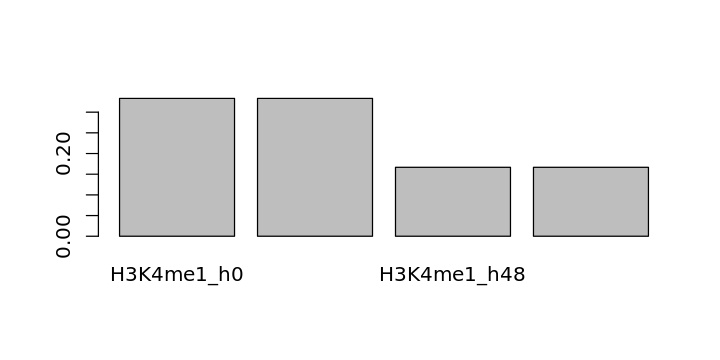

In [40]:
lead.switch.ips = annotate_lead_switches[annotate_lead_switches$stage.y == 'ips',]
lead.switch.ips = lead.switch.ips[lead.switch.ips$global_corr_p_value.x < 0.00001,]
options(repr.plot.width = 6, repr.plot.height = 3)
barplot(get_colsums(lead.switch.ips, "H3K4me1_h")[c(1,3,5,6)])

[1] 128  95

[1]  5 95

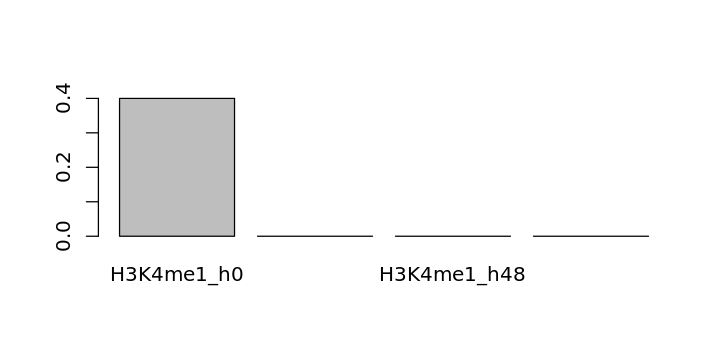

In [41]:
lead.switch.mesendo = annotate_lead_switches[annotate_lead_switches$stage.y == 'mesendo',]
dim(lead.switch.mesendo)
lead.switch.mesendo = lead.switch.mesendo[lead.switch.mesendo$global_corr_p_value.x < 0.00001,]
dim(lead.switch.mesendo)
barplot(get_colsums(lead.switch.mesendo, "H3K4me1_h")[c(1,3,5,6)])

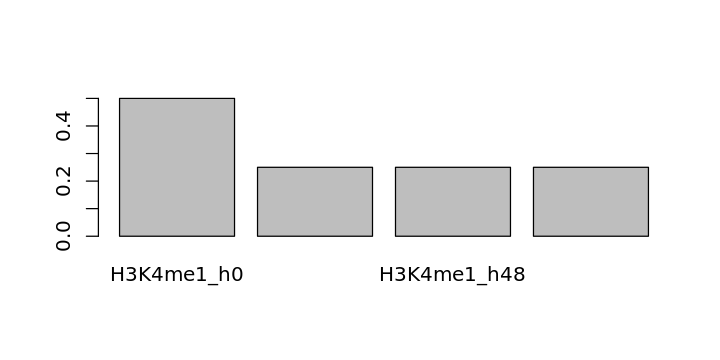

In [42]:
lead.switch.defendo = annotate_lead_switches[annotate_lead_switches$stage.y == 'defendo',]
lead.switch.defendo = lead.switch.defendo[lead.switch.defendo$global_corr_p_value.x < 0.00001,]
barplot(get_colsums(lead.switch.defendo, "H3K4me1_h")[c(1,3,5,6)])

In [115]:
write.csv(lead_switches[,c("beta.mean","snp_id","feature","global_corr_p_value","stage")], 
          "/hps/nobackup/hipsci/scratch/singlecell_endodiff/results_files_20181031/eQTL_results_dfs/lead_switching_eqtls.csv")

In [7]:
res.ips = read.csv("/nfs/leia/research/stegle/acuomo/mean/day0/all_expts/allresults.csv", row.names = 1)
res.mes = read.csv("/nfs/leia/research/stegle/acuomo/mean/mesendo_est_June20/allresults.csv", row.names = 1)
res.defendo = read.csv("/nfs/leia/research/stegle/acuomo/mean/defendo_est_June20/allresults.csv", row.names = 1)

In [117]:
nrow(lead_switches)
length(unique(lead_switches$feature))

[1] 330

[1] 155

[1] 2


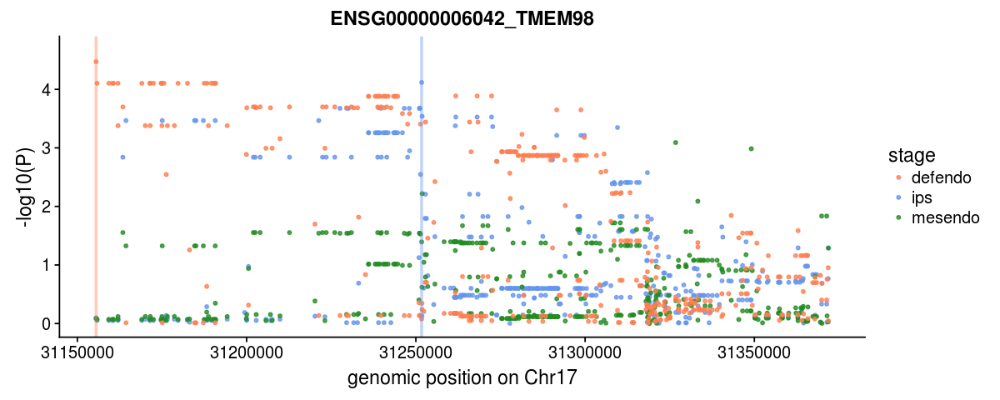

[1] 3


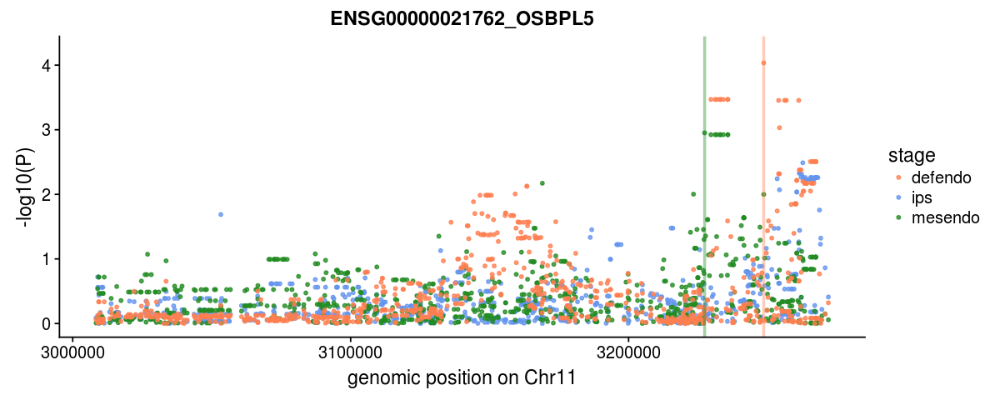

[1] 4


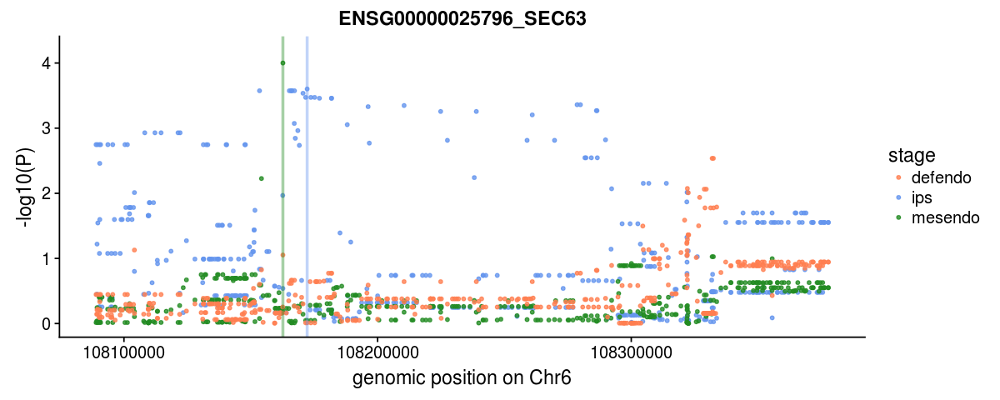

[1] 6


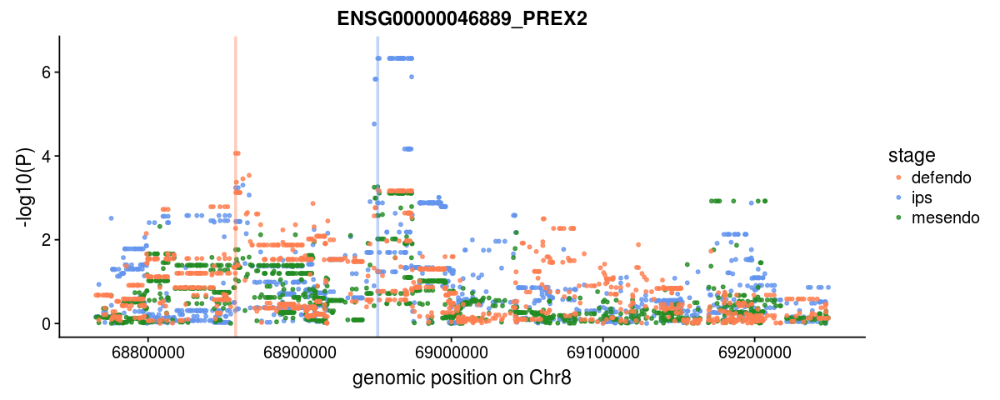

[1] 7


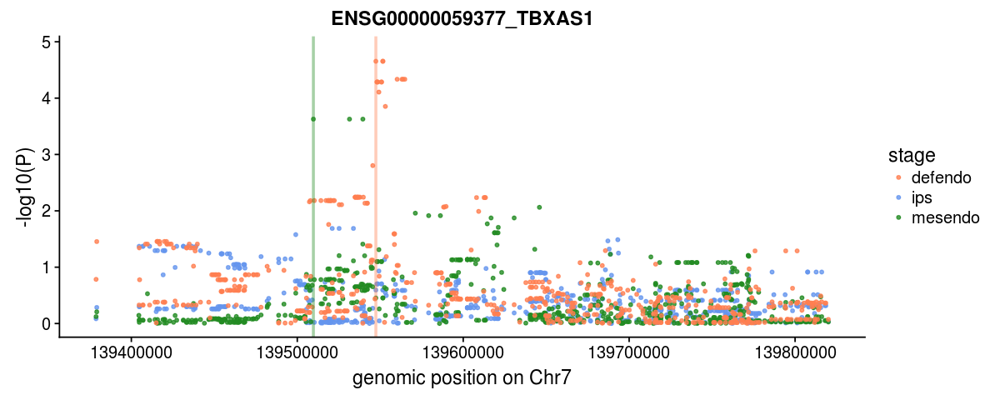

[1] 8


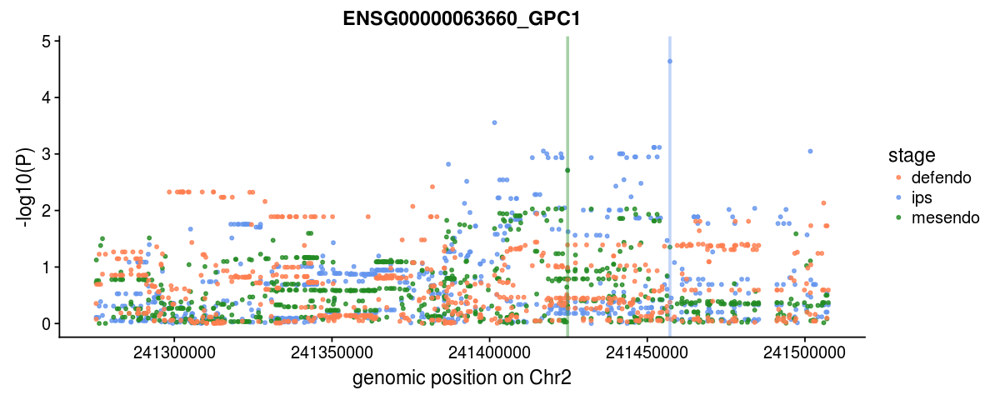

[1] 9


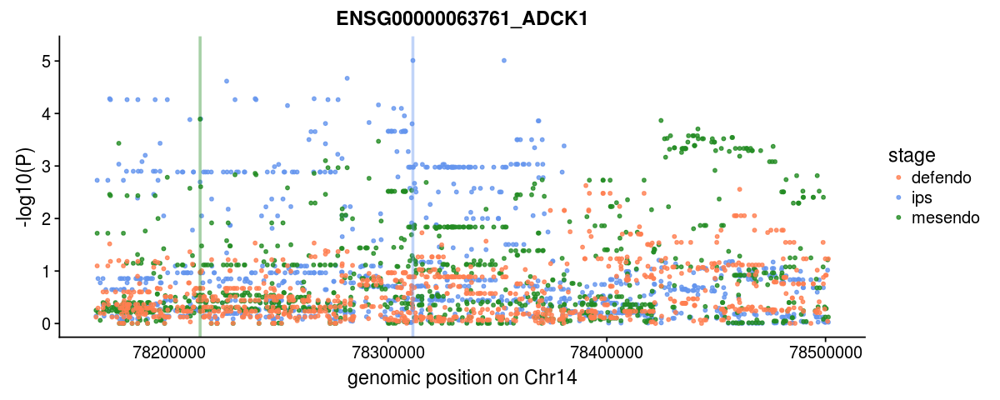

[1] 10


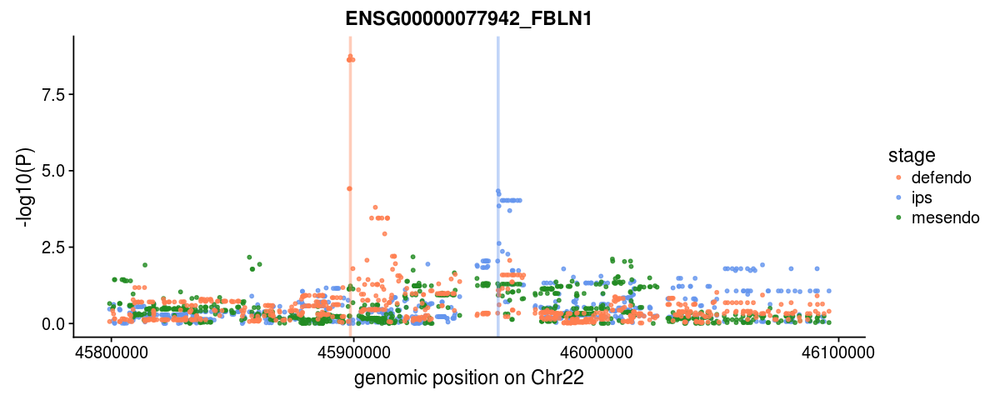

[1] 11


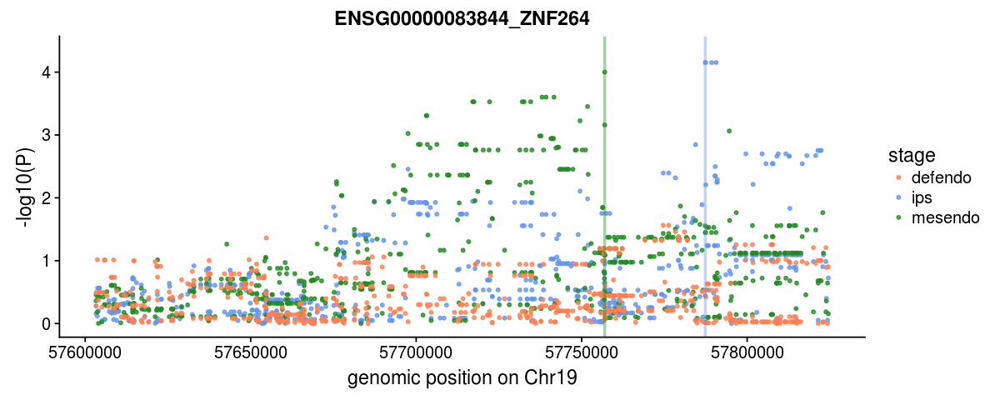

[1] 12


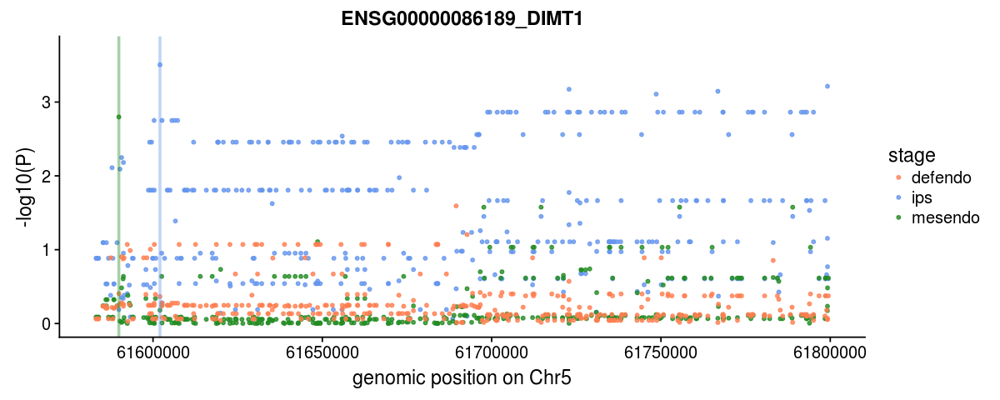

[1] 13


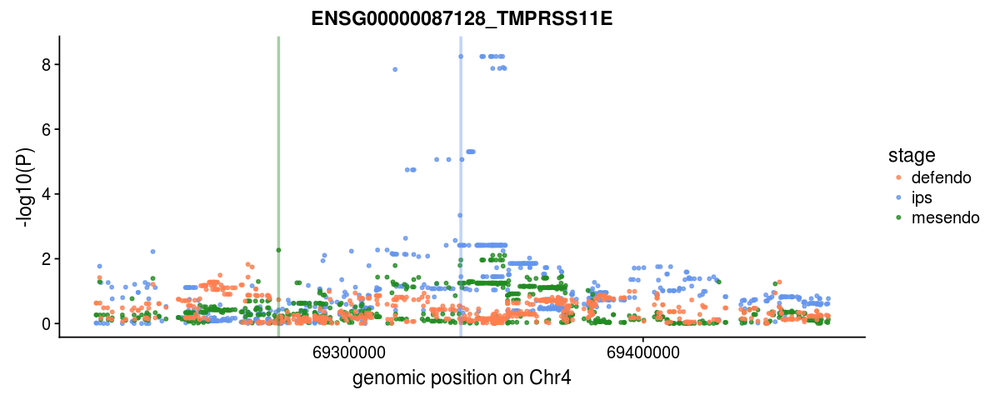

[1] 14


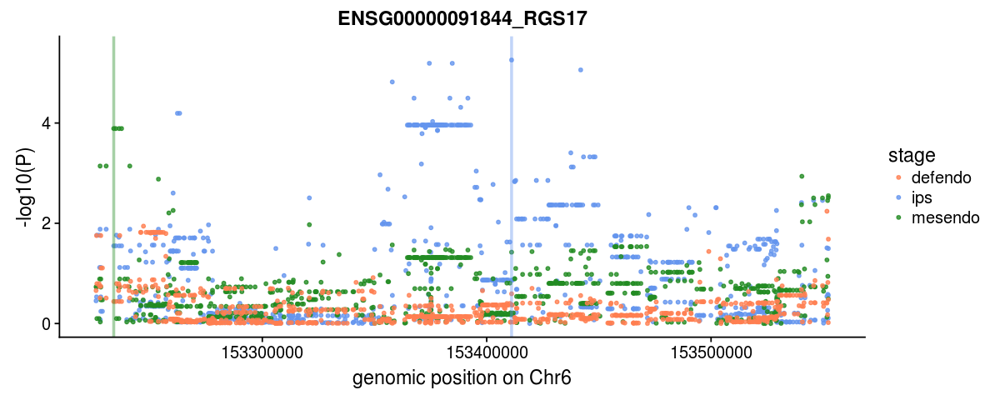

[1] 15


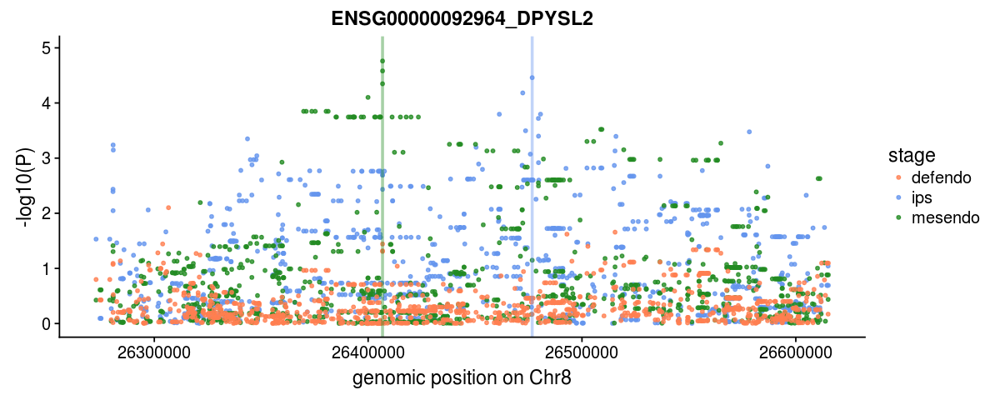

[1] 16


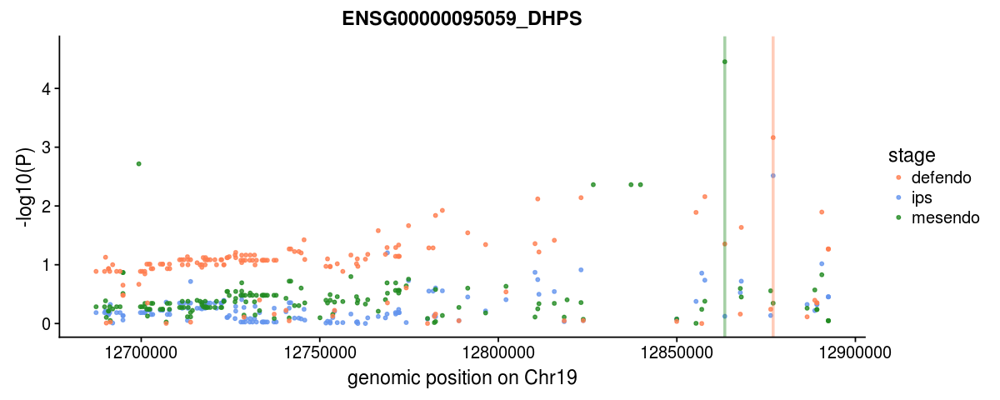

[1] 17


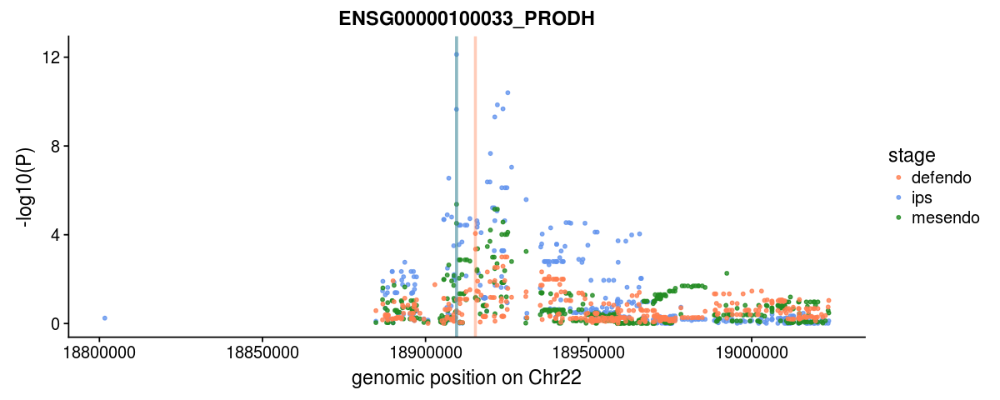

[1] 18


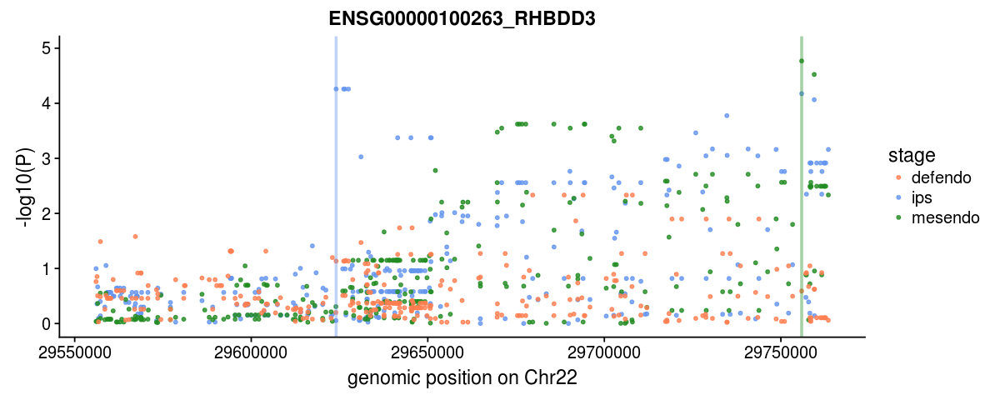

[1] 19


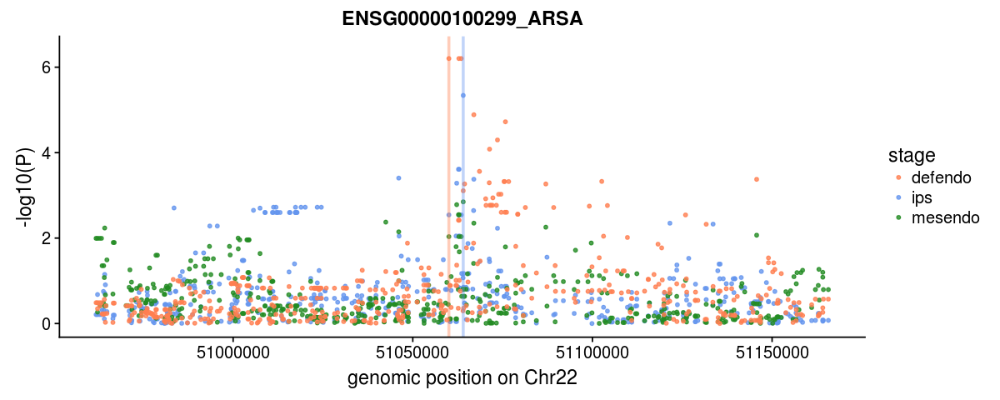

[1] 20


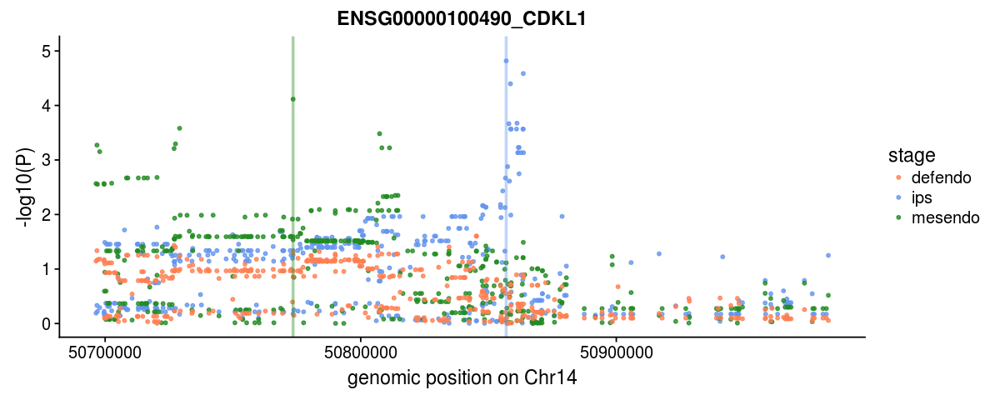

[1] 22


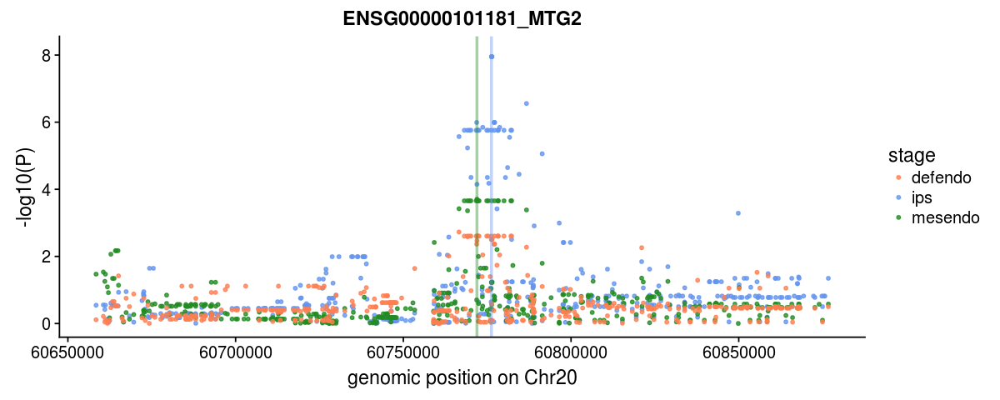

[1] 23


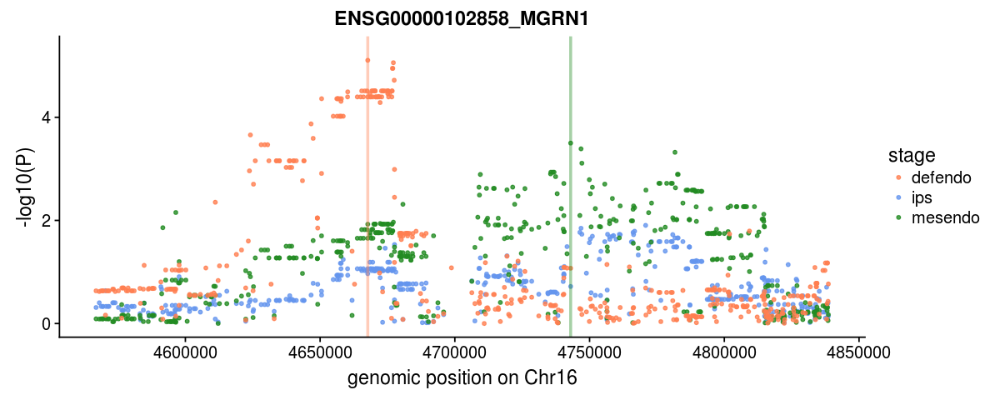

[1] 24


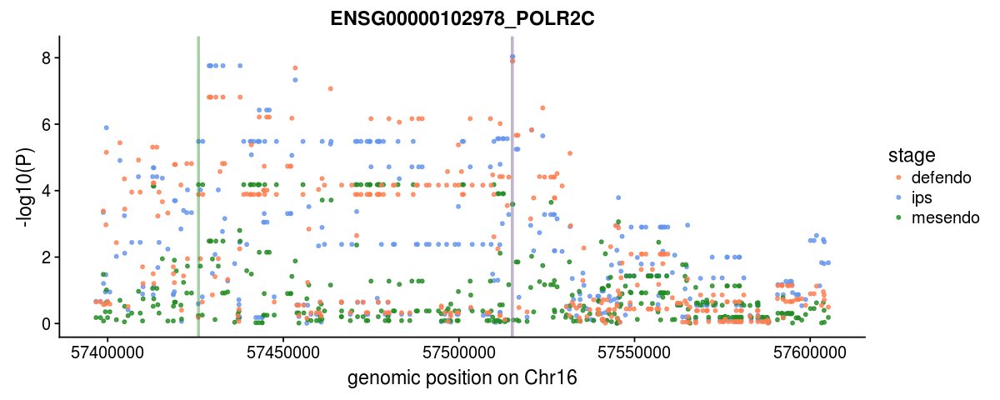

[1] 25


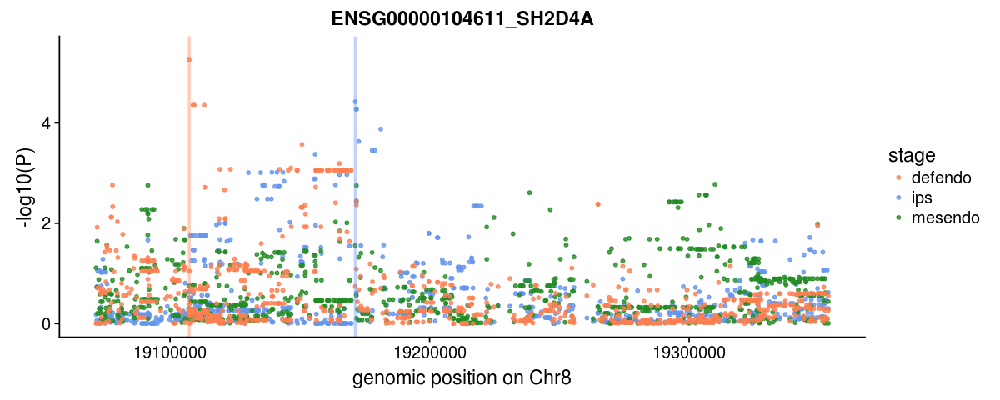

[1] 26


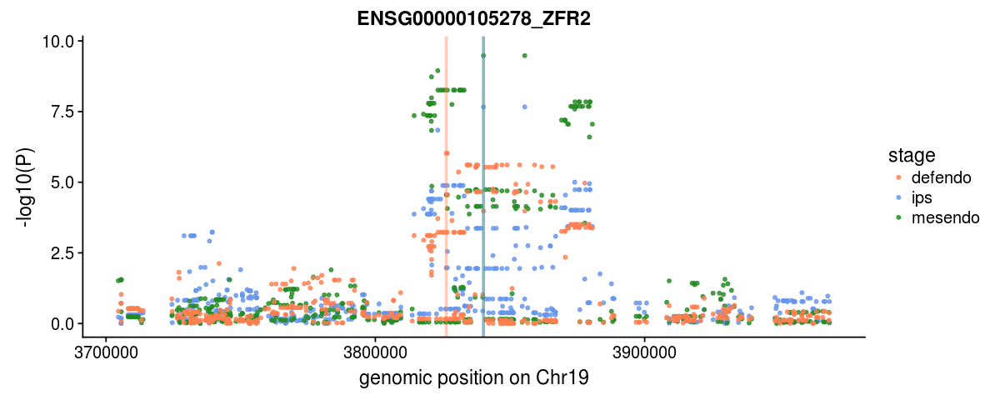

[1] 27


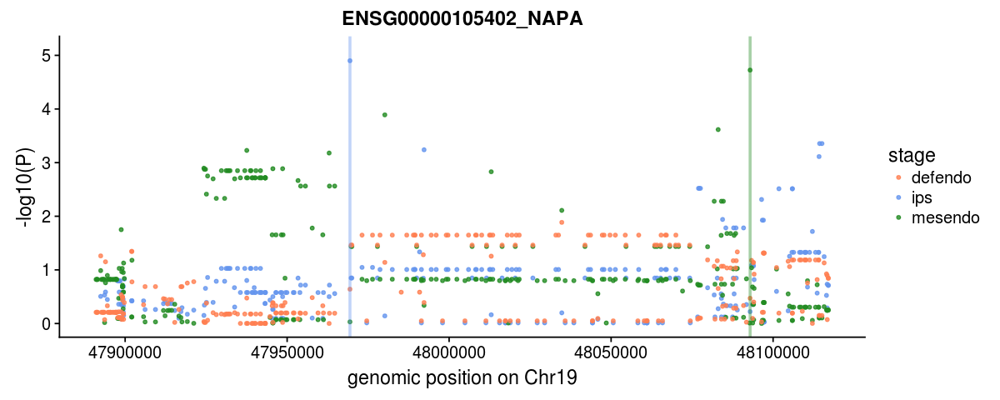

[1] 28


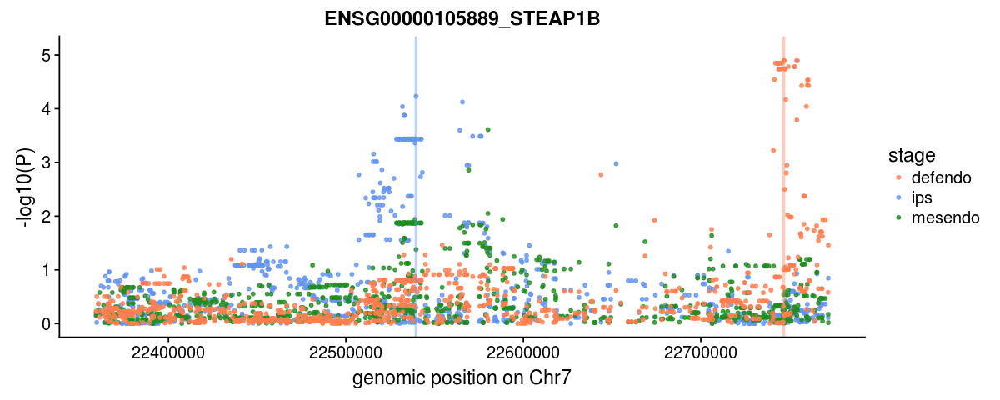

[1] 29


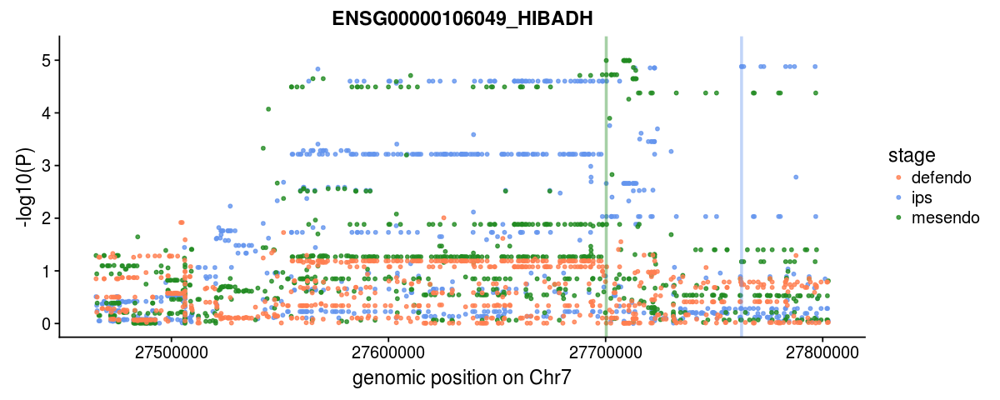

[1] 30


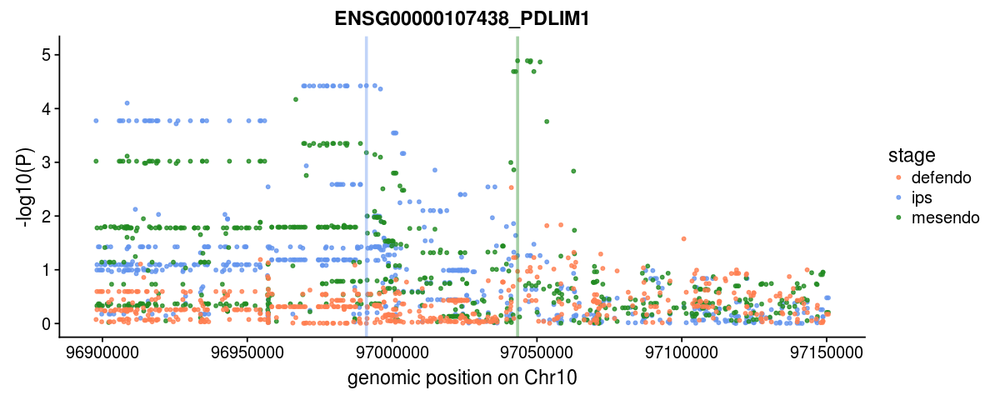

[1] 31


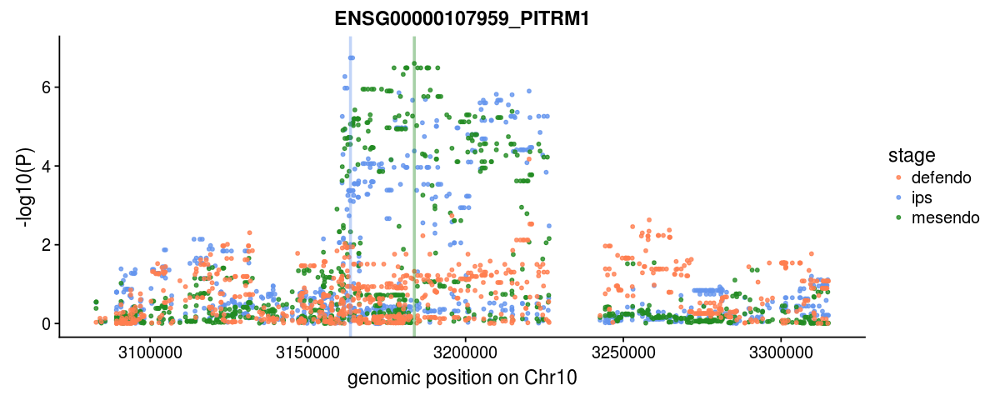

[1] 32


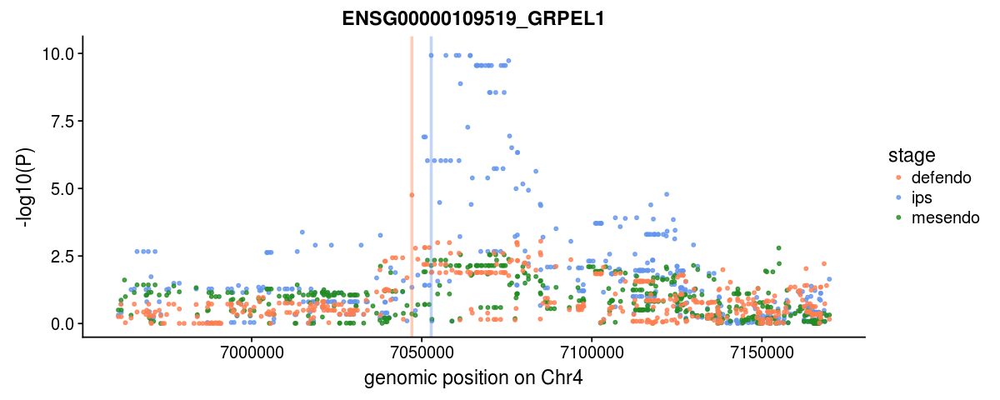

[1] 33


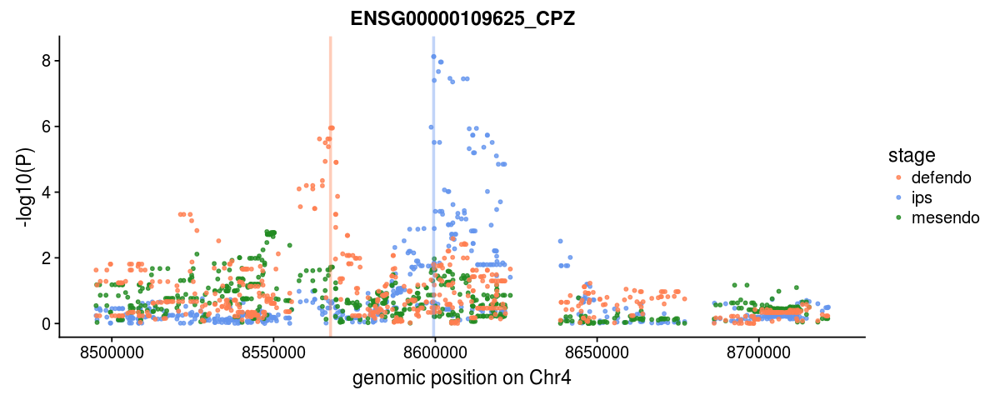

[1] 34


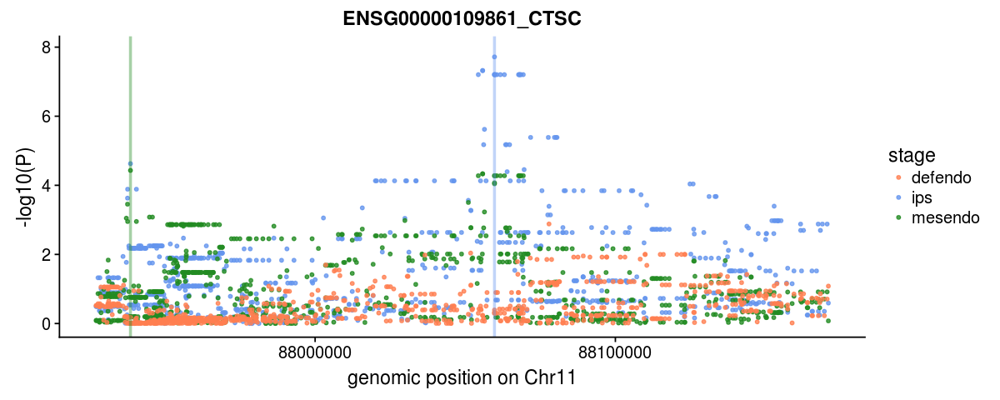

[1] 36


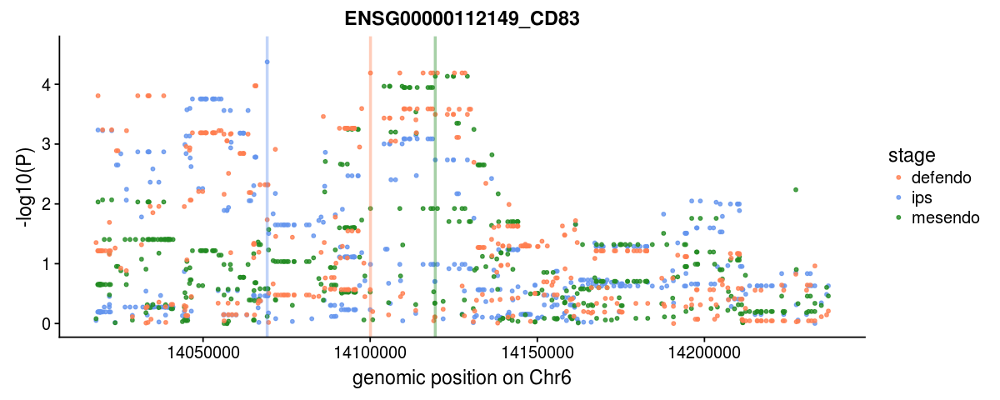

[1] 37


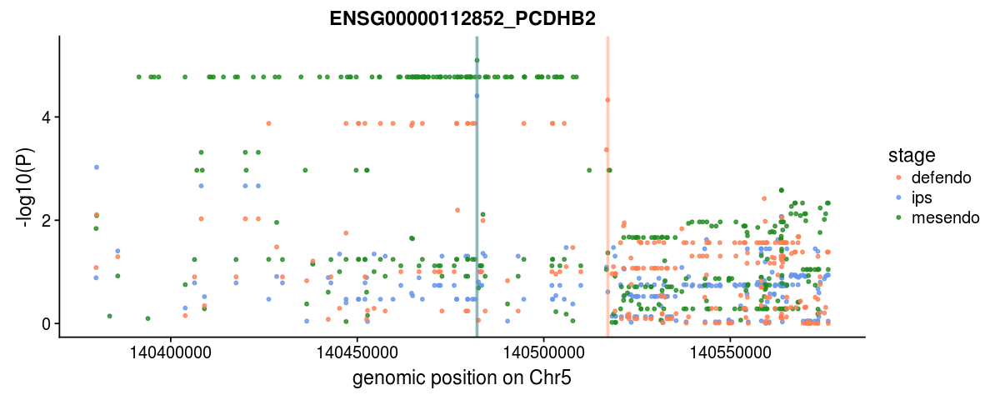

[1] 38


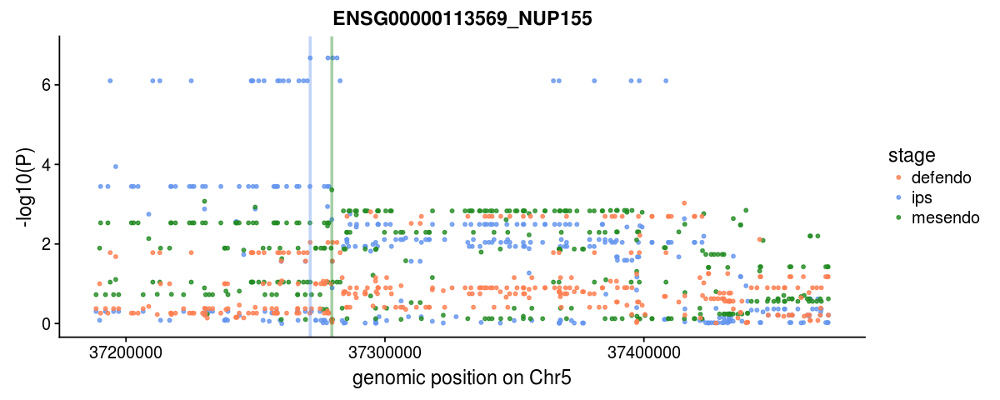

[1] 39


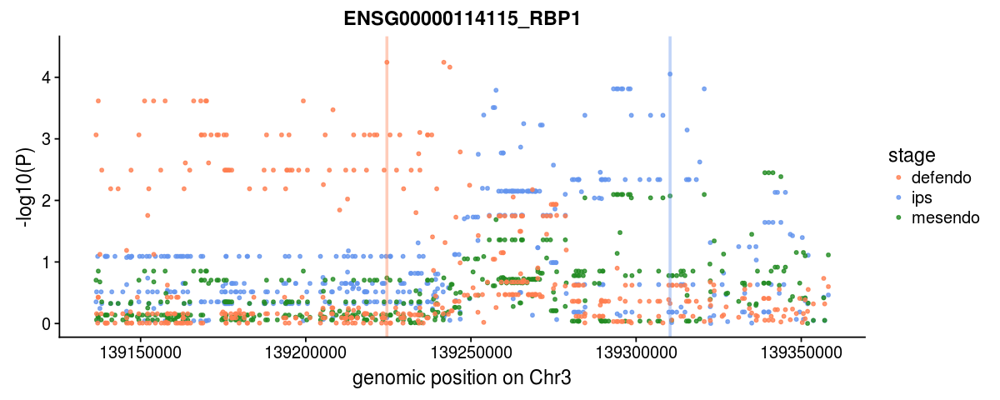

[1] 40


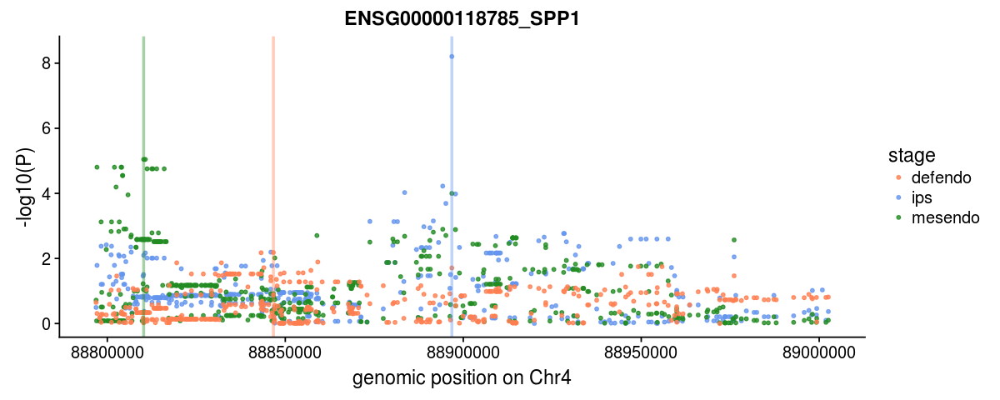

[1] 41


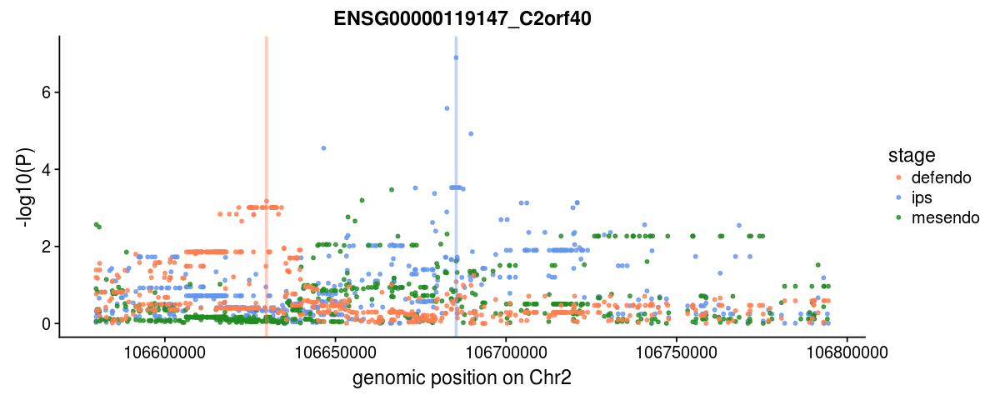

[1] 42


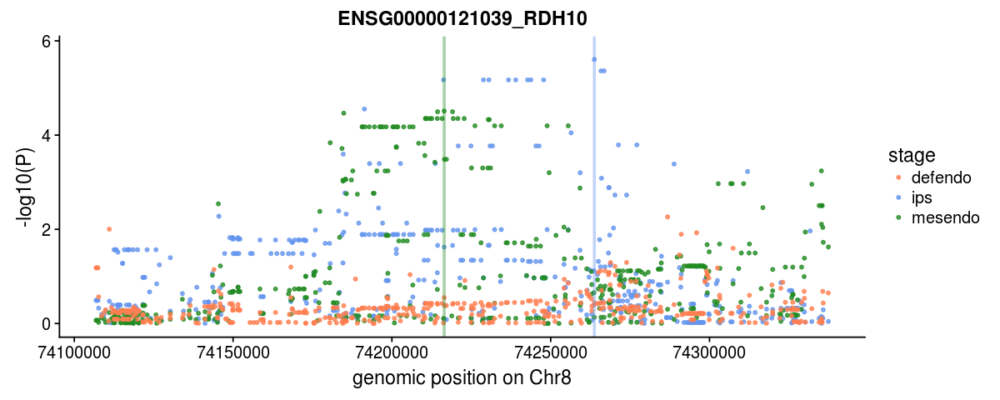

[1] 43


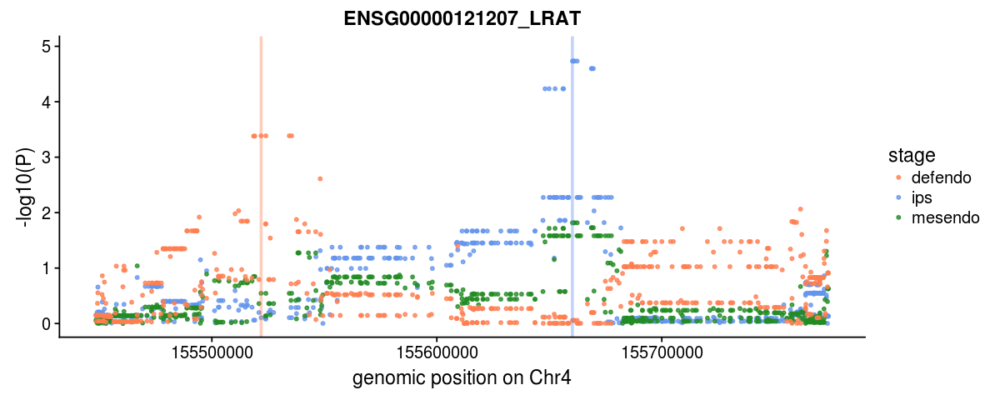

[1] 44


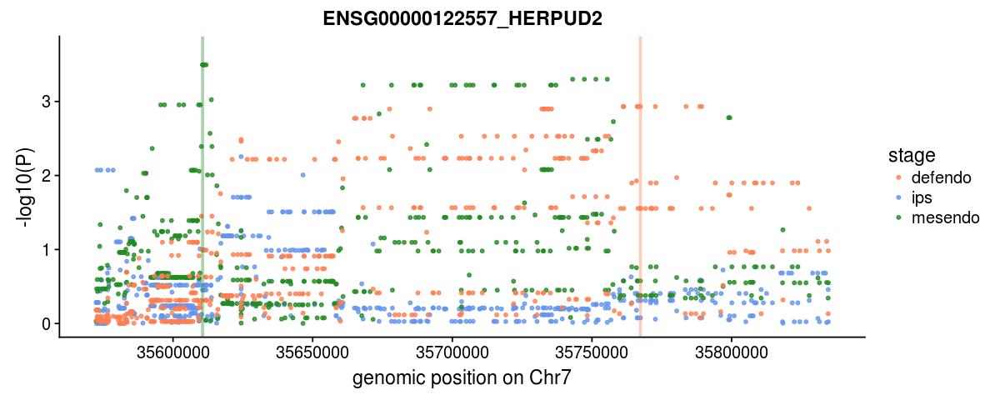

[1] 45


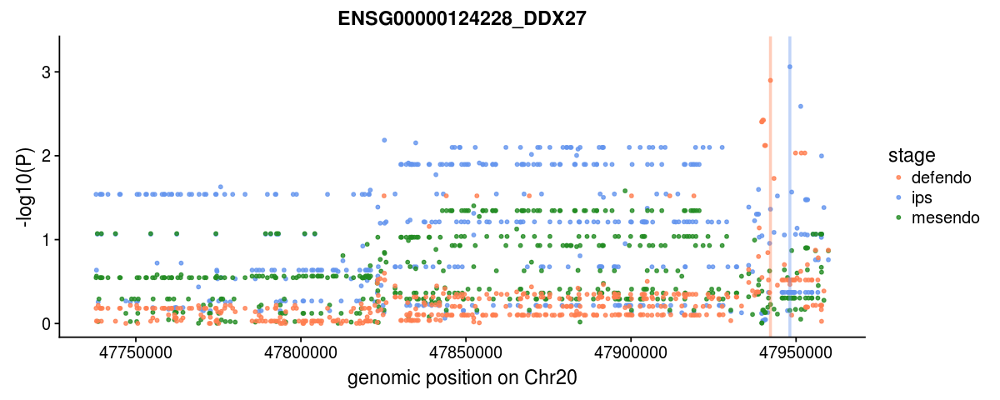

[1] 46


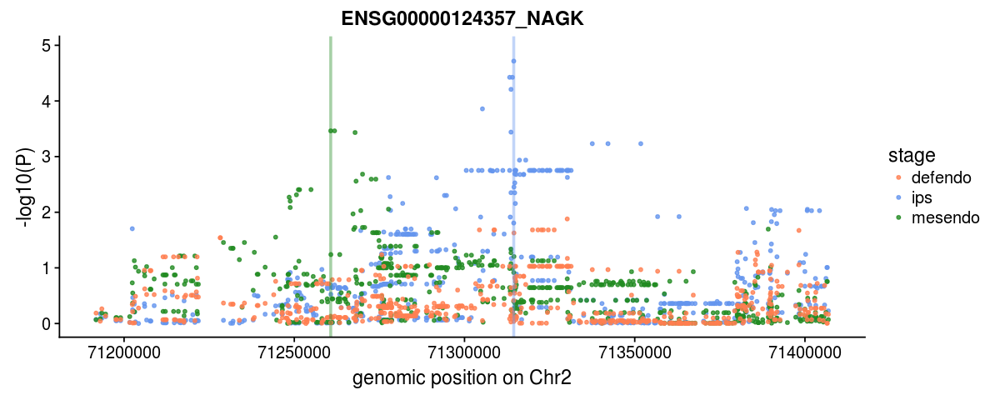

[1] 47


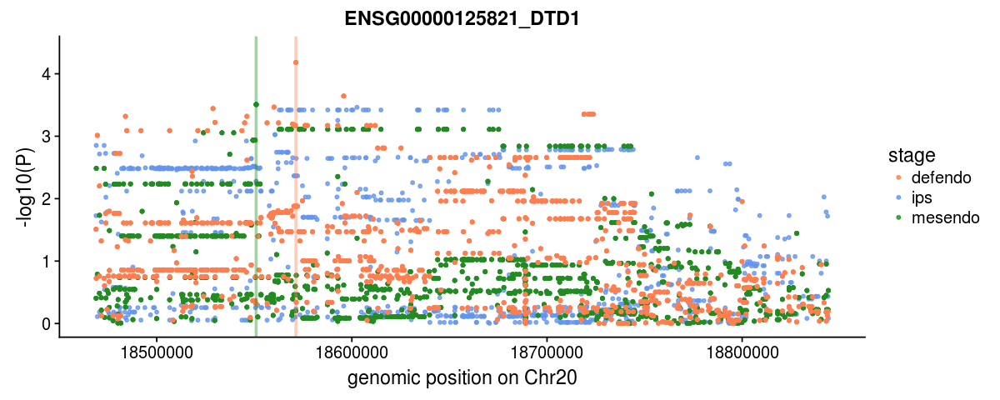

[1] 49


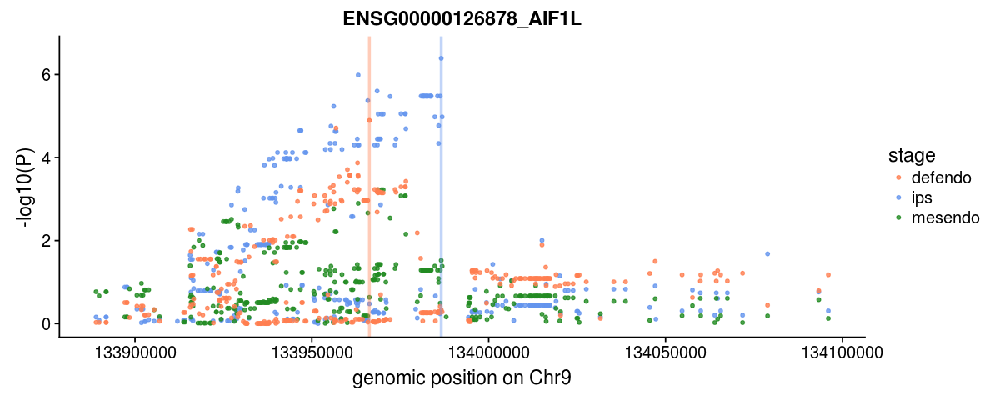

[1] 50


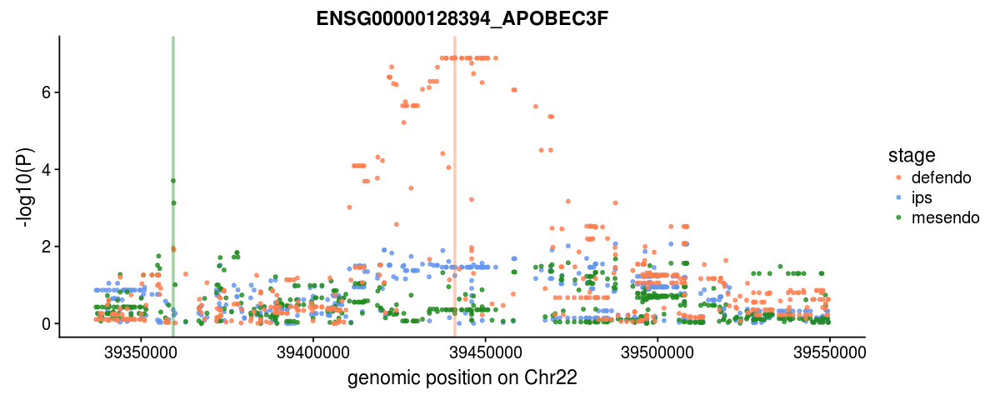

[1] 51


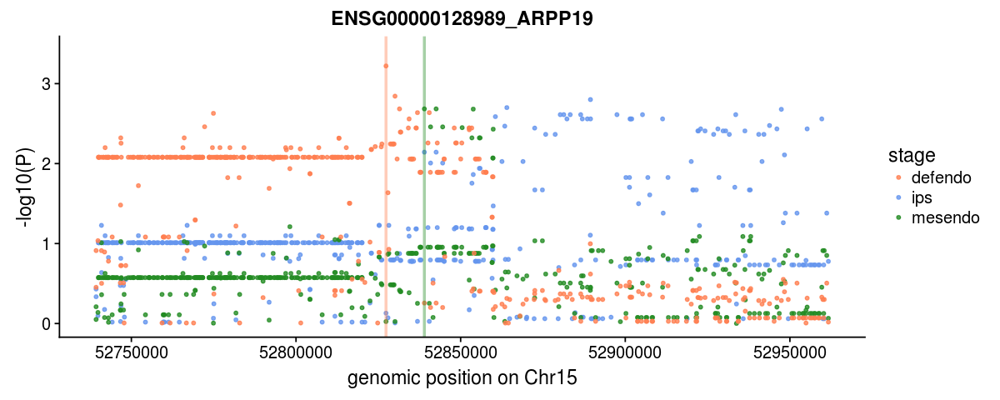

[1] 52


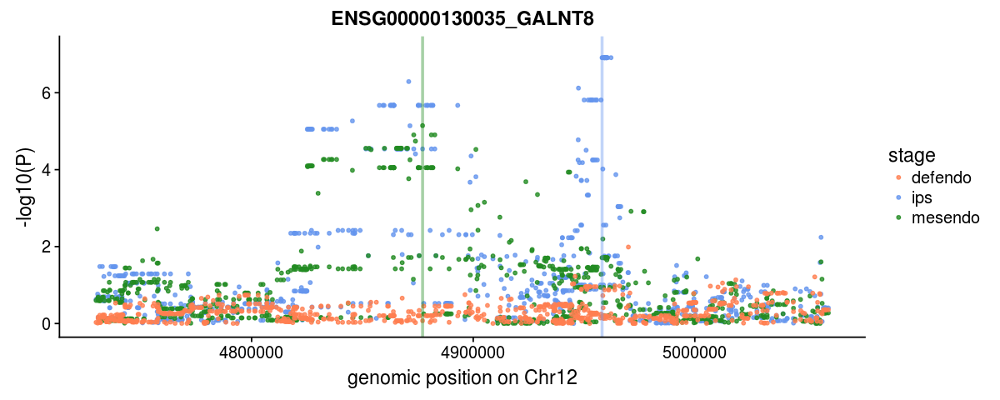

[1] 53


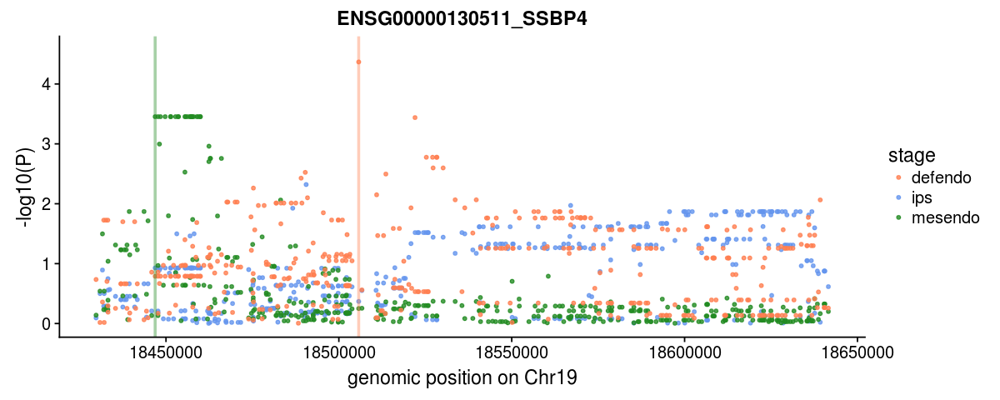

[1] 54


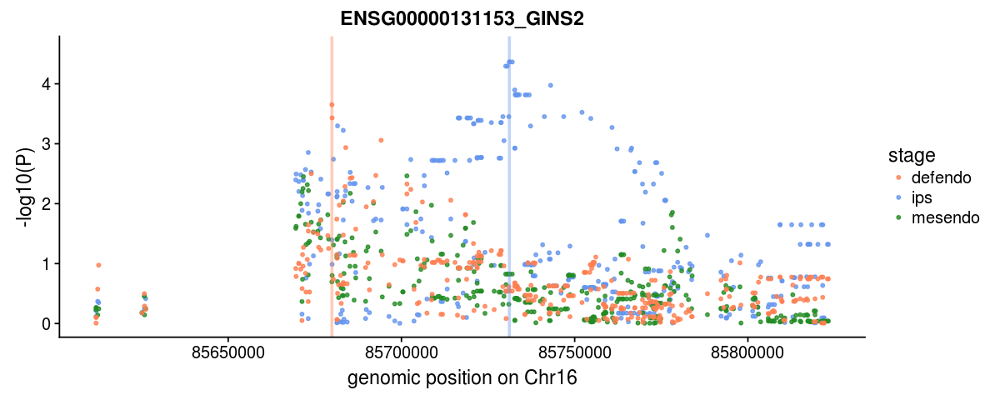

[1] 55


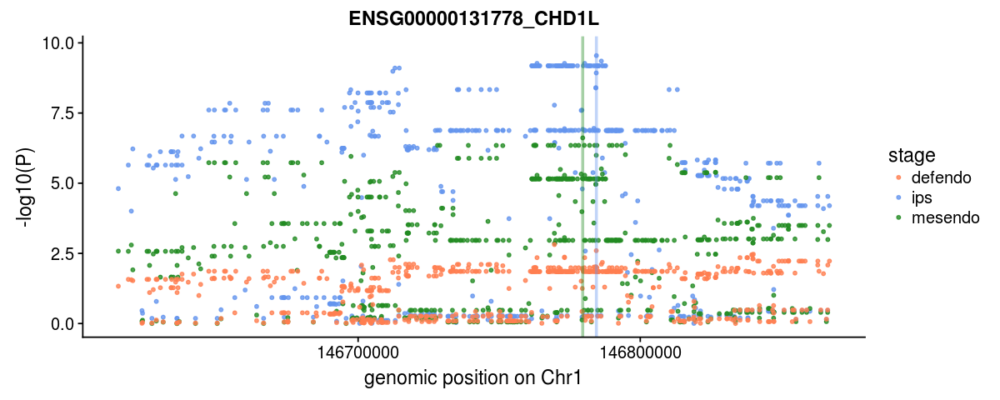

[1] 56


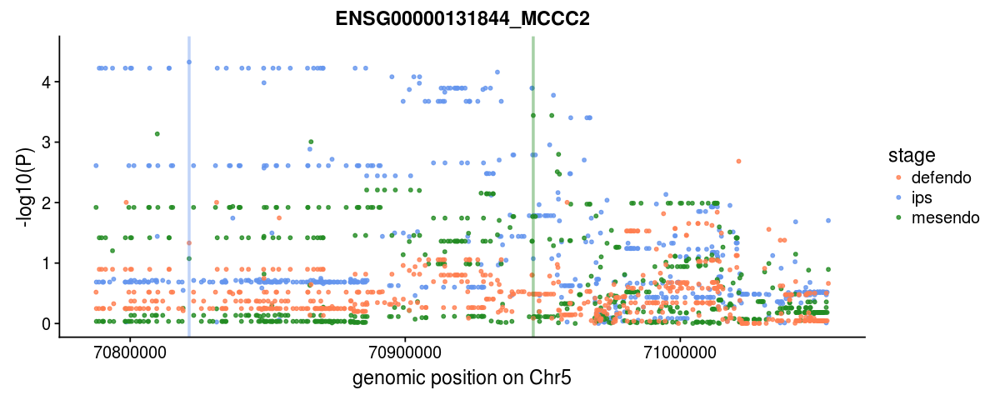

[1] 57


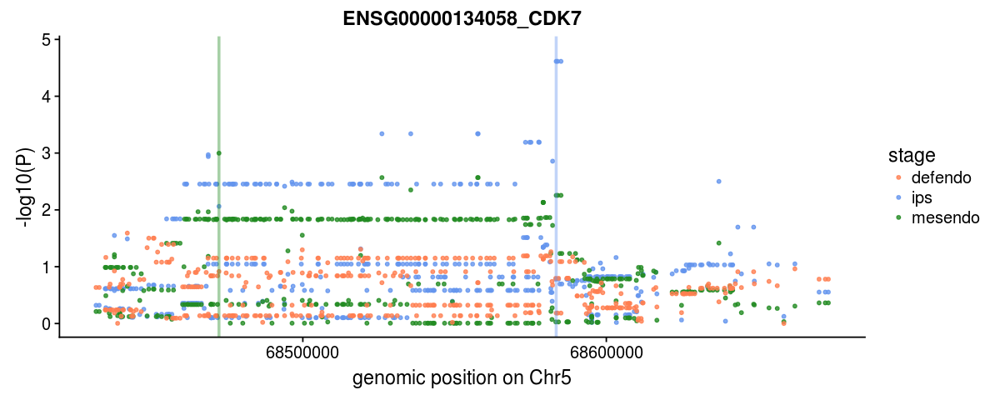

[1] 58


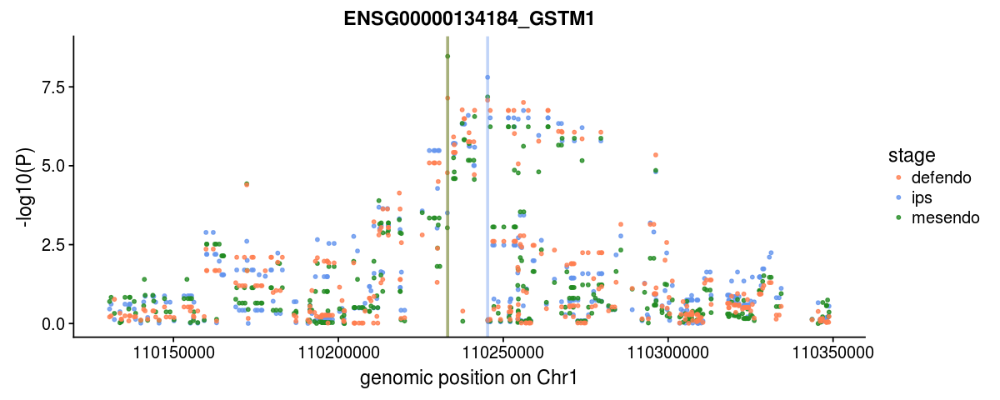

[1] 59


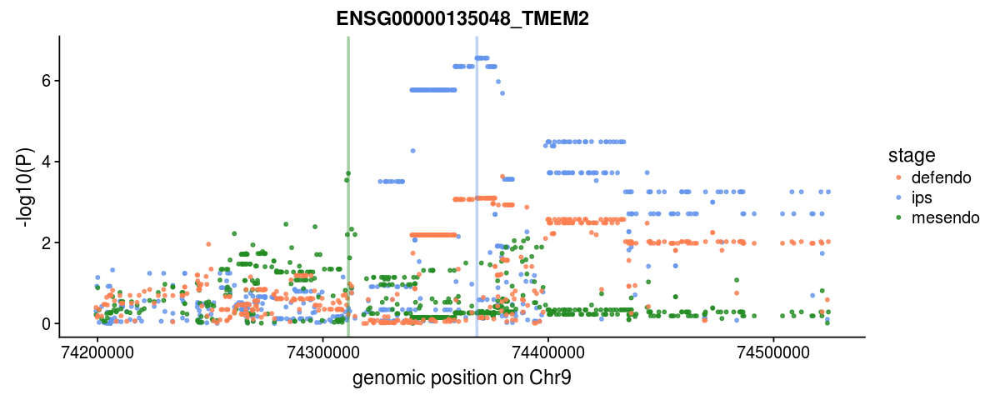

[1] 60


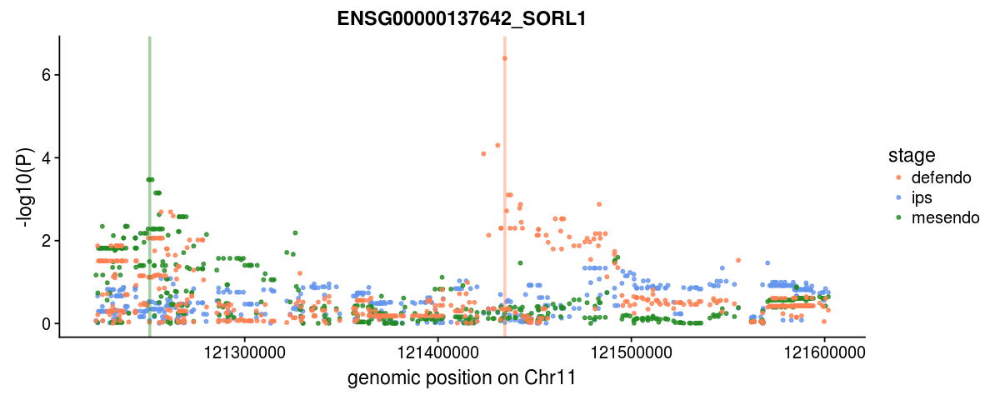

[1] 62


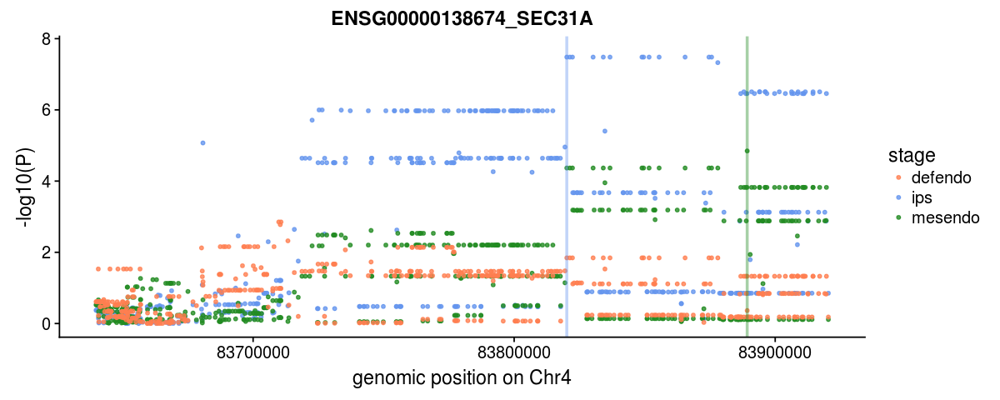

[1] 63


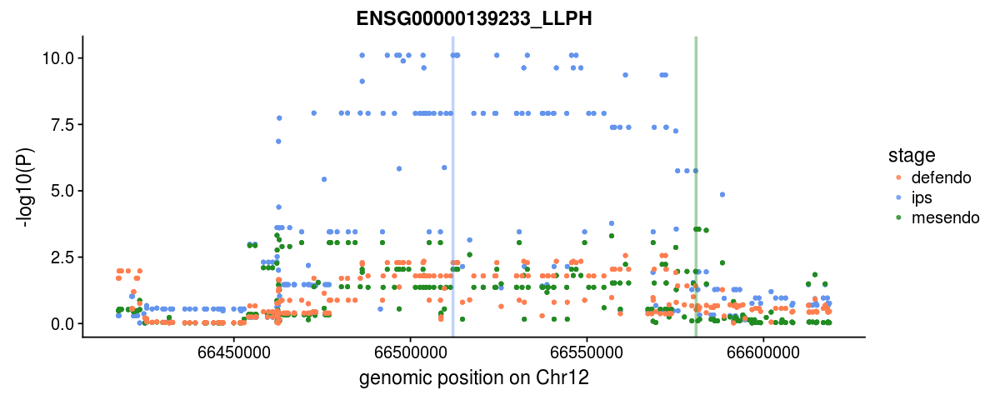

[1] 64


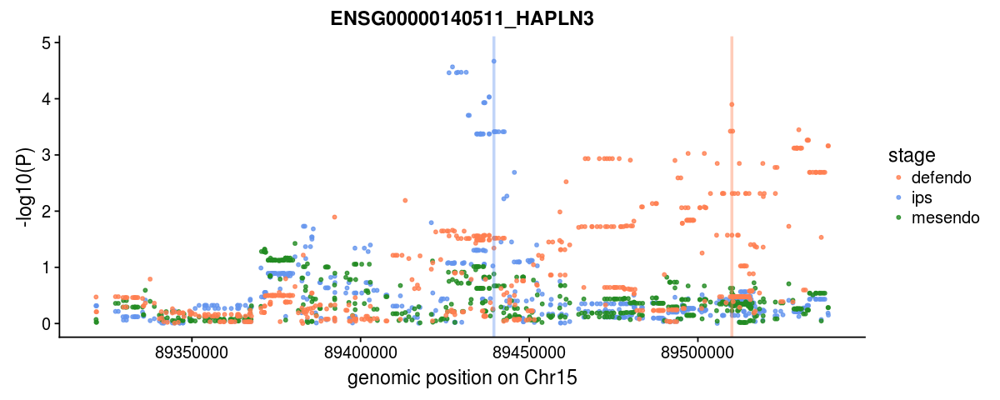

[1] 65


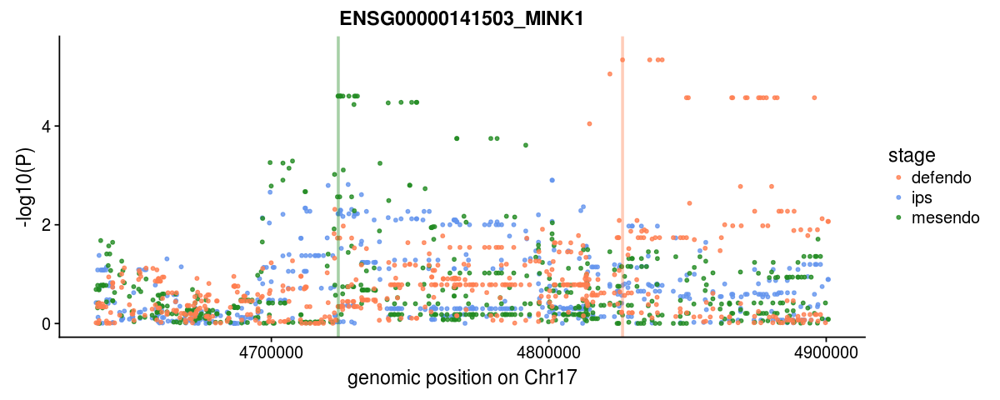

[1] 66


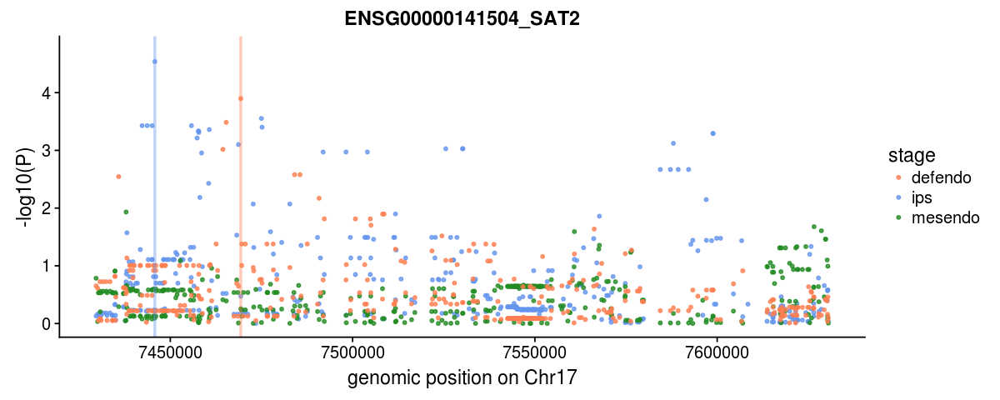

[1] 67


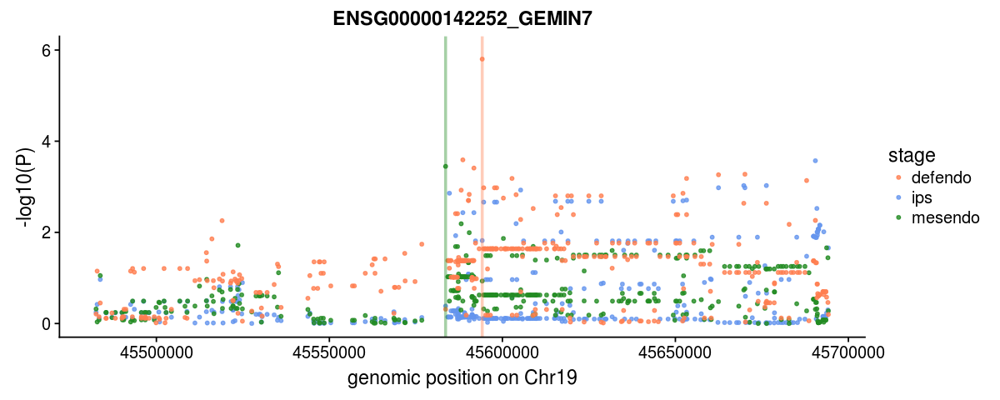

[1] 68


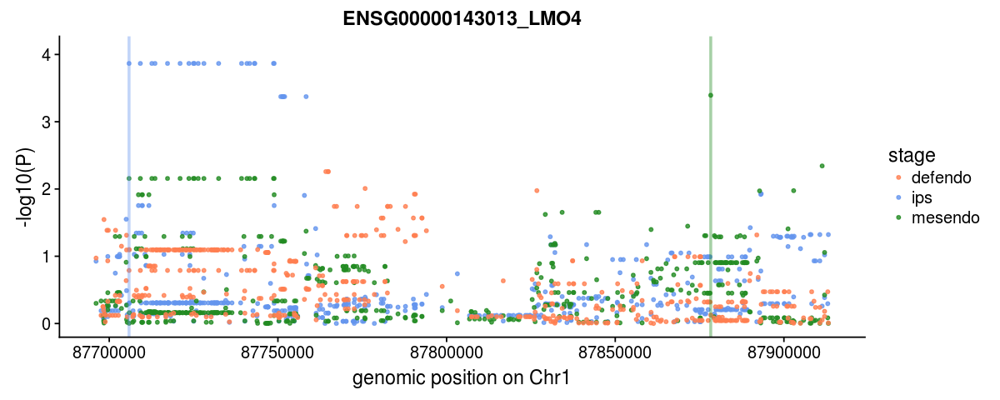

[1] 69


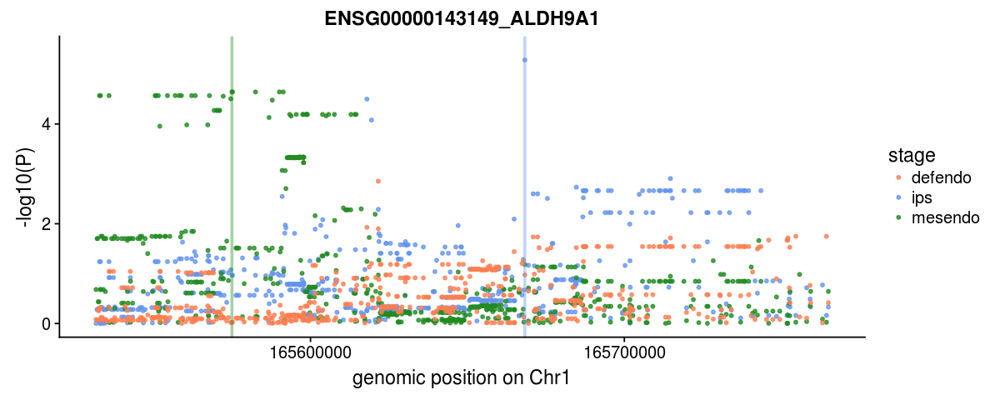

[1] 70


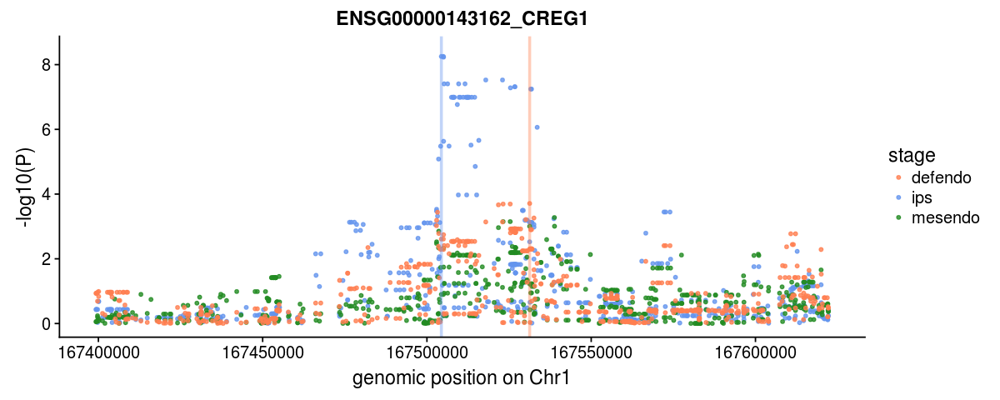

[1] 71


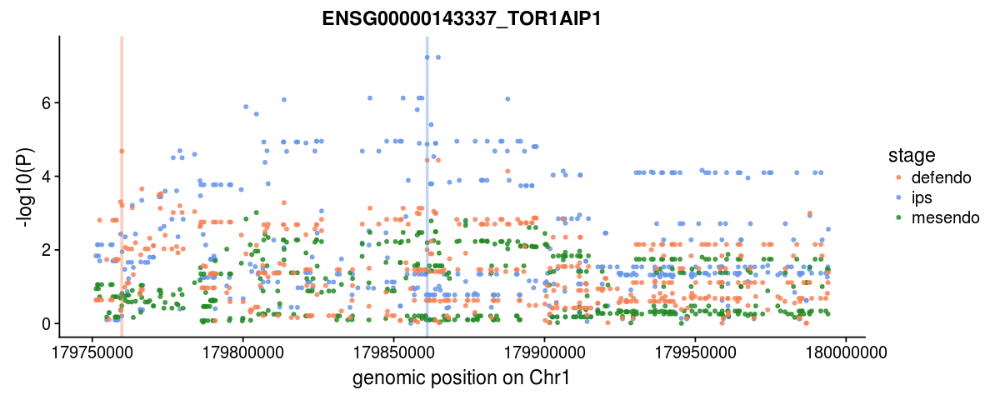

[1] 72


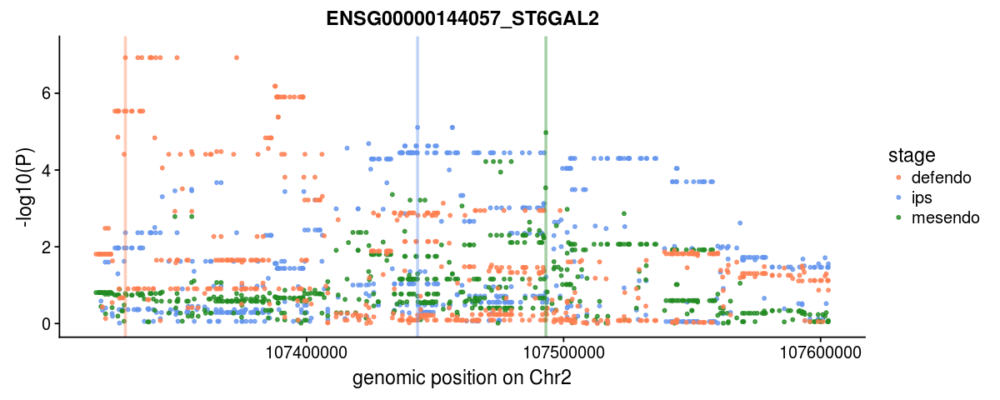

[1] 73


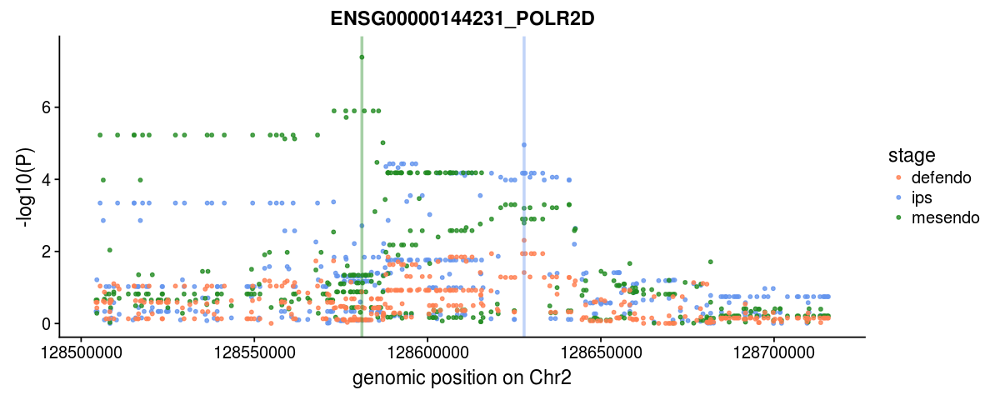

[1] 74


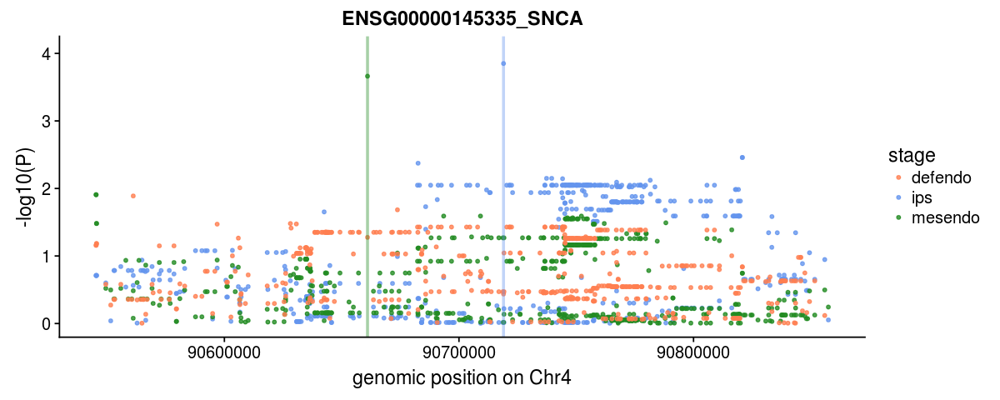

[1] 75


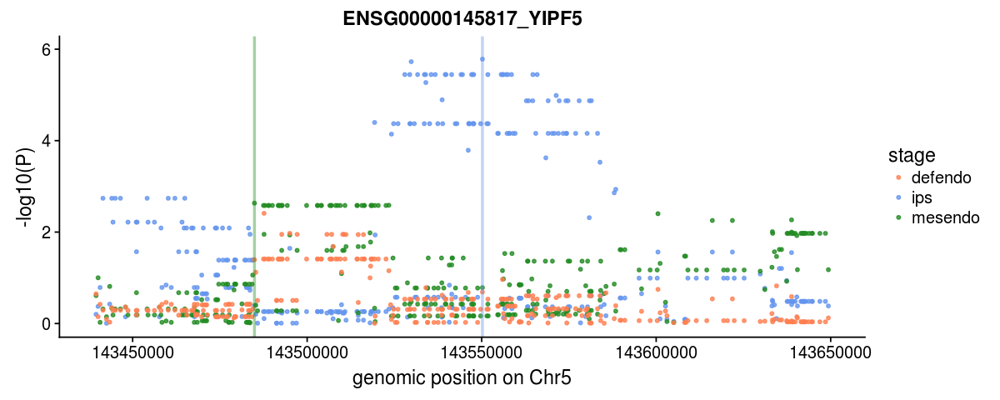

[1] 76


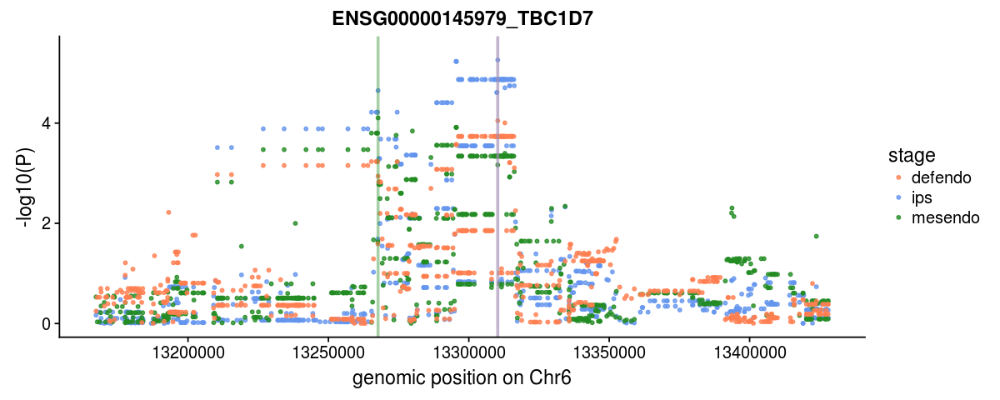

[1] 77


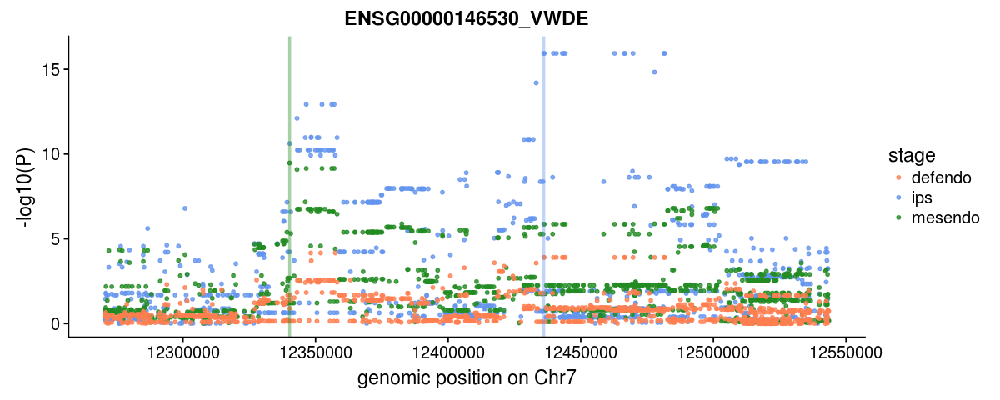

[1] 79


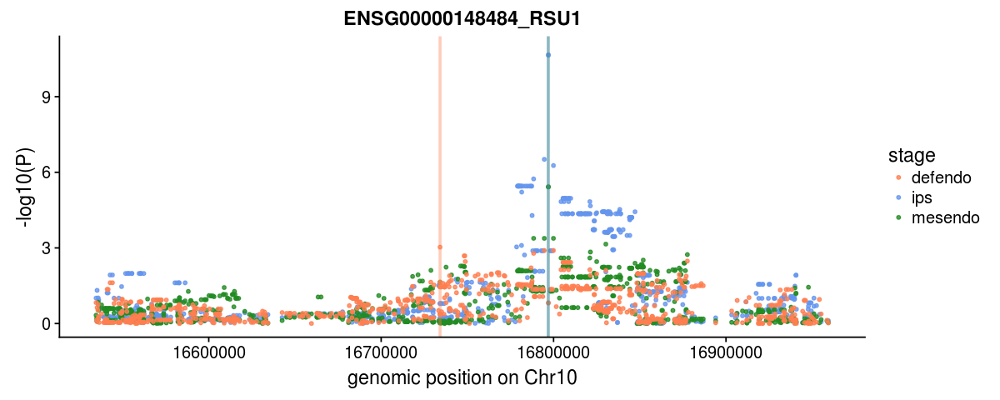

[1] 80


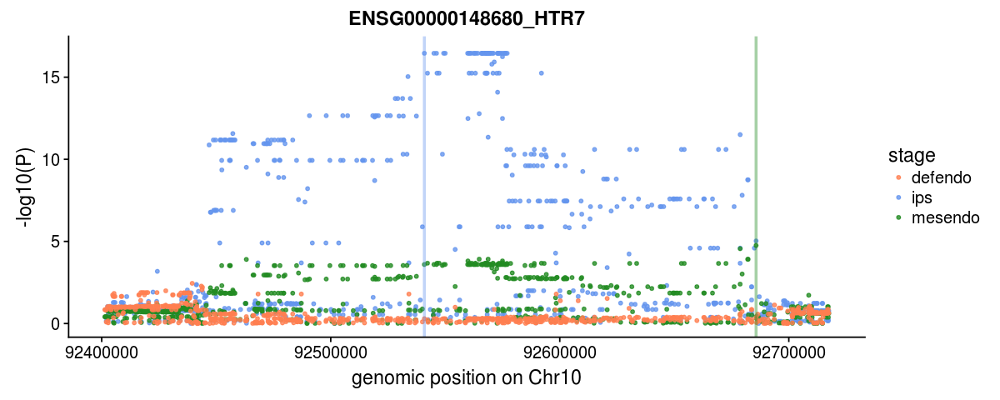

[1] 81


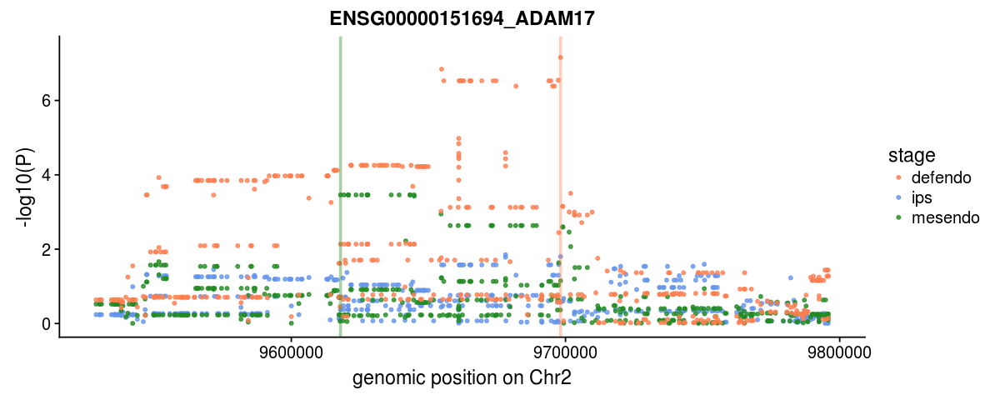

[1] 82


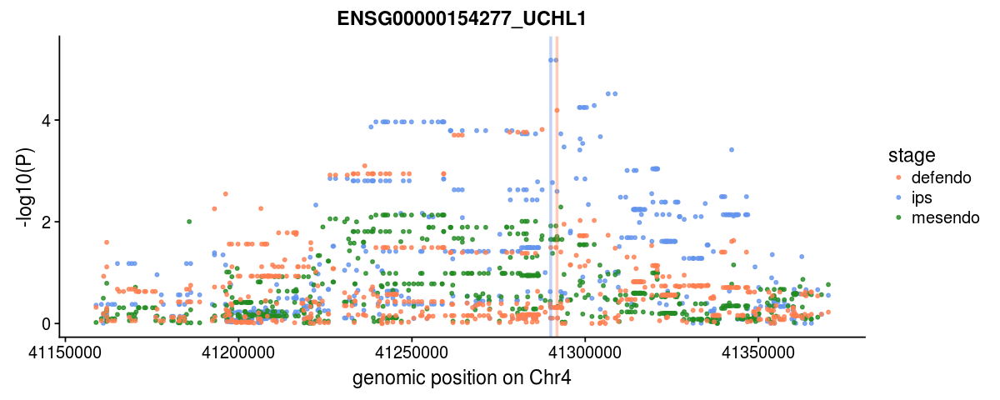

[1] 83


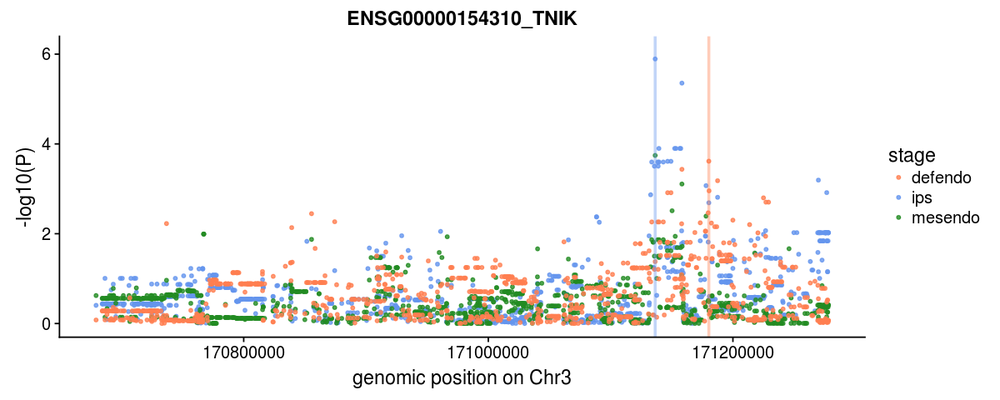

[1] 84


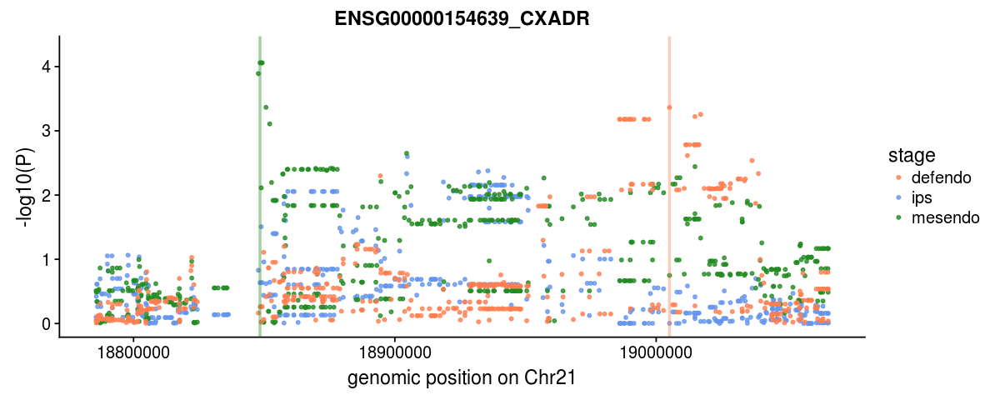

[1] 85


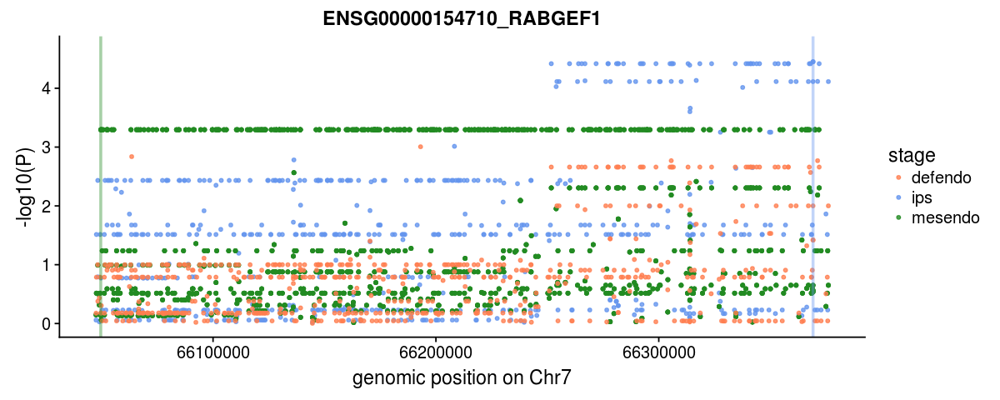

[1] 86


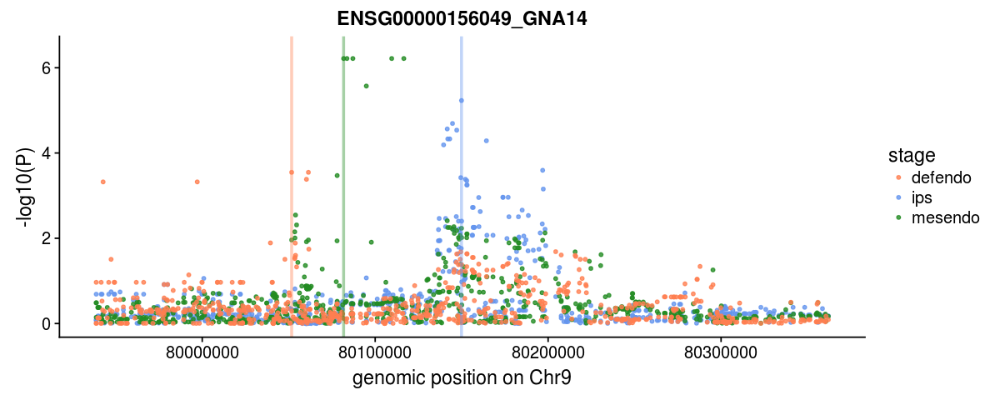

[1] 87


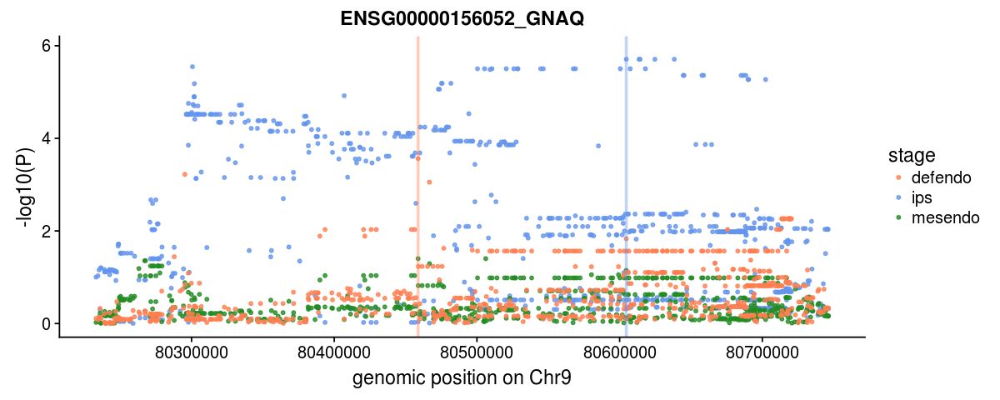

[1] 88


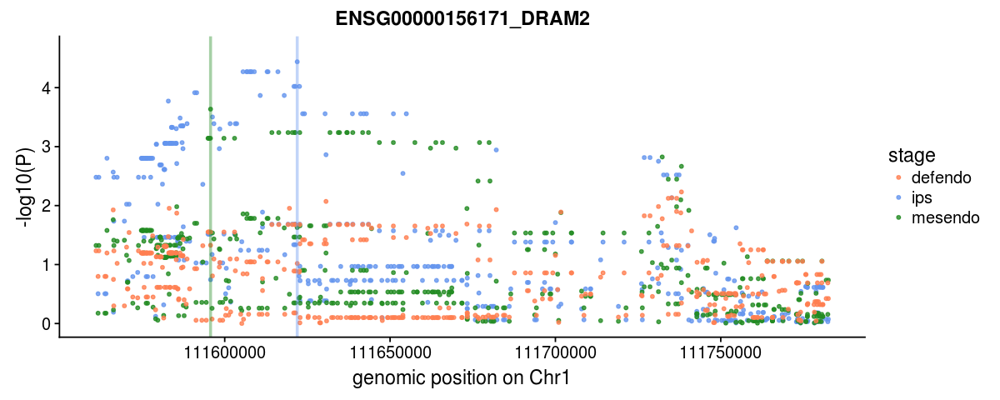

[1] 89


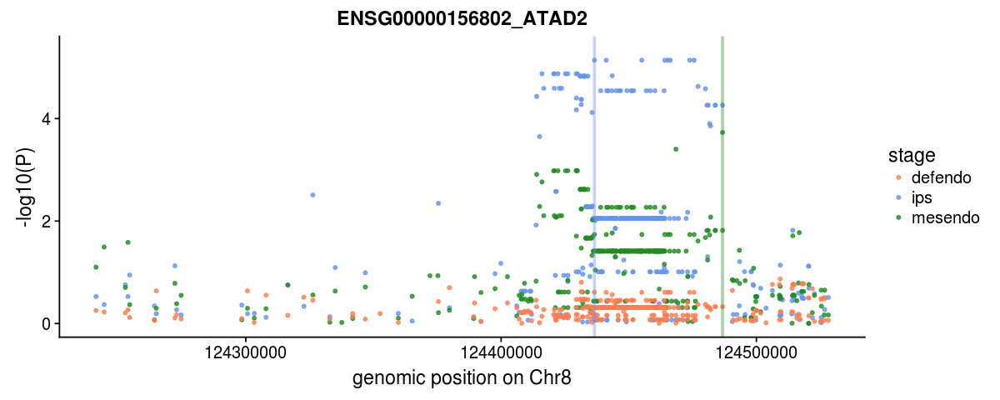

[1] 90


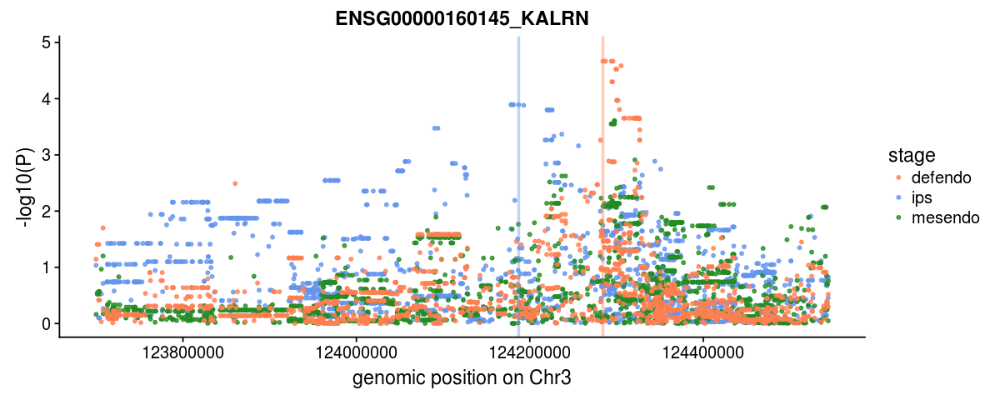

[1] 91


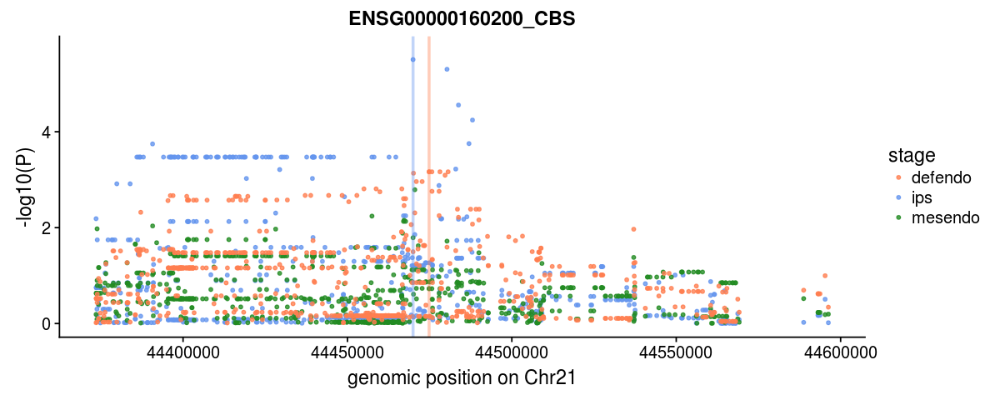

[1] 92


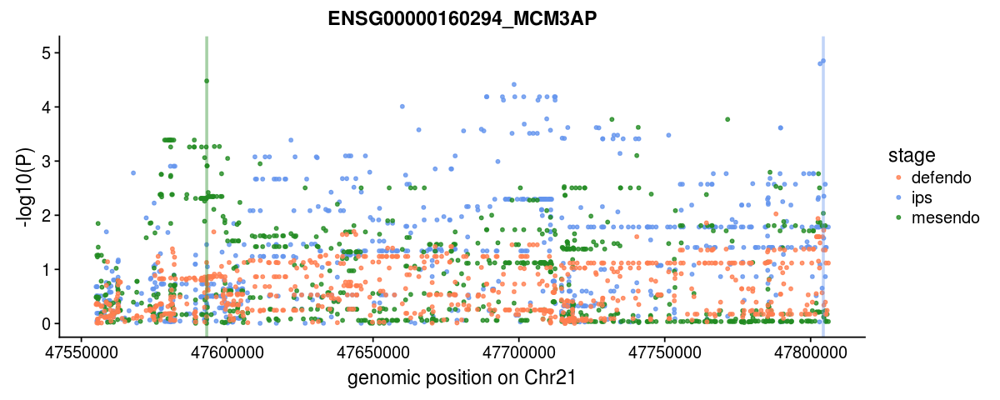

[1] 93


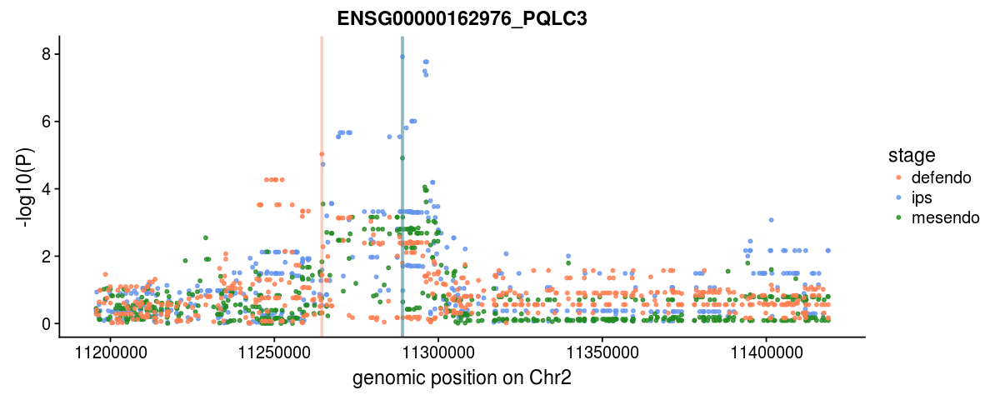

[1] 94


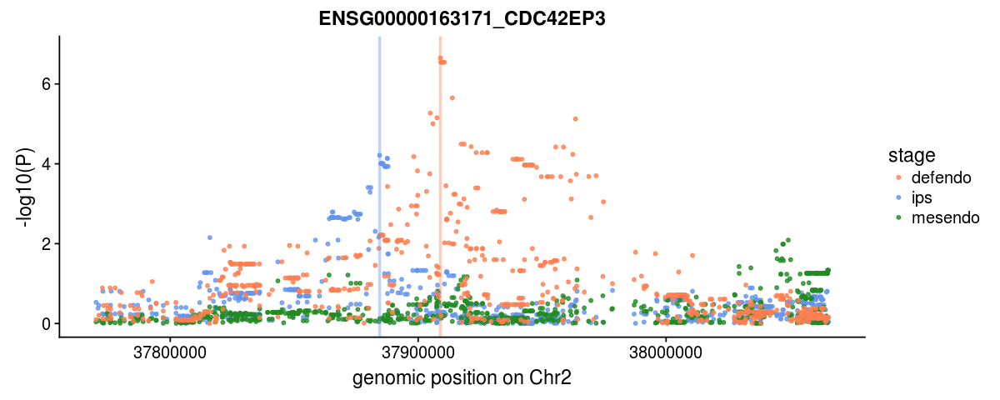

[1] 96


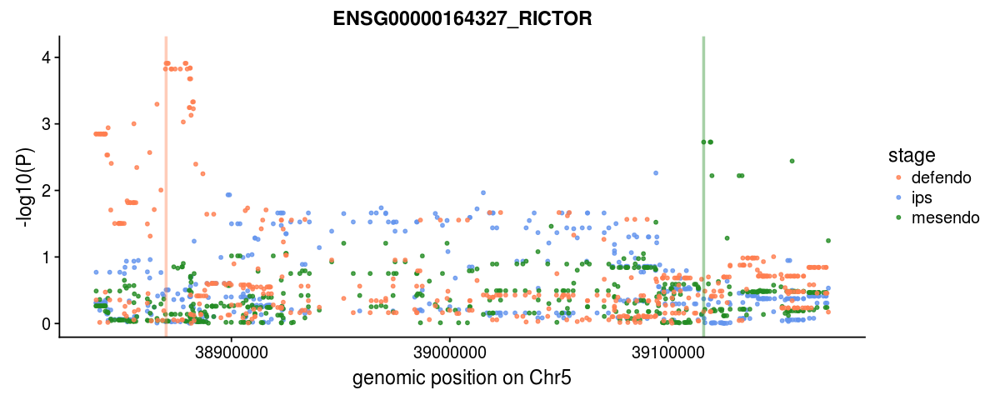

[1] 97


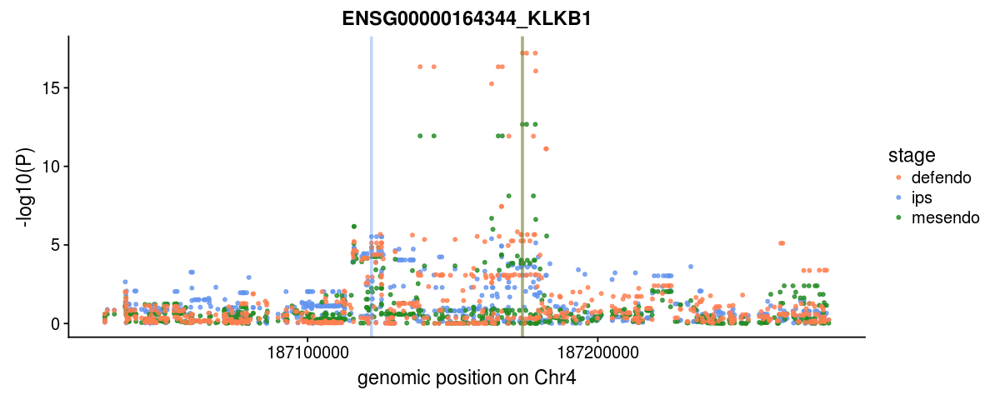

[1] 98


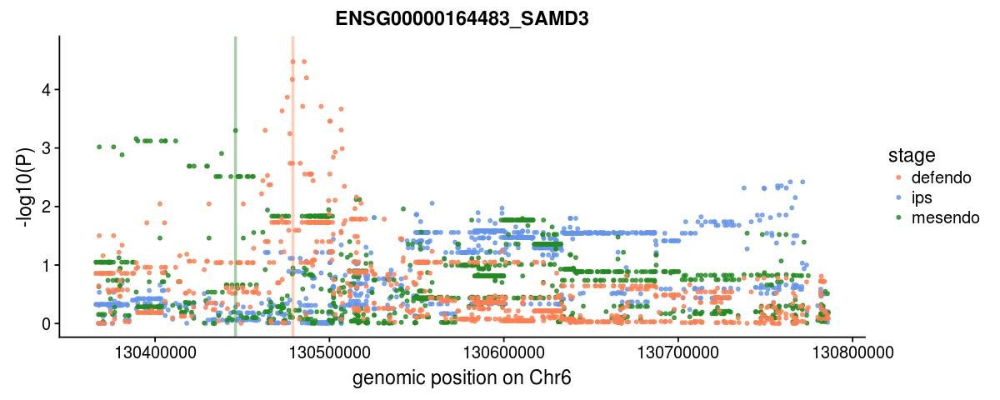

[1] 99


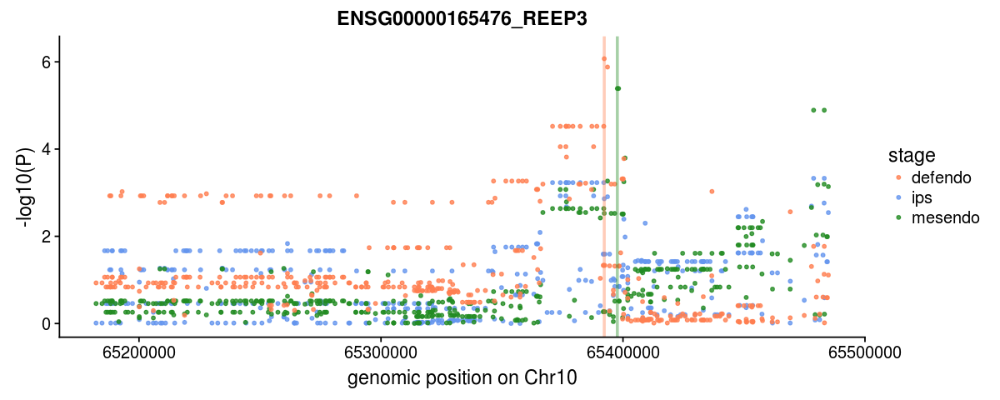

[1] 100


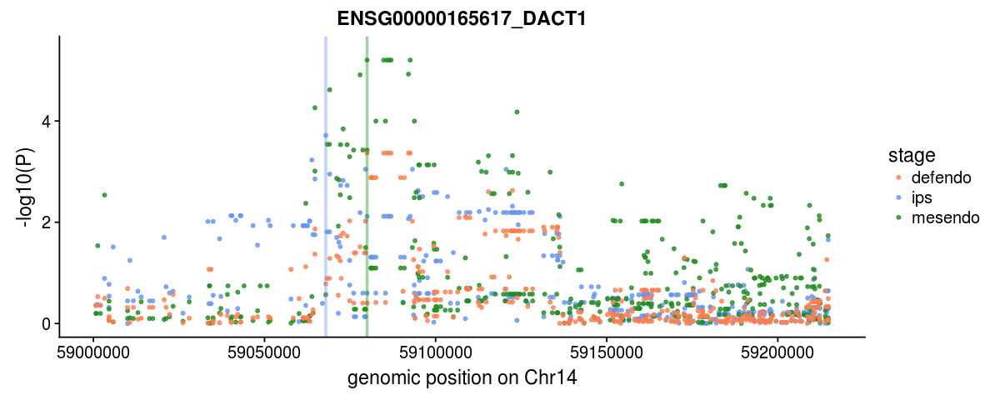

[1] 101


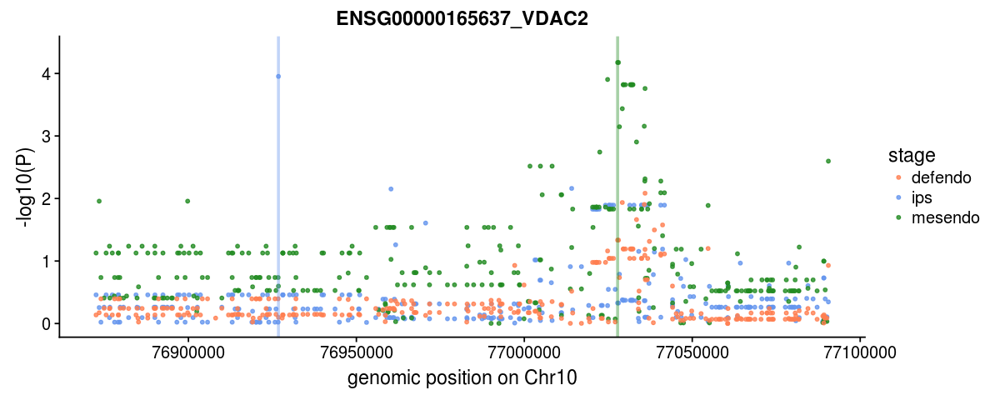

[1] 102


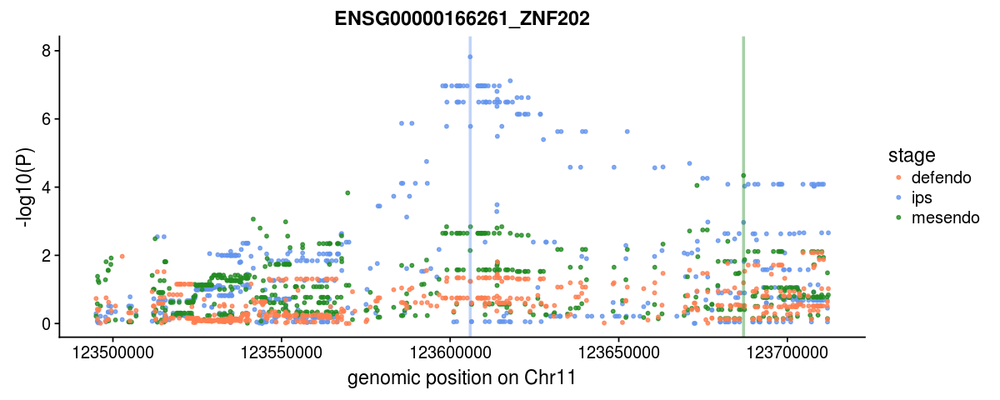

[1] 103


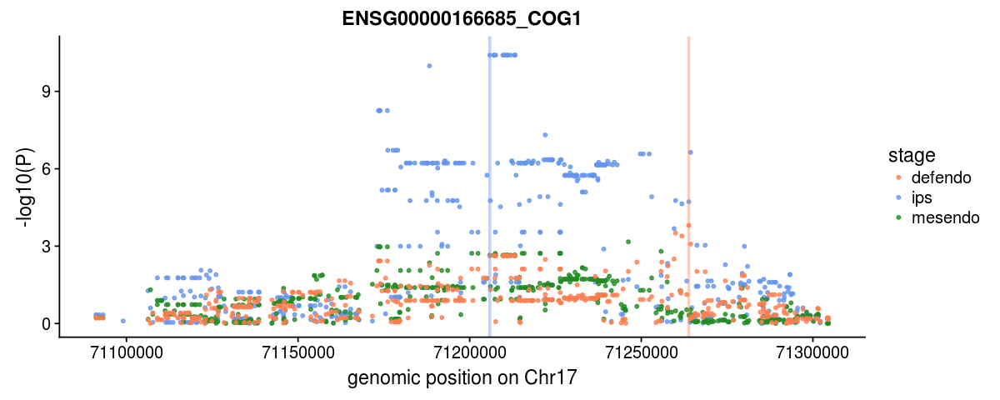

[1] 104


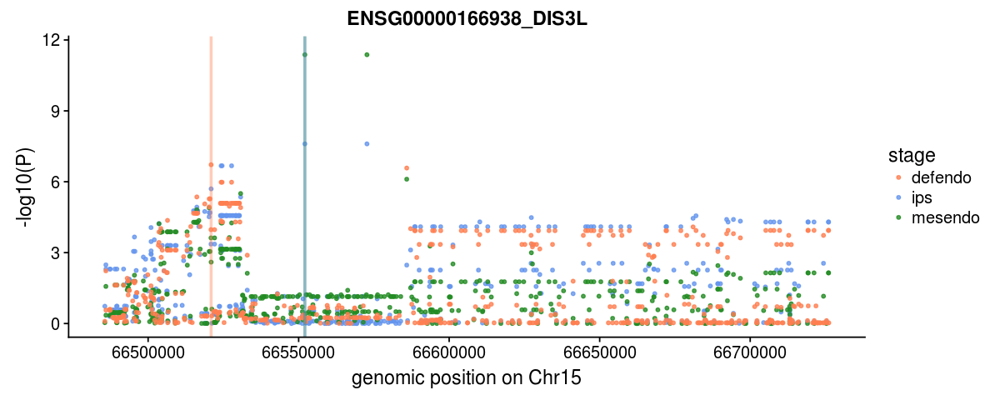

[1] 105


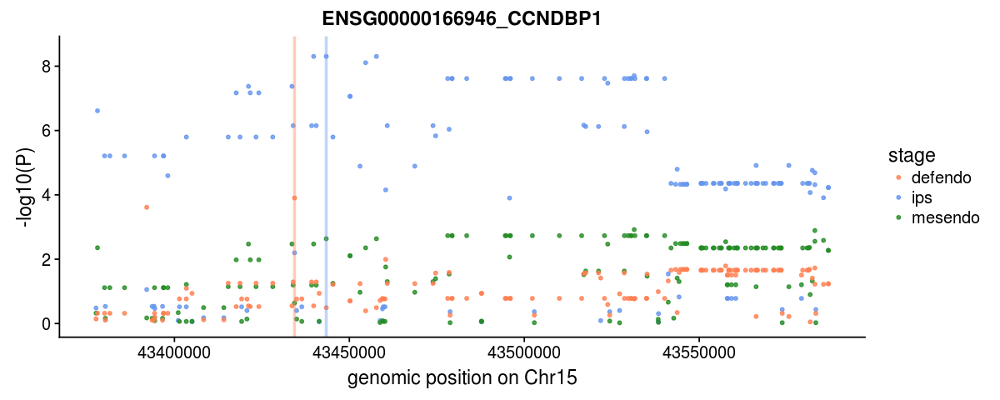

[1] 106


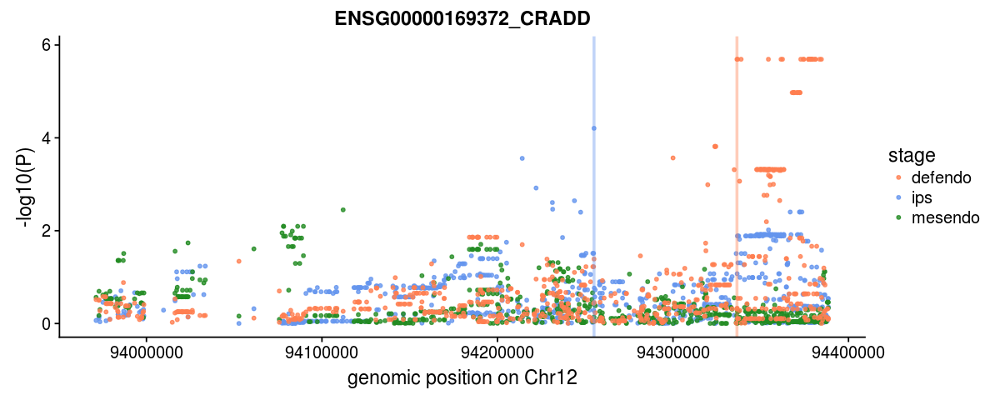

[1] 107


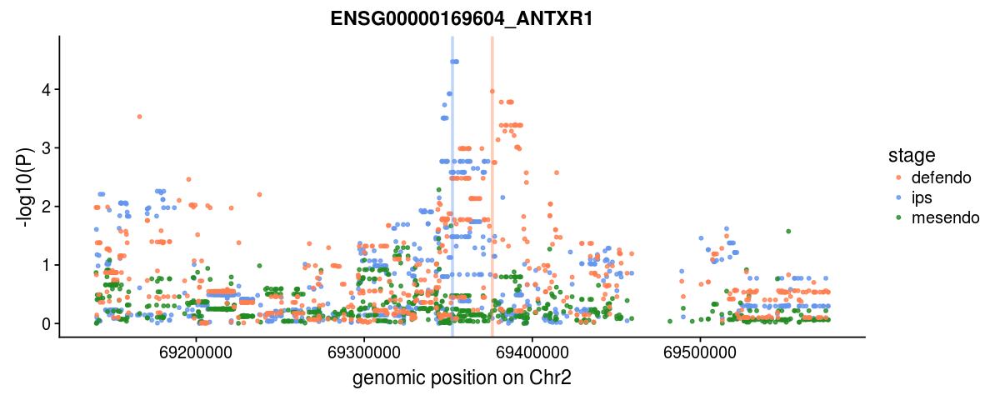

[1] 108


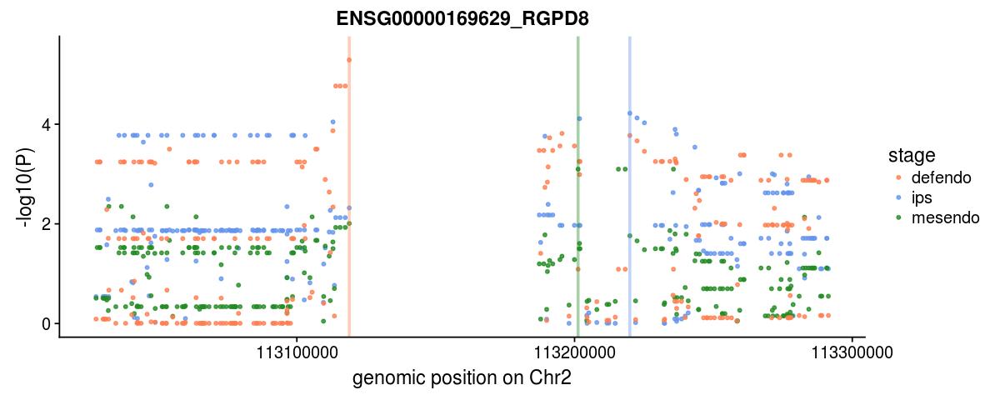

[1] 109


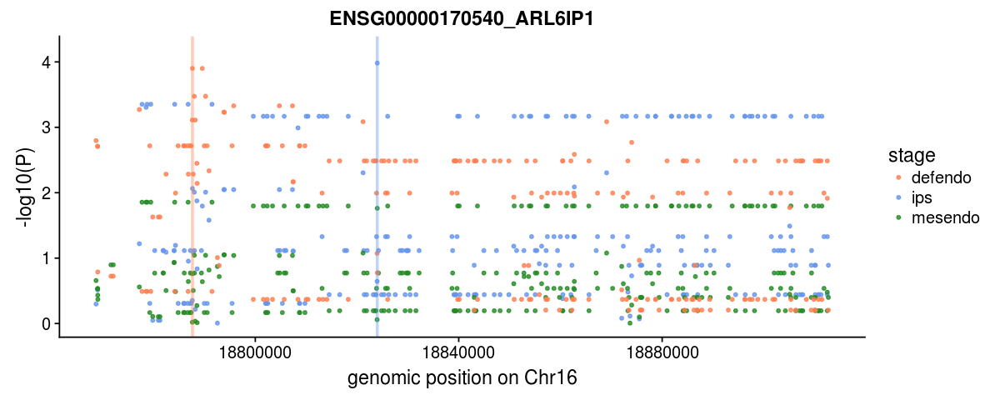

[1] 110


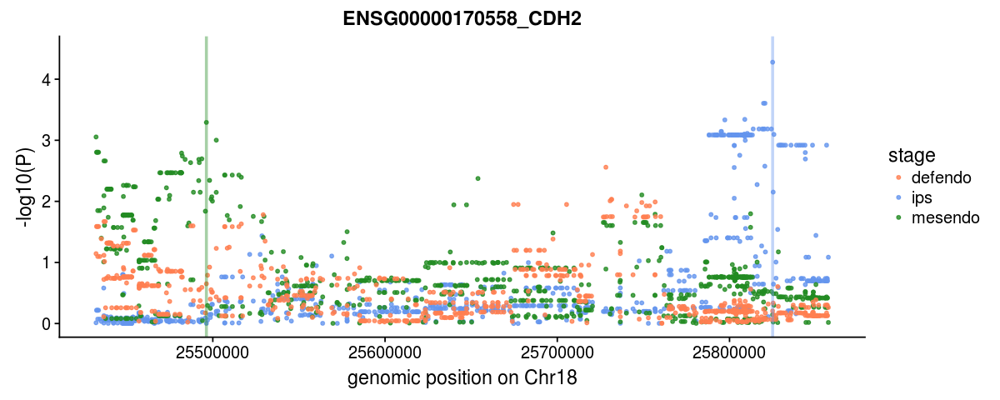

[1] 111


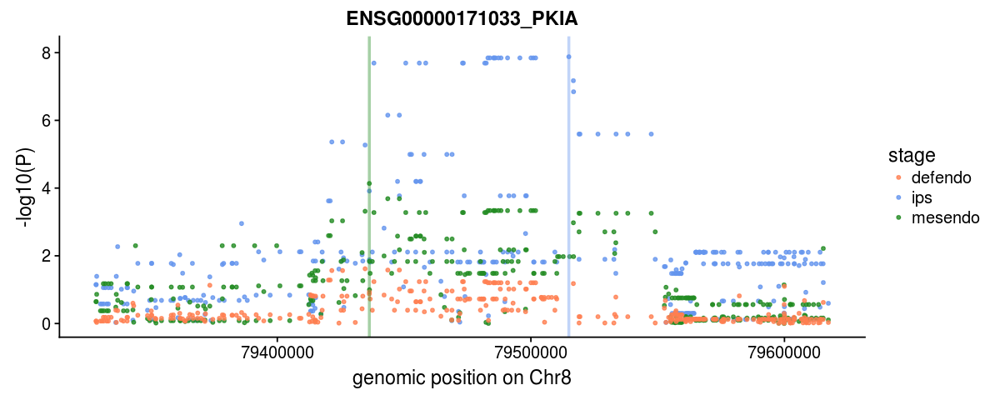

[1] 112


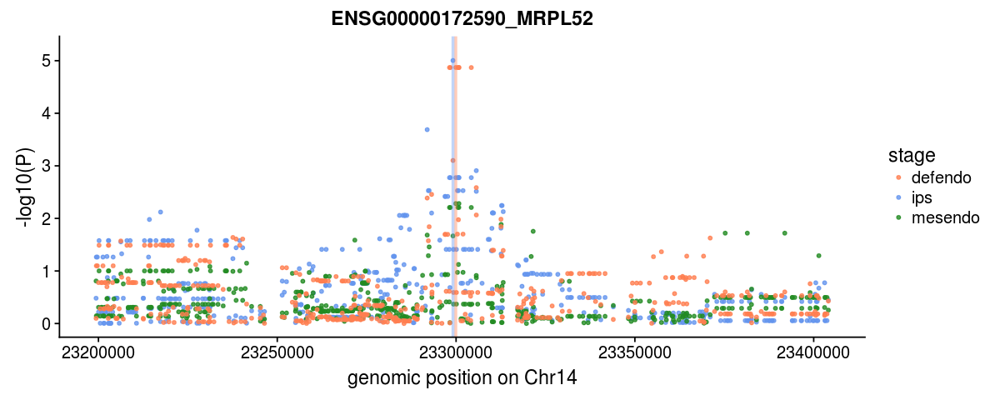

[1] 113


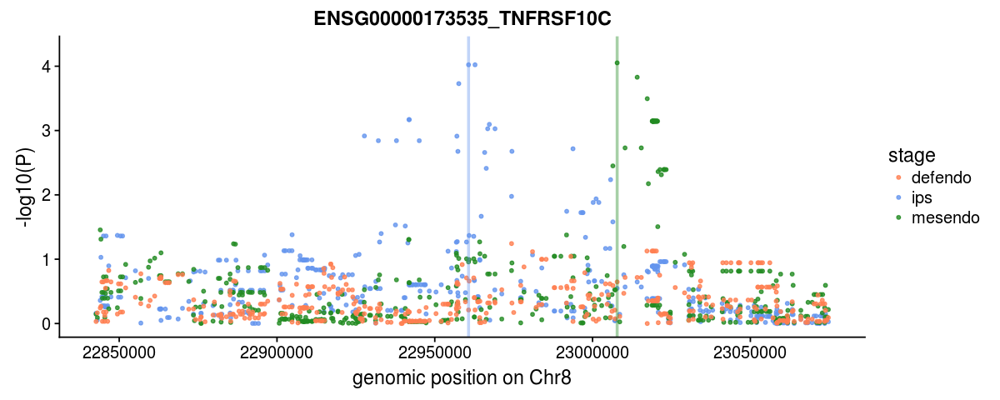

[1] 114


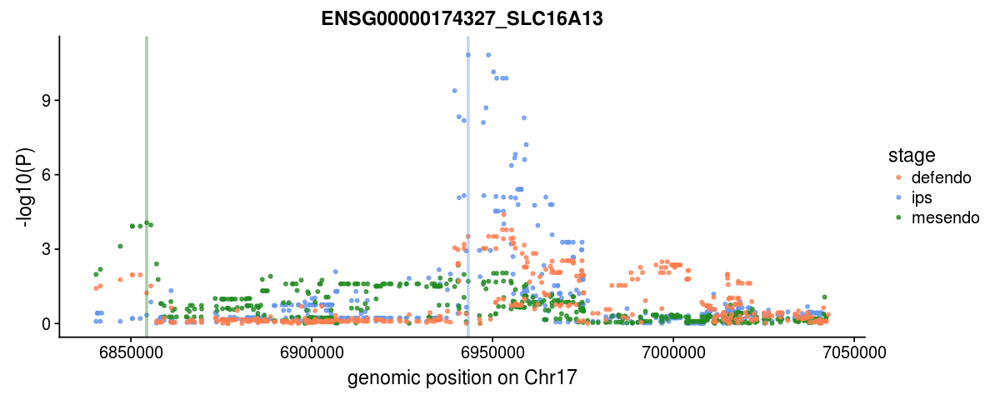

[1] 115


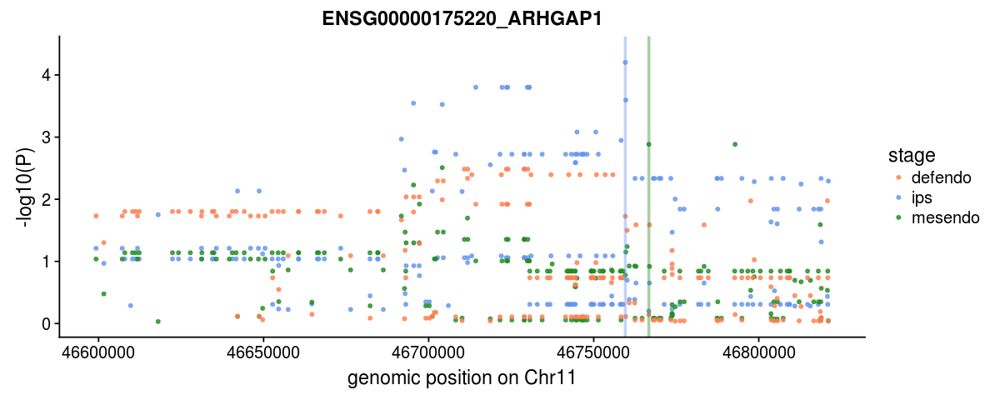

[1] 116


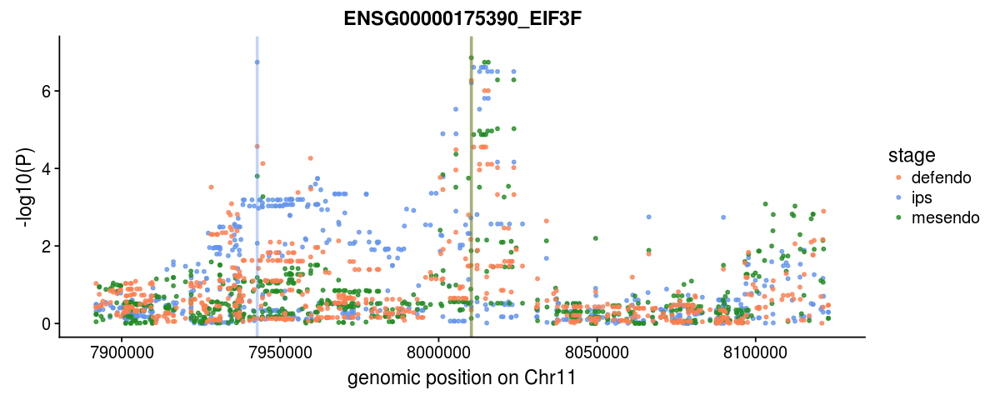

[1] 117


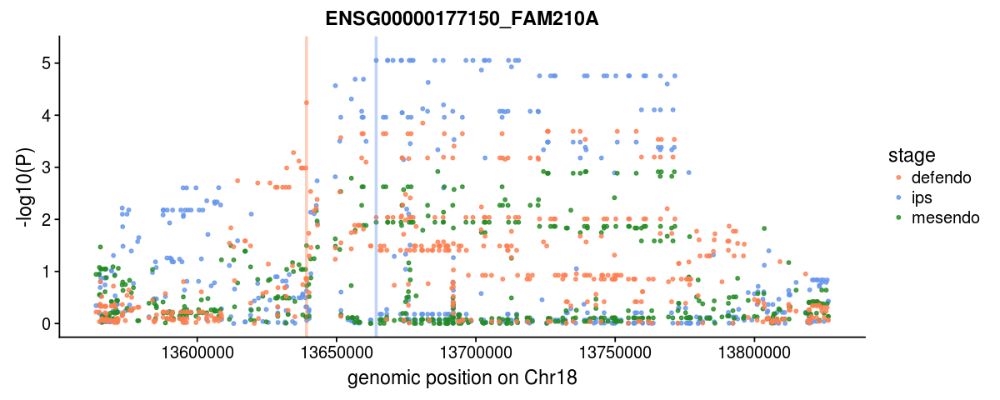

[1] 118


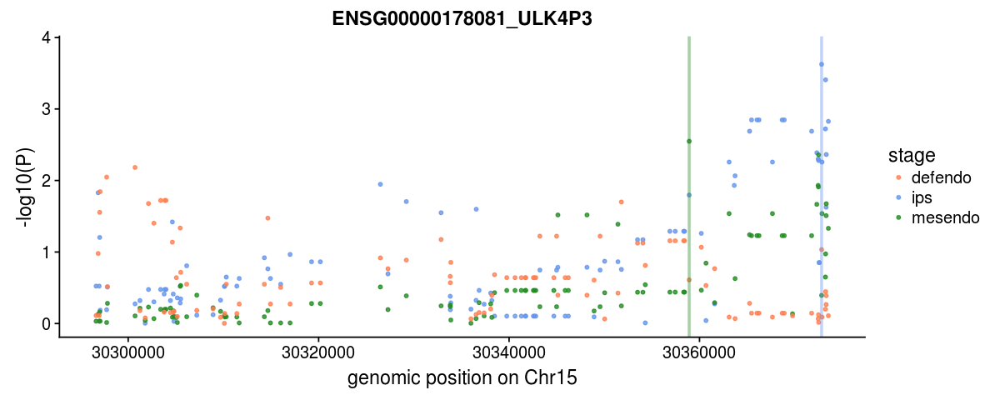

[1] 119


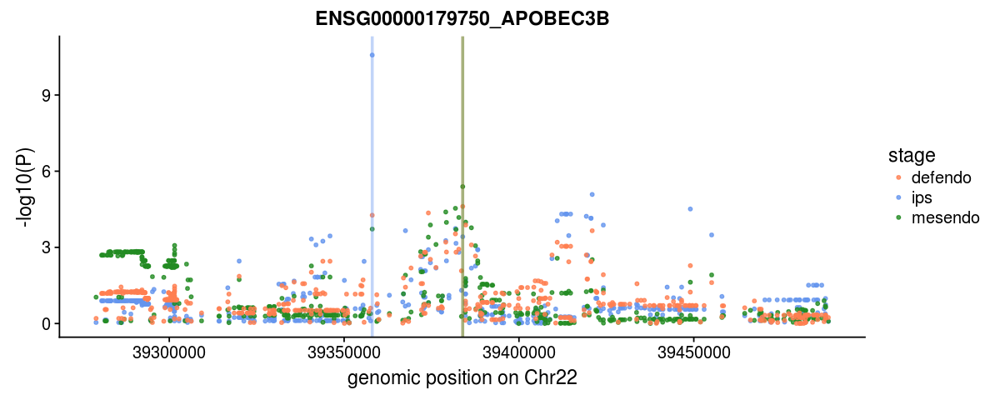

[1] 120


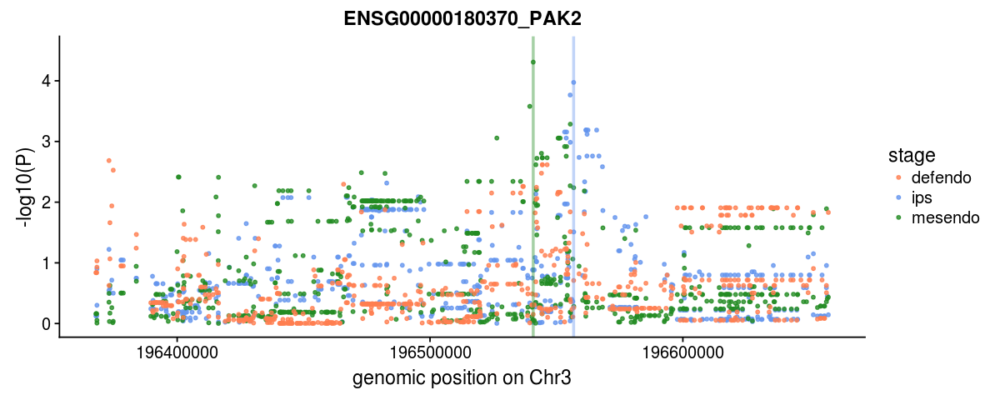

[1] 121


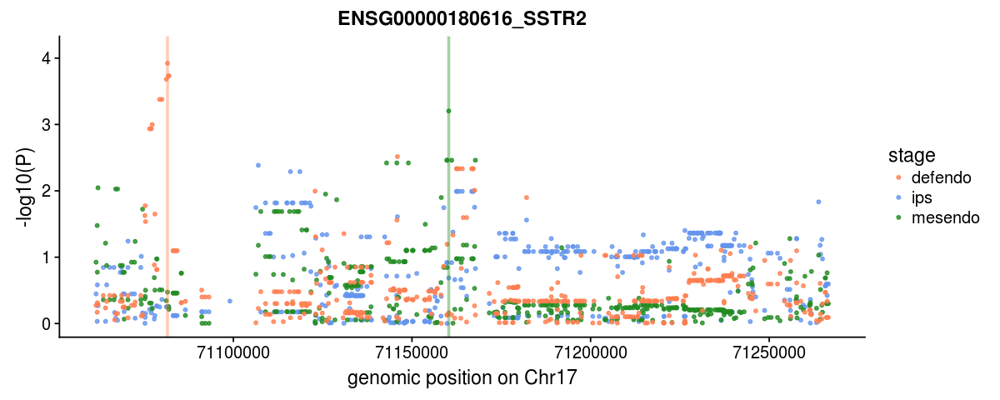

[1] 122


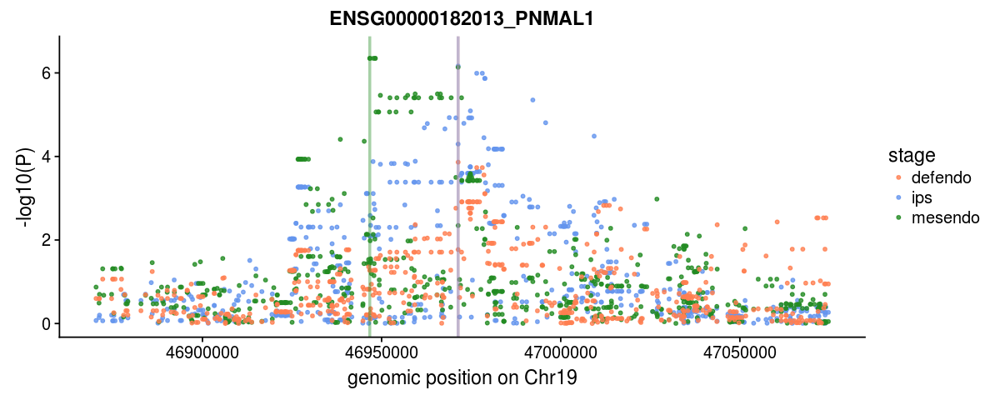

[1] 123


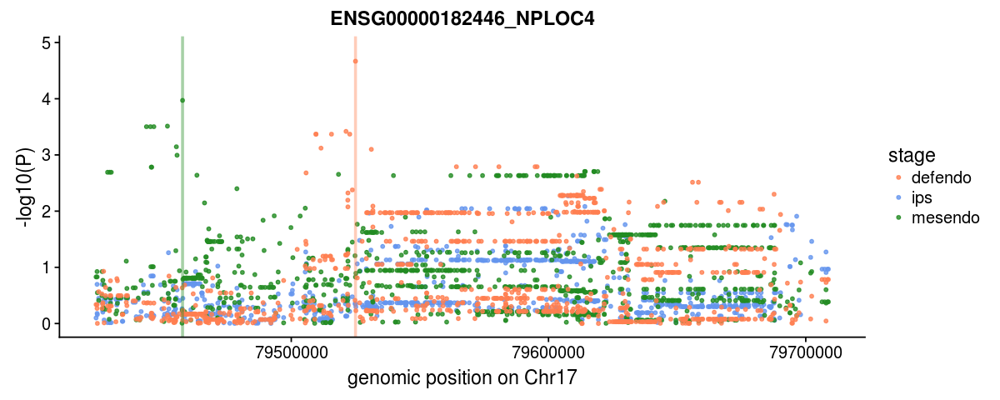

[1] 124


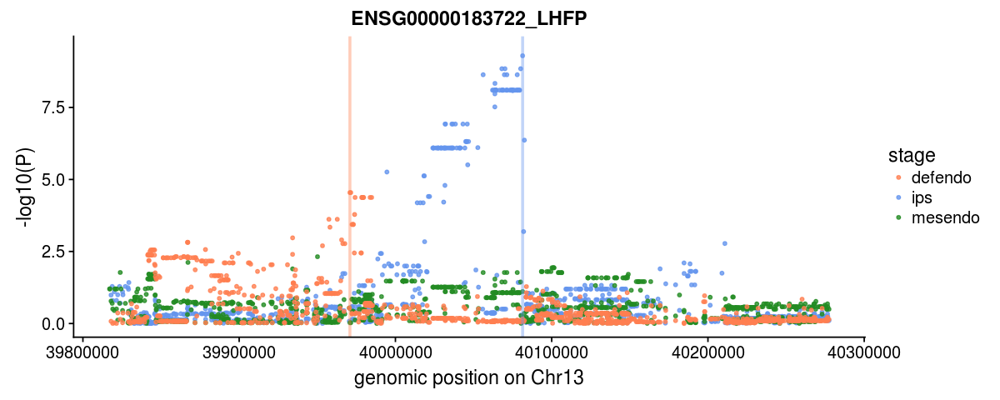

[1] 125


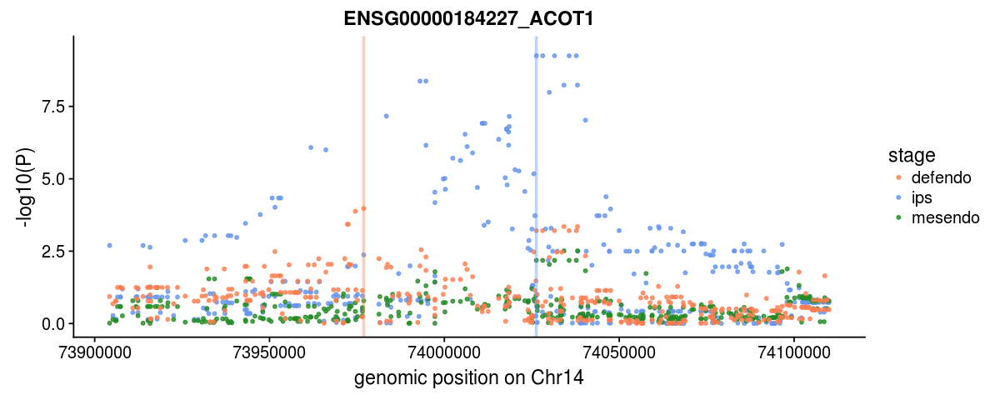

[1] 126


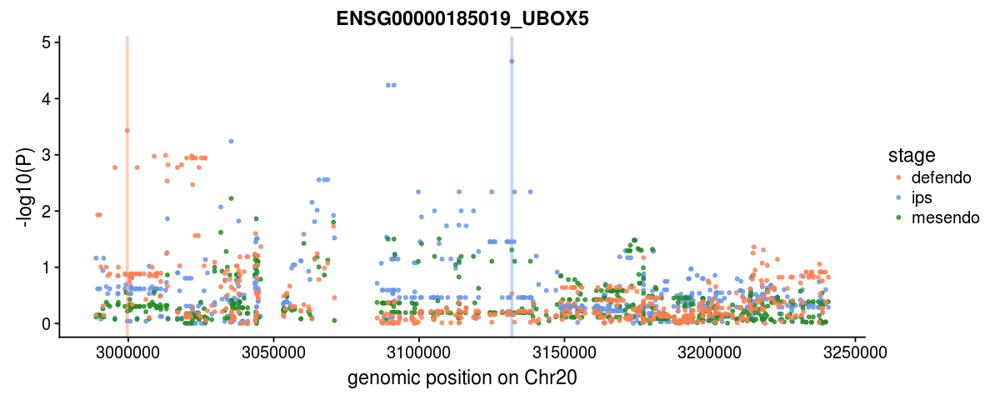

[1] 127


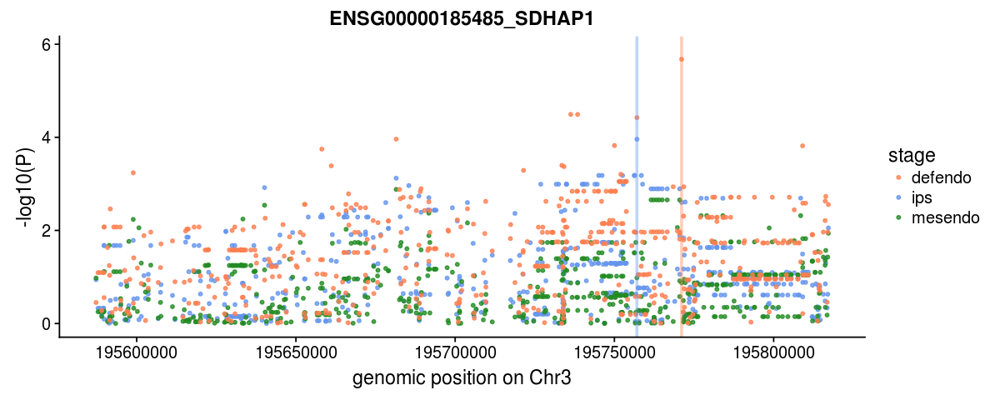

[1] 128


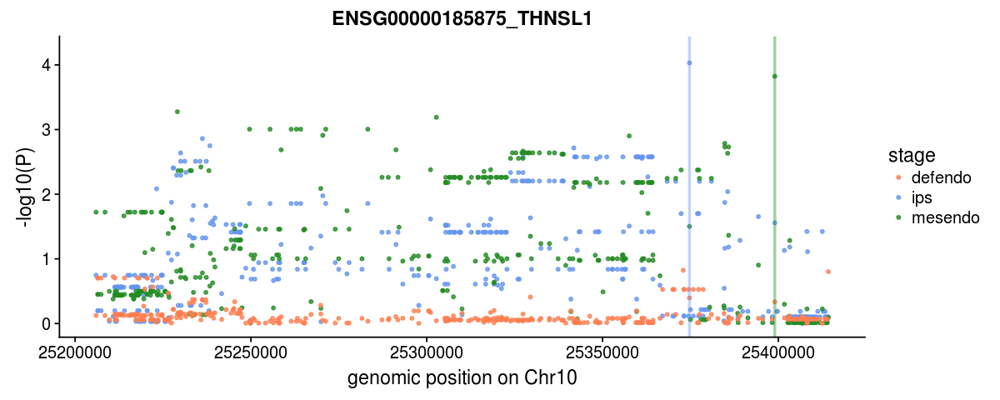

[1] 130


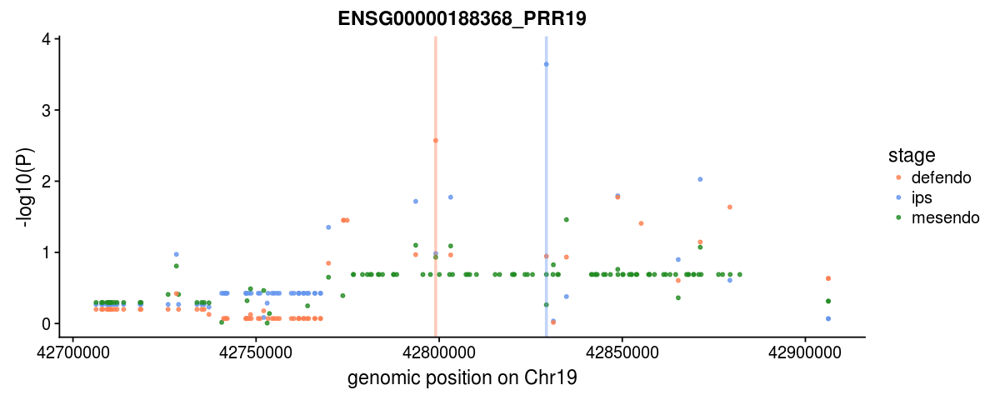

[1] 131


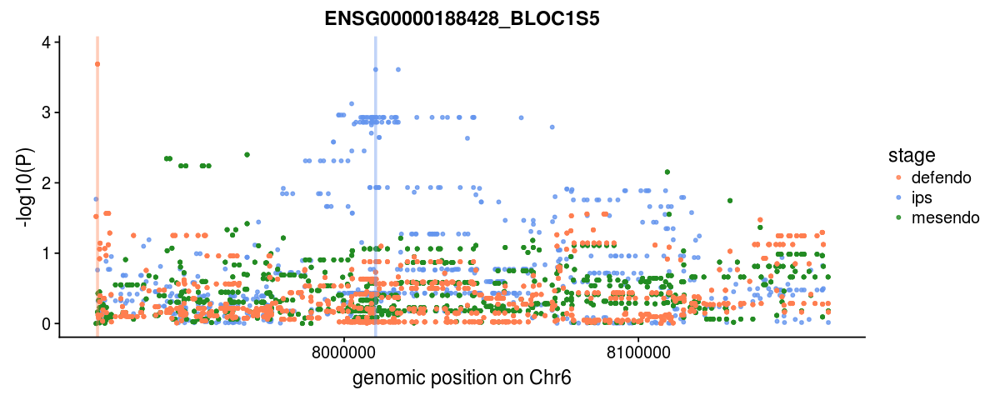

[1] 132


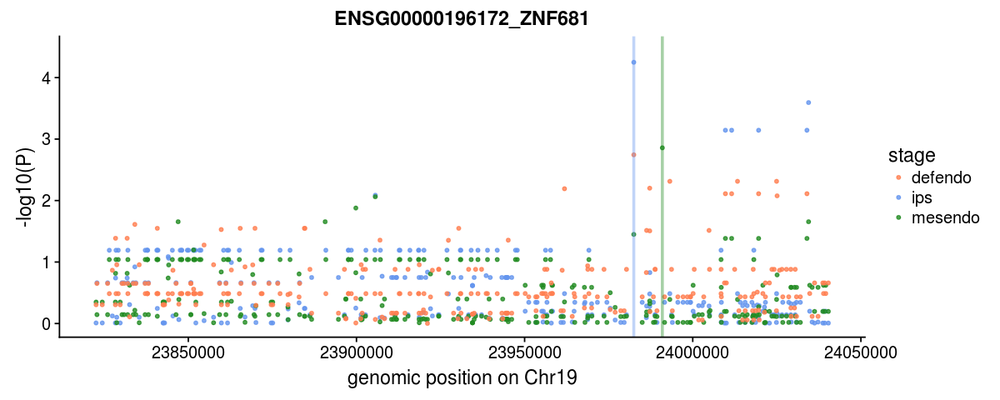

[1] 133


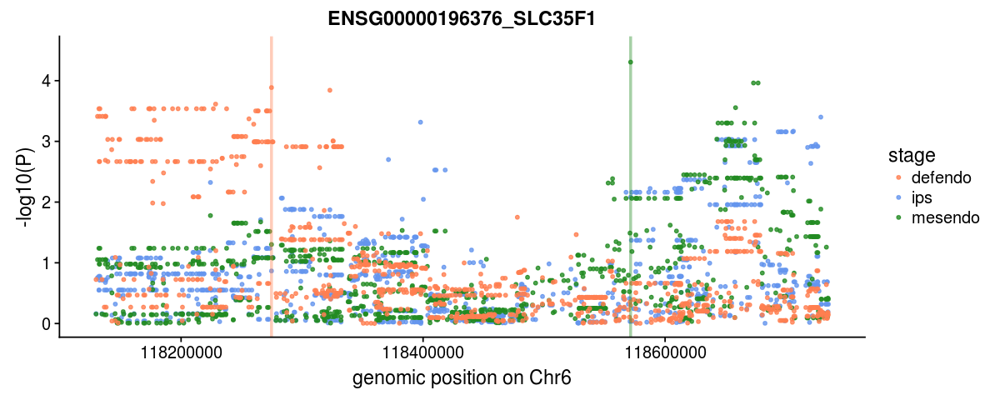

[1] 134


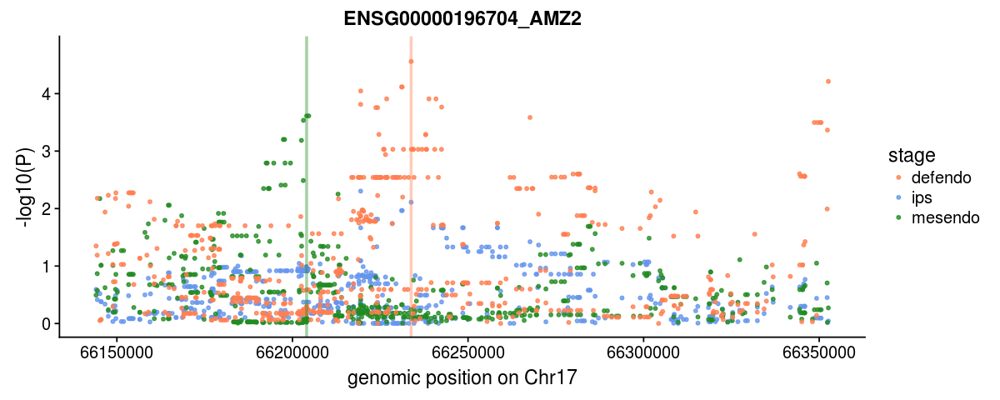

[1] 135


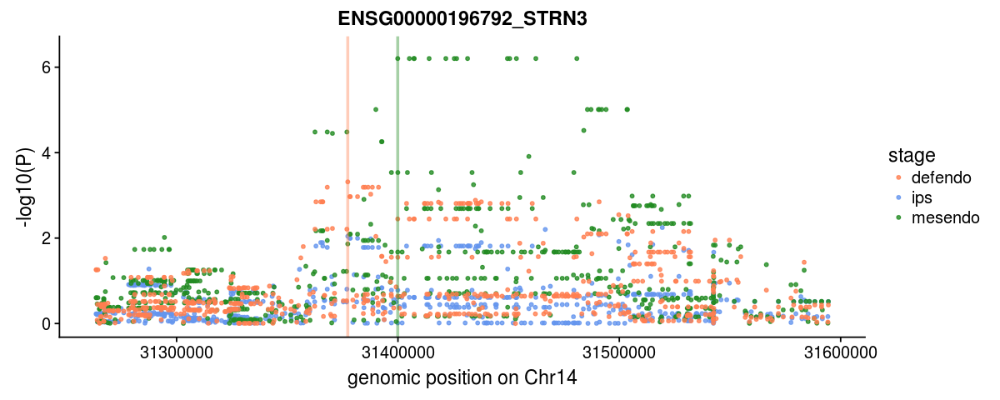

[1] 136


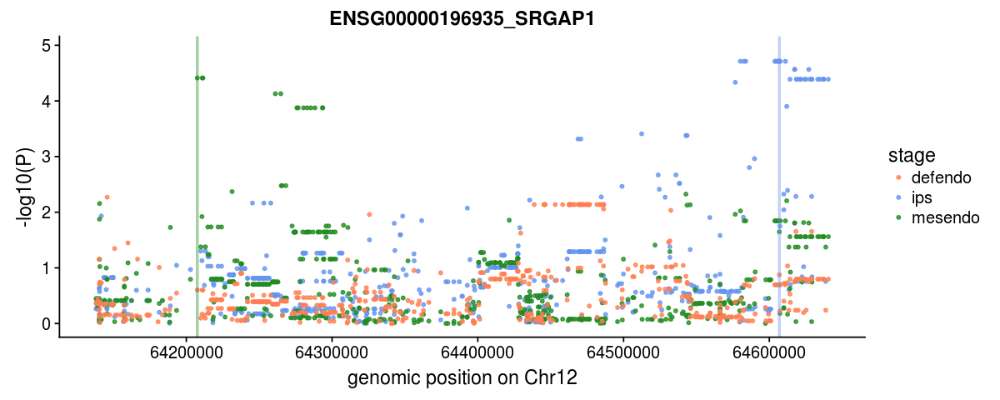

[1] 137


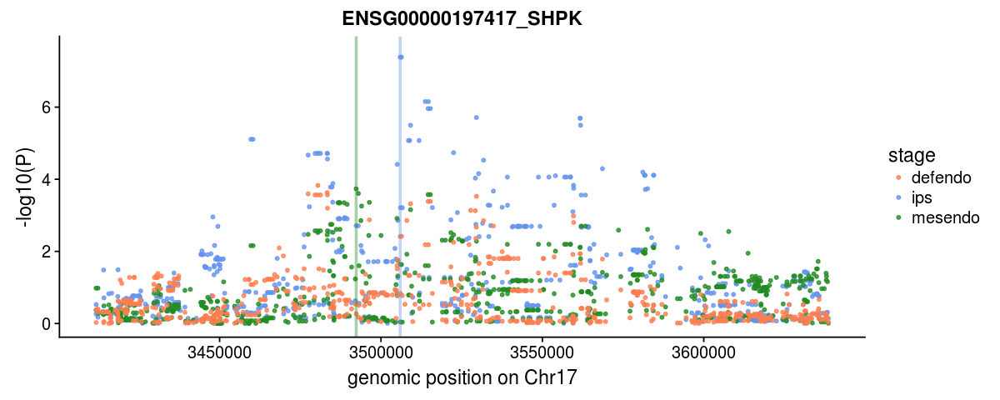

[1] 139


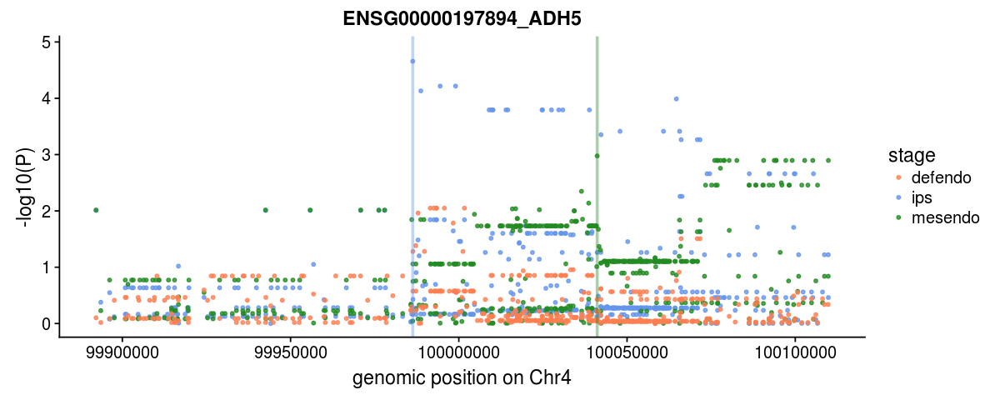

[1] 140


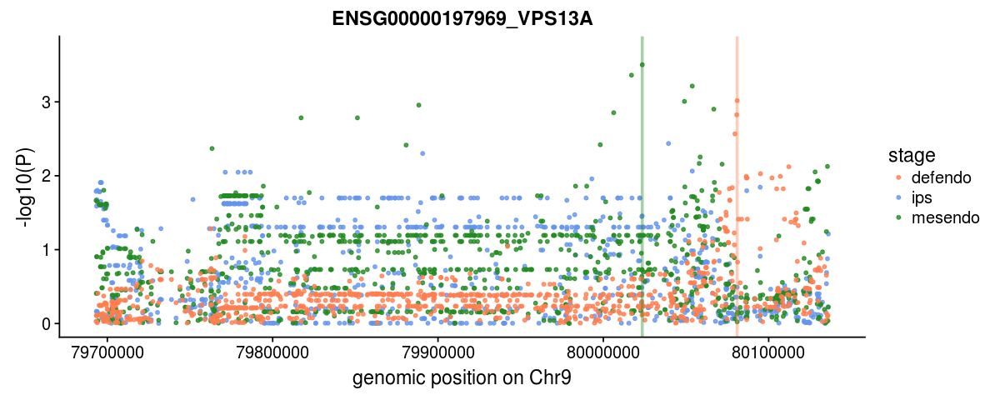

[1] 141


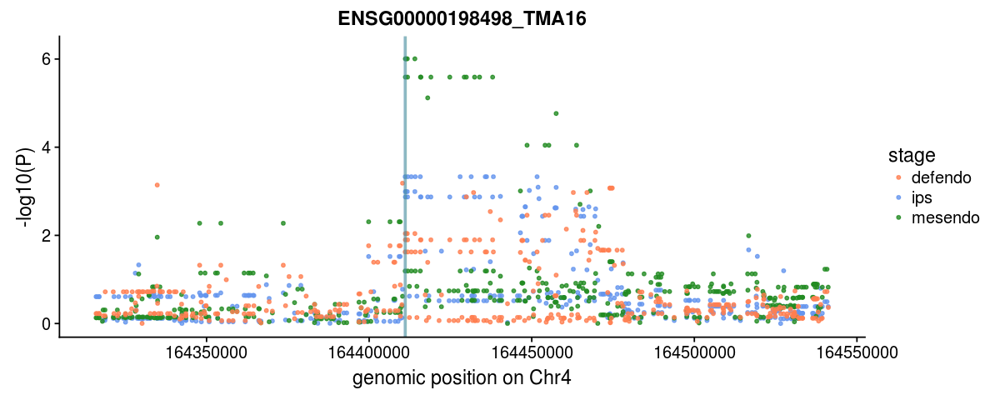

[1] 142


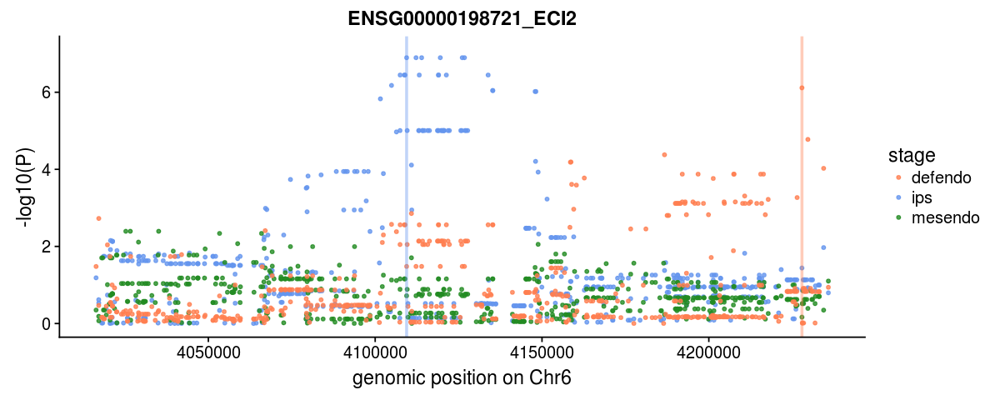

[1] 143


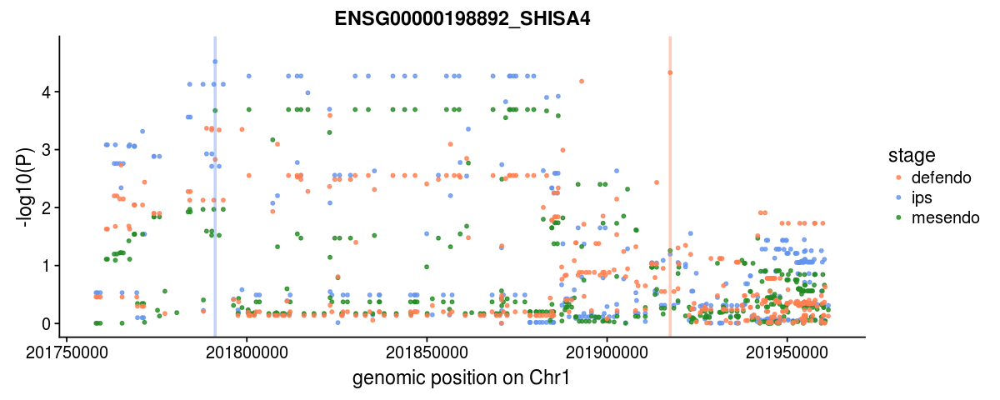

[1] 144


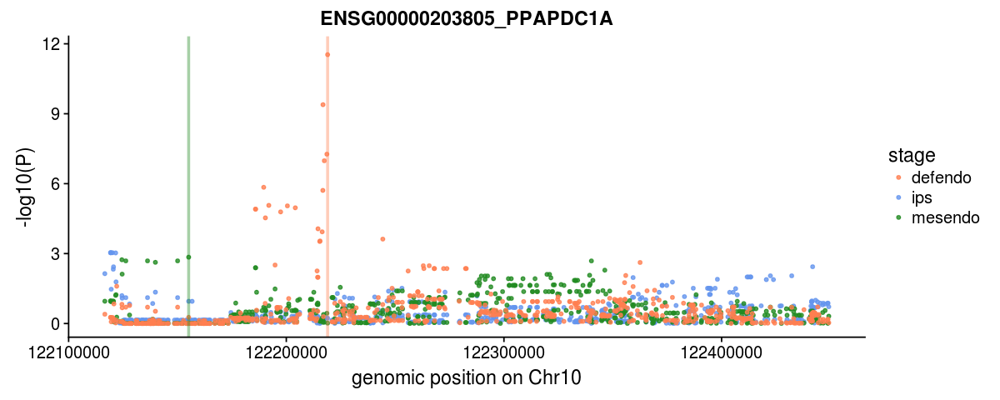

[1] 145


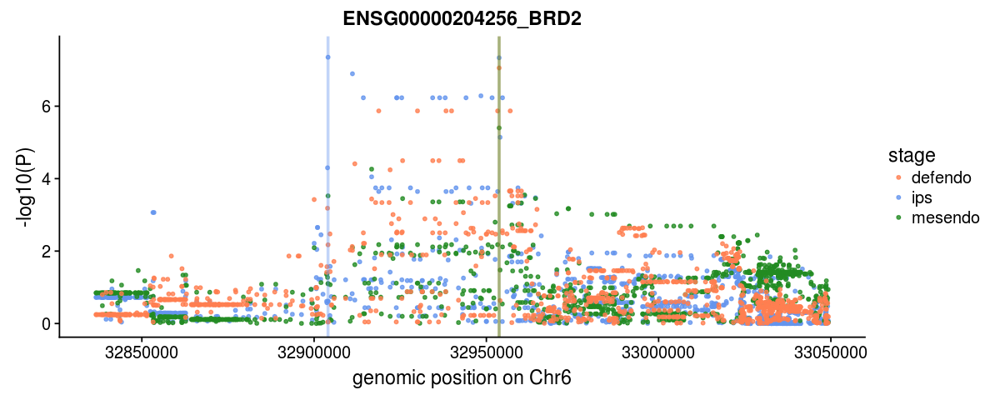

[1] 146


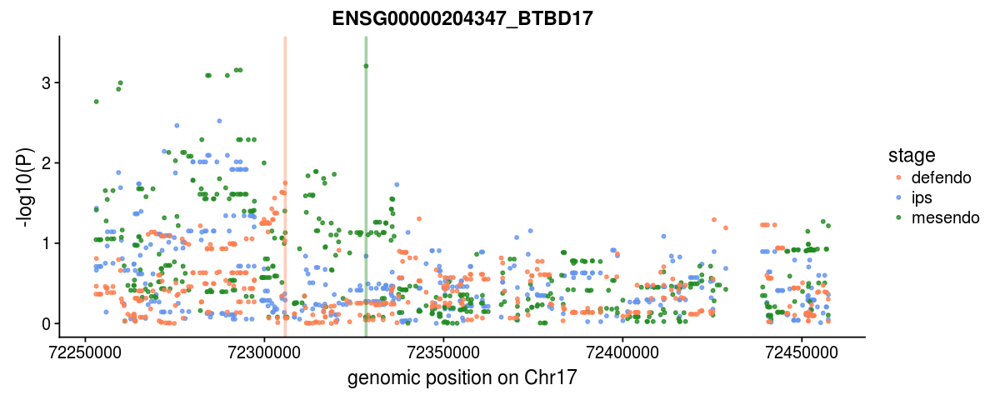

[1] 147


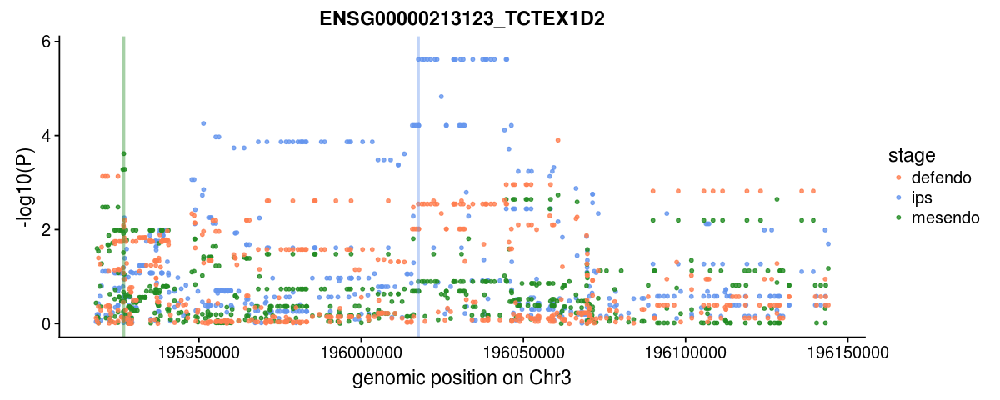

[1] 148


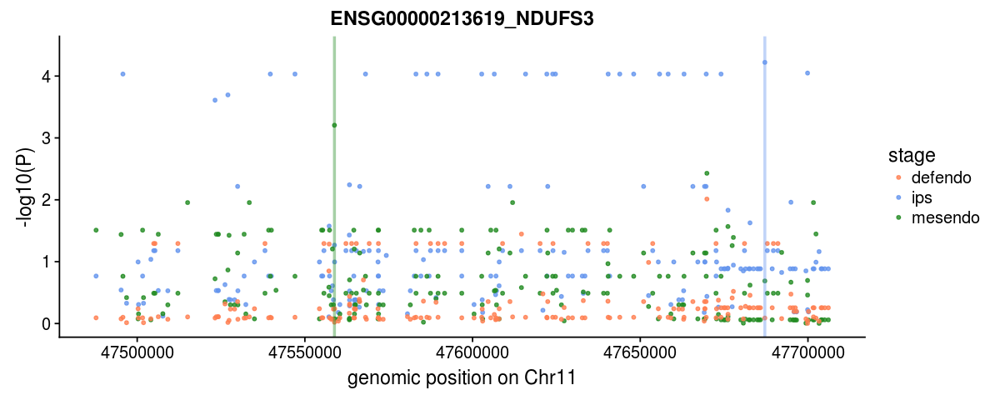

[1] 149


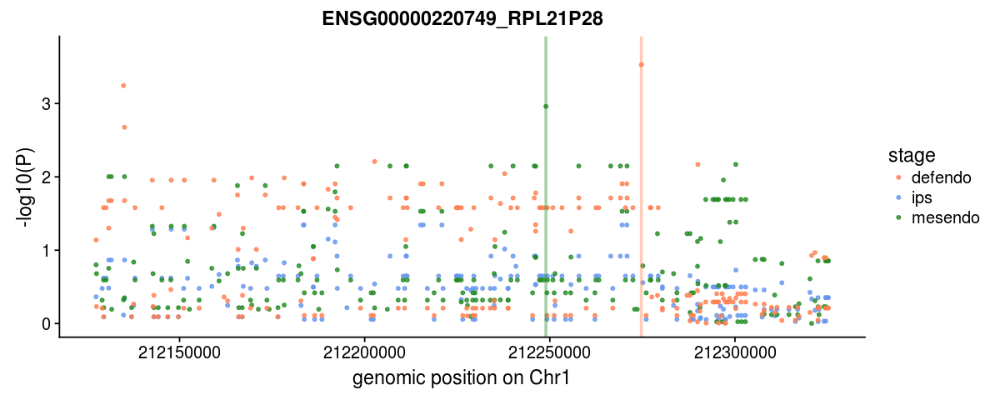

[1] 150


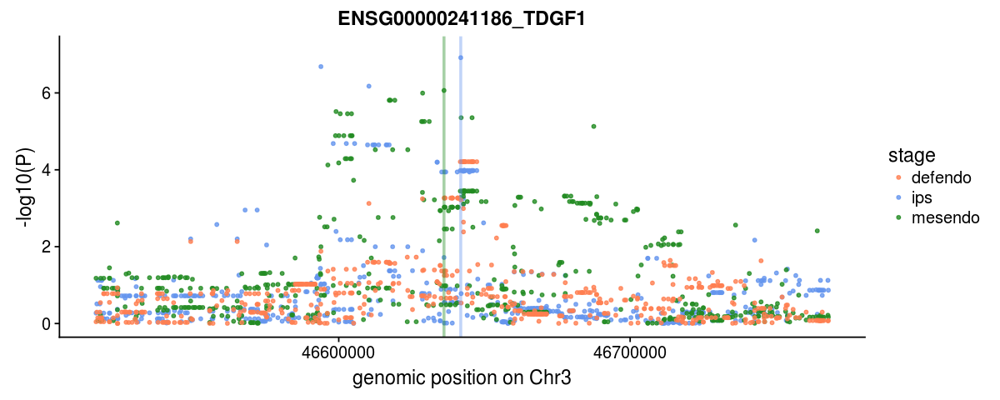

[1] 151


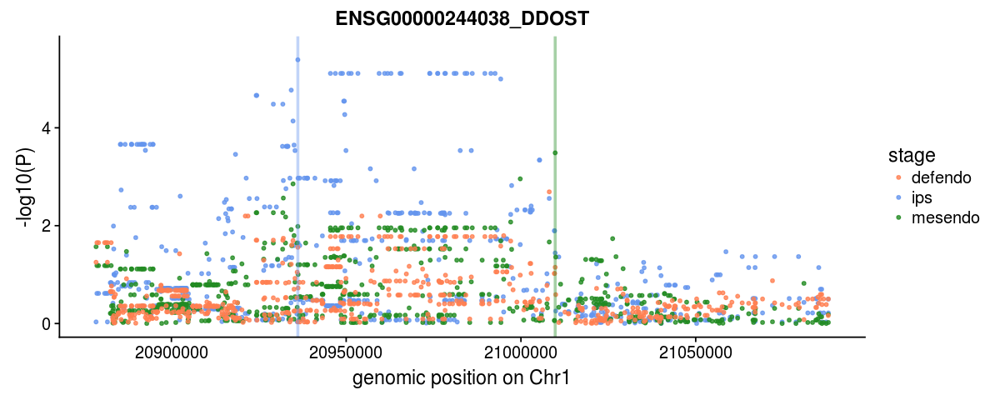

[1] 152


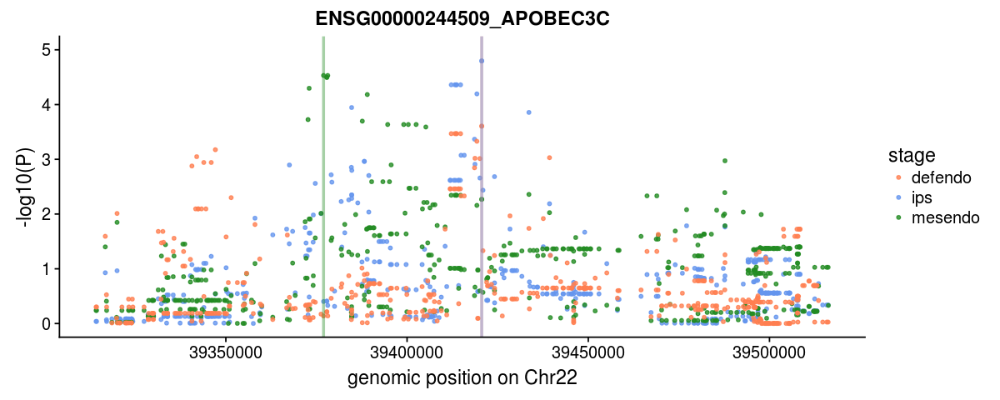

[1] 153


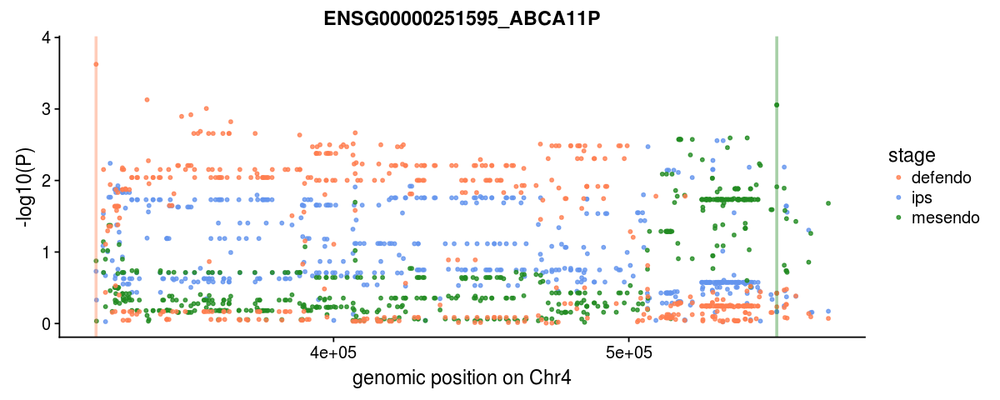

[1] 154


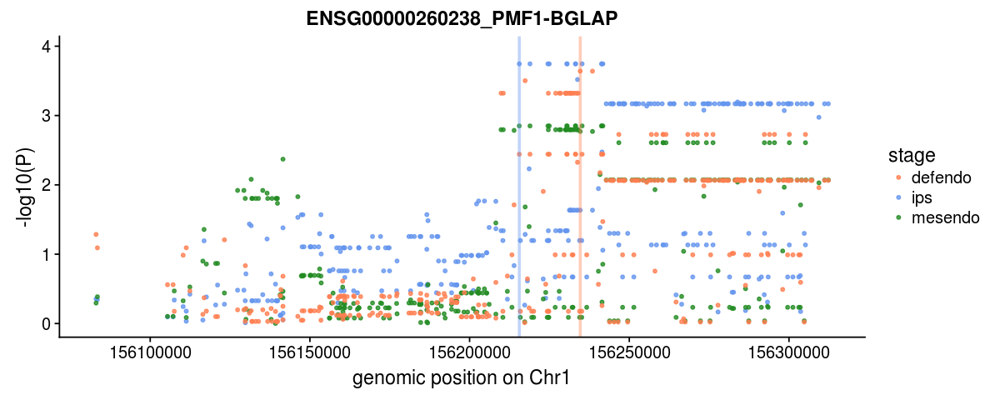

[1] 155


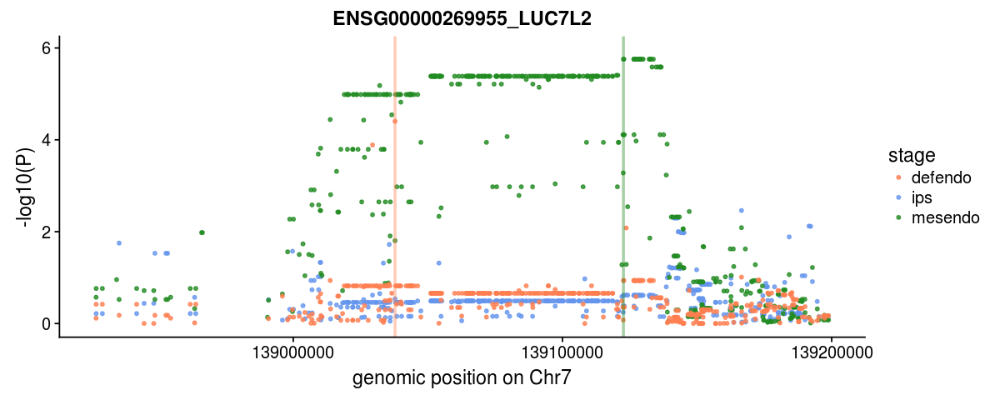

In [118]:
lead_switches = dupl[dupl$lead.switch == "T",]
for (i in 1:length(unique(lead_switches$feature))){
# for (i in 138){
    if (i %in% c(1, 5, 21, 35, 48, 61, 78, 95, 129, 138)){ next }
    gene = unique(lead_switches$feature)[i]
    res = lead_switches[lead_switches$feature == gene,]
    df0 = res.ips[res.ips$feature == gene,]
    df0$stage = "ips"
    # head(df0)
    df1 = res.mes[res.mes$feature == gene,]
    df1$stage = "mesendo"
    # head(df1)
    df2 = res.defendo[res.defendo$feature == gene,]
    df2$stage = "defendo"
    # head(df2)
    df = rbind(df0,df1,df2)
    # head(df)
    m = min(df$p_value)
    p = ggplot(df, aes(x = pos, y = -log10(p_value), colour = stage))
    p = p + geom_point(size = 1, alpha = 0.8)  
    p = p + scale_colour_manual(values = c("coral","cornflowerblue","forestgreen")) 
    p = p + xlab(paste0("genomic position on Chr", df$chrom[1])) + ylab("-log10(P)") 
    p = p + ylim(c(0,-log10(m)+0.2))
    p = p + ggtitle(gene)
    p = p + geom_vline(xintercept = res[res$stage == "defendo","snp_position"], col = "coral", alpha = 0.4, size = 1)
    p = p + geom_vline(xintercept = res[res$stage == "mesendo","snp_position"], col = "forestgreen", alpha = 0.4, size = 1)
    p = p + geom_vline(xintercept = res[res$stage == "ips","snp_position"], col = "cornflowerblue", alpha = 0.4, size = 1)
    options(repr.plot.width = 10, repr.plot.height = 4)
    print(p)
    print (i)
}


In [119]:
eQTL_histones_filename <- "/nfs/leia/research/stegle/dseaton/hipsci/singlecell_endodiff/data/qtl_chipseq_overlaps/all_qtl_results_combined.overlap_w_vallier_histone_marks.tsv"
eQTL_histones <- read.csv(eQTL_histones_filename, sep = "\t")
head(eQTL_histones)

snp_id,Unnamed..0,beta.mean,beta_se,empirical_feature_p_value,p_value.mean,snp_id.1,feature,global_corr_p_value,chrom,⋯,H3K4me3,H3K4me3_h0,H3K4me3_h24,H3K36me3_h48,H3K36me3_h24,H3K36me3_h36,H3K36me3_h72,H3K36me3_h0,H3K36me3_h12,H3K36me3
6_31132414_G_A,24,-1.386281,0.1083733,1.592971e-18,1.823854e-37,6_31132414_G_A,ENSG00000204531_POU5F1,5.264237e-16,6,⋯,False,False,False,True,True,True,True,True,True,True
6_32634922_A_G,117,-1.270786,0.1469673,1.977147e-11,5.299864e-18,6_32634922_A_G,ENSG00000179344_HLA-DQB1,1.340269e-09,6,⋯,False,False,False,False,False,False,False,False,False,False
6_32634922_A_G,1879,-1.375988,0.1478612,8.485500e-15,1.328104e-20,6_32634922_A_G,ENSG00000179344_HLA-DQB1,1.519887e-12,6,⋯,False,False,False,False,False,False,False,False,False,False
6_32634922_A_G,3587,-1.438379,0.1499301,3.298243e-12,8.500689e-22,6_32634922_A_G,ENSG00000179344_HLA-DQB1,5.981274e-10,6,⋯,False,False,False,False,False,False,False,False,False,False
9_136227260_A_G,20,-1.371767,0.1094063,1.461609e-19,4.608624e-36,9_136227260_A_G,ENSG00000148291_SURF2,5.796154e-17,9,⋯,False,False,False,True,True,True,True,True,True,True
9_136227260_A_G,1851,-1.410832,0.1143974,6.363028e-20,6.036677e-35,9_136227260_A_G,ENSG00000148291_SURF2,2.949861e-17,9,⋯,False,False,False,True,True,True,True,True,True,True


In [120]:
gene = "PREX2"
eQTL_histones[grep(gene,eQTL_histones$feature),"stage"]
eQTL_histones[grep(gene,eQTL_histones$feature),][1,][which(eQTL_histones[grep(gene,eQTL_histones$feature),][1,] == "True")]
eQTL_histones[grep(gene,eQTL_histones$feature),][2,][which(eQTL_histones[grep(gene,eQTL_histones$feature),][2,] == "True")]

[1] "ips"     "defendo"

,sign.mean,sign.int,H3K36me3_h48,H3K36me3_h24,H3K36me3_h36,H3K36me3_h0,H3K36me3_h12,H3K36me3
796,True,True,True,True,True,True,True,True


,sign.mean
4743,True


In [121]:
gene = "STEAP1B"
# eQTL_histones[grep(gene,eQTL_histones$feature),"stage"]
eQTL_histones[grep(gene,eQTL_histones$feature),][2,][which(eQTL_histones[grep(gene,eQTL_histones$feature),][2,] == "True")]
eQTL_histones[grep(gene,eQTL_histones$feature),][1,][which(eQTL_histones[grep(gene,eQTL_histones$feature),][1,] == "True")]

,sign.mean,H3K4me1_h0,H3K4me1_h36,H3K4me1,H3K4me1_h48
3610,True,True,True,True,True


,sign.mean,stage_specific,sign.int,H3K4me1_h0,H3K4me1_h36,H3K4me1_h24,H3K4me1,H3K4me1_h12,H3K4me1_h48,H3K4me1_h72,H3K36me3_h48,H3K36me3_h24,H3K36me3_h36,H3K36me3_h0,H3K36me3_h12,H3K36me3
175,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True


In [122]:
gene = "CPZ"
eQTL_histones[grep(gene,eQTL_histones$feature),"stage"]
eQTL_histones[grep(gene,eQTL_histones$feature),][1,][which(eQTL_histones[grep(gene,eQTL_histones$feature),][1,] == "True")]
eQTL_histones[grep(gene,eQTL_histones$feature),][2,][which(eQTL_histones[grep(gene,eQTL_histones$feature),][2,] == "True")]

[1] "ips"     "defendo"

,sign.mean,sign.int,H3K4me1_h0,H3K4me1_h36,H3K4me1_h24,H3K4me1,H3K4me1_h12,H3K4me1_h48,H3K36me3_h24,H3K36me3_h72,H3K36me3_h0,H3K36me3
1414,True,True,True,True,True,True,True,True,True,True,True,True


,sign.mean,H3K4me1_h0,H3K4me1_h36,H3K4me1_h24,H3K4me1,H3K4me1_h12,H3K4me1_h48,H3K4me1_h72
4615,True,True,True,True,True,True,True,True


In [123]:
gene = "CDKL1"
eQTL_histones[grep(gene,eQTL_histones$feature),"stage"]
eQTL_histones[grep(gene,eQTL_histones$feature),][1,][which(eQTL_histones[grep(gene,eQTL_histones$feature),][1,] == "True")]
eQTL_histones[grep(gene,eQTL_histones$feature),][2,][which(eQTL_histones[grep(gene,eQTL_histones$feature),][2,] == "True")]

[1] "ips"     "mesendo"

,sign.mean,sign.int,H3K4me1_h0,H3K4me1,H3K4me1_h12
1501,True,True,True,True,True


,sign.mean,H3K36me3_h48,H3K36me3_h24,H3K36me3_h36,H3K36me3_h72,H3K36me3_h0,H3K36me3_h12,H3K36me3
4204,True,True,True,True,True,True,True,True


In [124]:
gene = "FBLN1"
eQTL_histones[grep(gene,eQTL_histones$feature),"stage"]
eQTL_histones[grep(gene,eQTL_histones$feature),][2,][which(eQTL_histones[grep(gene,eQTL_histones$feature),][2,] == "True")]
eQTL_histones[grep(gene,eQTL_histones$feature),][1,][which(eQTL_histones[grep(gene,eQTL_histones$feature),][1,] == "True")]

[1] "defendo" "ips"

,sign.mean,H3K36me3_h48,H3K36me3_h24,H3K36me3_h36,H3K36me3_h72,H3K36me3_h0,H3K36me3_h12,H3K36me3
3692,True,True,True,True,True,True,True,True


,sign.mean,sign.int,H3K27ac_h12,H3K27ac_h0,H3K27ac_h48,H3K27ac_h72,H3K27ac,H3K27ac_h24,H3K27ac_h36,H3K4me1_h24,H3K4me1,H3K4me1_h12,H3K4me3_h36,H3K4me3_h72,H3K4me3_h48,H3K4me3_h12,H3K4me3,H3K4me3_h0,H3K4me3_h24
59,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True


In [125]:
gene = "MGRN1"
eQTL_histones[grep(gene,eQTL_histones$feature),"stage"]
eQTL_histones[grep(gene,eQTL_histones$feature),][2,][which(eQTL_histones[grep(gene,eQTL_histones$feature),][2,] == "True")]
eQTL_histones[grep(gene,eQTL_histones$feature),][1,][which(eQTL_histones[grep(gene,eQTL_histones$feature),][1,] == "True")]

[1] "defendo" "mesendo"

,sign.mean,H3K4me1_h0,H3K4me1_h36,H3K4me1,H3K4me1_h12,H3K4me1_h48,H3K4me3_h72,H3K4me3,H3K4me3_h0,H3K4me3_h24
4360,True,True,True,True,True,True,True,True,True,True


,sign.mean,H3K27ac_h12,H3K27ac_h0,H3K27ac_h48,H3K27ac_h72,H3K27ac,H3K27ac_h24,H3K27ac_h36,H3K4me1_h0,H3K4me1_h36,H3K4me1_h24,H3K4me1,H3K4me1_h12,H3K4me1_h48,H3K4me1_h72
2513,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True


In [126]:
col_day0 = "#344d90"
col_day1 = "#5cc5ef"
col_day2 = "#ffb745"
col_day3 = "#e7552c"

[1] "ENSG00000046889_PREX2"

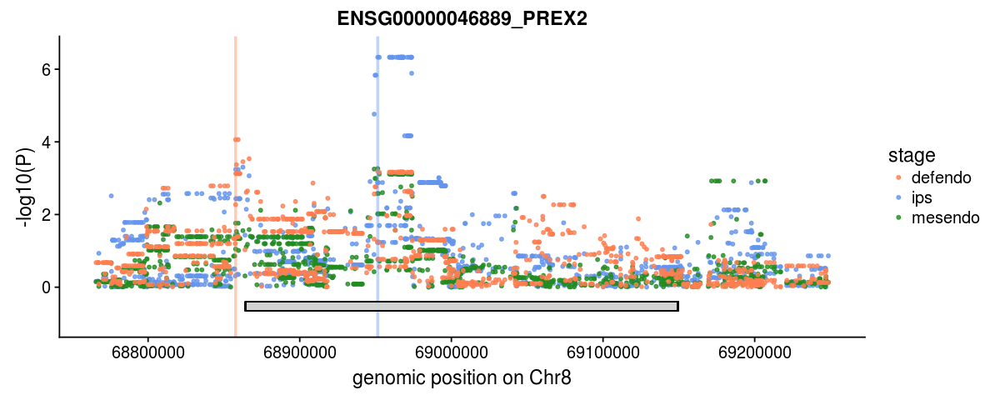

In [26]:
lead_switches = dupl[dupl$lead.switch == "T",]
i = 6
gene = unique(lead_switches$feature)[i]
gene
gene_start = 68864353
gene_end = 69149265
res = lead_switches[lead_switches$feature == gene,]
df0 = res.ips[res.ips$feature == gene,]
df0$stage = "ips"
df1 = res.mes[res.mes$feature == gene,]
df1$stage = "mesendo"
df2 = res.defendo[res.defendo$feature == gene,]
df2$stage = "defendo"
df = rbind(df0,df1,df2)
m = min(df$p_value)
p = ggplot(df, aes(x = pos, y = -log10(p_value), colour = stage))
p = p + geom_point(size = 1, alpha = 0.8)  
p = p + scale_colour_manual(values = c("coral","cornflowerblue","forestgreen")) 
p = p + xlab(paste0("genomic position on Chr", df$chrom[1])) + ylab("-log10(P)") 
p = p + ylim(c(-1,-log10(m)+0.2))
p = p + ggtitle(gene)
p = p + geom_vline(xintercept = res[res$stage == "defendo","snp_position"], col = "coral", alpha = 0.4, size = 1)
p = p + geom_vline(xintercept = res[res$stage == "mesendo","snp_position"], col = "forestgreen", alpha = 0.4, size = 1)
p = p + geom_vline(xintercept = res[res$stage == "ips","snp_position"], col = "cornflowerblue", alpha = 0.4, size = 1)
p = p + geom_rect(mapping = aes(xmin = gene_start, xmax = gene_end, ymin = -0.65, ymax = -0.4), 
                  color = "black", alpha = 0.1, fill = "lightgrey")
options(repr.plot.width = 10, repr.plot.height = 4)
p

[1] "ENSG00000105889_STEAP1B"

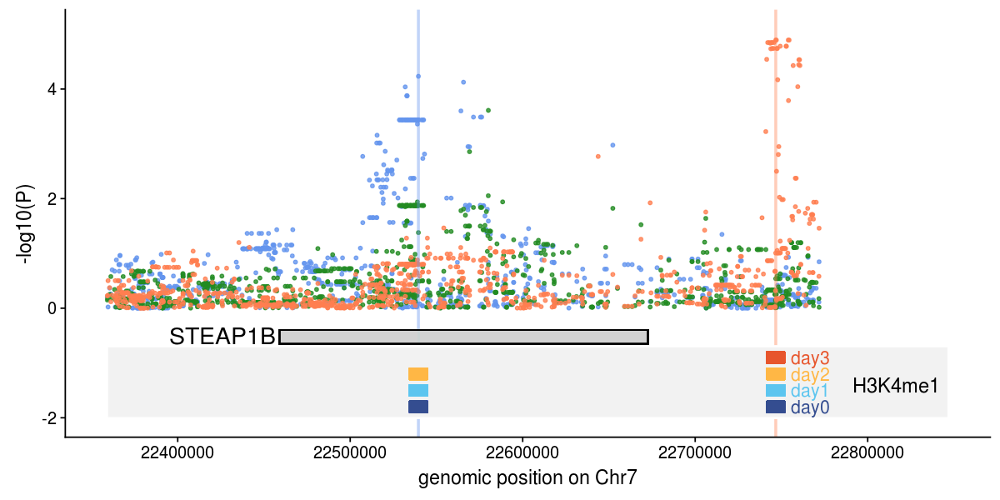

In [133]:
lead_switches = dupl[dupl$lead.switch == "T",]
i = 28
gene = unique(lead_switches$feature)[i]
gene
gene_start = 22459063
gene_end = 22672544
res = lead_switches[lead_switches$feature == gene,]
df0 = res.ips[res.ips$feature == gene,]
df0$stage = "ips"
df1 = res.mes[res.mes$feature == gene,]
df1$stage = "mesendo"
df2 = res.defendo[res.defendo$feature == gene,]
df2$stage = "defendo"
df = rbind(df0,df1,df2)
m = min(df$p_value)
p = ggplot(df, aes(x = pos, y = -log10(p_value), colour = stage))
p = p + geom_point(size = 1, alpha = 0.8)  
p = p + scale_colour_manual(values = c("coral","cornflowerblue","forestgreen")) 
p = p + xlab(paste0("genomic position on Chr", df$chrom[1])) + ylab("-log10(P)") 
p = p + ylim(c(-2,-log10(m)+0.2))
# p = p + ggtitle(gene)
p = p + geom_vline(xintercept = res[res$stage == "defendo","snp_position"], col = "coral", alpha = 0.4, size = 1)
p = p + geom_vline(xintercept = res[res$stage == "mesendo","snp_position"], col = "forestgreen", alpha = 0.4, size = 1)
p = p + geom_vline(xintercept = res[res$stage == "ips","snp_position"], col = "cornflowerblue", alpha = 0.4, size = 1)
p = p + geom_rect(mapping = aes(xmin = gene_start, xmax = gene_end, ymin = -0.65, ymax = -0.4), 
                  color = "black", alpha = 0.1, fill = "lightgrey")
p = p + geom_rect(mapping = aes(xmin = min(df$pos), xmax = res[res$stage == "defendo","snp_position"]+100000, ymin = -2, ymax = -0.7), 
                  color = "white", fill = "gray95")
p = p + geom_rect(mapping = aes(xmin = res[res$stage == "defendo","snp_position"]-5000, 
                                xmax = res[res$stage == "defendo","snp_position"]+5000, ymin = -1, ymax = -0.8), 
                  color = col_day3, fill = col_day3)
p = p + geom_rect(mapping = aes(xmin = res[res$stage == "defendo","snp_position"]-5000, 
                                xmax = res[res$stage == "defendo","snp_position"]+5000, ymin = -1.3, ymax = -1.1), 
                  color = col_day2, fill = col_day2)
p = p + geom_rect(mapping = aes(xmin = res[res$stage == "defendo","snp_position"]-5000, 
                                xmax = res[res$stage == "defendo","snp_position"]+5000, ymin = -1.6, ymax = -1.4), 
                  color = col_day1, fill = col_day1)
p = p + geom_rect(mapping = aes(xmin = res[res$stage == "defendo","snp_position"]-5000, 
                                xmax = res[res$stage == "defendo","snp_position"]+5000, ymin = -1.9, ymax = -1.7), 
                  color = col_day0, fill = col_day0)
p = p + geom_rect(mapping = aes(xmin = res[res$stage == "ips","snp_position"]-5000, 
                                xmax = res[res$stage == "ips","snp_position"]+5000, ymin = -1.3, ymax = -1.1), 
                  color = col_day2, fill = col_day2)
p = p + geom_rect(mapping = aes(xmin = res[res$stage == "ips","snp_position"]-5000, 
                                xmax = res[res$stage == "ips","snp_position"]+5000, ymin = -1.6, ymax = -1.4), 
                  color = col_day1, fill = col_day1)
p = p + geom_rect(mapping = aes(xmin = res[res$stage == "ips","snp_position"]-5000, 
                                xmax = res[res$stage == "ips","snp_position"]+5000, ymin = -1.9, ymax = -1.7), 
                  color = col_day0, fill = col_day0)
p <- p + annotate("text", x = gene_start - 33000, y = -0.5, label = "STEAP1B", col = "black", size = 6)
p <- p + annotate("text", x = res[res$stage == "defendo","snp_position"]+20000, y = -0.9, label = "day3", 
                  col = col_day3, size = 4.5)
p <- p + annotate("text", x = res[res$stage == "defendo","snp_position"]+20000, y = -1.2, label = "day2", 
                  col = col_day2, size = 4.5)
p <- p + annotate("text", x = res[res$stage == "defendo","snp_position"]+20000, y = -1.5, label = "day1", 
                  col = col_day1, size = 4.5)
p <- p + annotate("text", x = res[res$stage == "defendo","snp_position"]+20000, y = -1.8, label = "day0", 
                  col = col_day0, size = 4.5)
p <- p + annotate("text", x = res[res$stage == "defendo","snp_position"]+70000, y = -1.4, label = "H3K4me1", 
                  col = "black", size = 5)
p = p + theme(legend.position = "none")
options(repr.plot.width = 10, repr.plot.height = 5)
p

In [43]:
lead_switches = dupl[dupl$lead.switch == "T",]
i = 33
gene = unique(lead_switches$feature)[i]
gene
gene_start = 8594387
gene_end = 8621488
res = lead_switches[lead_switches$feature == gene,]
res

[1] "ENSG00000109625_CPZ"

,beta.mean,beta_se,empirical_feature_p_value,p_value.mean,snp_id,feature,global_corr_p_value,snp_chromosome,snp_position,ref_allele,⋯,stage_specific,p_value.int,q_value,beta.int,sign.int,GWAS_Variant,GWAS_Annotation,GWAS_LD,eQTL,lead.switch
1400,-0.4600655,0.07959262,7.231291e-06,7.458801e-09,4_8599467_G_C,ENSG00000109625_CPZ,0.0001398848,4,8599467,G,⋯,False,0.01138638,0.009587609,0.0007773429,True,{4_8599467},{4_8599467_G_C:ips:ENSG00000109625_CPZ},{1.0},4_8599467_G_C-ENSG00000109625_CPZ,T
4565,0.3807979,0.07818398,7.051360e-04,1.112962e-06,4_8567600_T_A,ENSG00000109625_CPZ,0.0119957304,4,8567600,T,⋯,False,NA,NA,NA,,{4_8567600},{4_8567600_T_A:defendo:ENSG00000109625_CPZ},{0.9999999999999999},4_8567600_T_A-ENSG00000109625_CPZ,T


In [44]:
col_day0 = canva_pal("Pool party")(4)[1]
col_day1 = canva_pal("Pool party")(4)[2]
col_day2 = canva_pal("Pool party")(4)[3]
col_day3 = canva_pal("Pool party")(4)[4]

col_ips = canva_pal("Modern and clean")(4)[2]
col_mesendo = canva_pal("Modern and clean")(4)[4]
col_defendo = canva_pal("Warm tones")(4)[3]


# col_ips = "cornflowerblue"
# col_mesendo = "forestgreen"
# col_defendo = "coral"

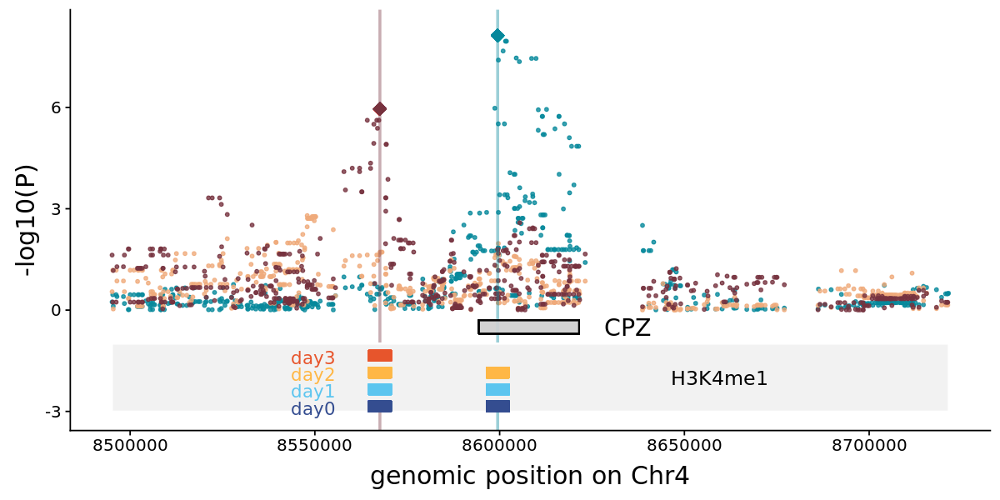

In [45]:
df0 = res.ips[res.ips$feature == gene,]
df0$stage = "ips"
df1 = res.mes[res.mes$feature == gene,]
df1$stage = "mesendo"
df2 = res.defendo[res.defendo$feature == gene,]
df2$stage = "defendo"
df = rbind(df0,df1,df2)
m = min(df$p_value)
p = ggplot(df, aes(x = pos, y = -log10(p_value), colour = stage))
p = p + geom_point(size = 1, alpha = 0.8)  
p = p + scale_colour_manual(values = c(col_defendo,col_ips,col_mesendo)) 
p = p + xlab(paste0("genomic position on Chr", df$chrom[1])) + ylab("-log10(P)") 
p = p + ylim(c(-3,-log10(m)+0.2))
# p = p + ggtitle(gene)
p = p + geom_vline(xintercept = res[res$stage == "defendo","snp_position"], col = col_defendo, alpha = 0.4, size = 1)
p = p + geom_vline(xintercept = res[res$stage == "mesendo","snp_position"], col = col_mesendo, alpha = 0.4, size = 1)
p = p + geom_vline(xintercept = res[res$stage == "ips","snp_position"], col = col_ips, alpha = 0.4, size = 1)
p = p + geom_point(aes(x = res[res$stage == "defendo","snp_position"], 
                       y = -log10(res[res$stage == "defendo","p_value.mean"])), col = col_defendo, pch = 23, 
                   size = 3, fill = col_defendo, alpha = 0.6)
p = p + geom_point(aes(x = res[res$stage == "ips","snp_position"], 
                       y = -log10(res[res$stage == "ips","p_value.mean"])), col = col_ips, pch = 23, 
                   size = 3, fill = col_ips, alpha = 0.6)
p = p + geom_rect(mapping = aes(xmin = gene_start, xmax = gene_end, ymin = -0.7, ymax = -0.3), 
                  color = "black", alpha = 0.1, fill = "lightgrey")
p = p + geom_rect(mapping = aes(xmin = min(df$pos), xmax = max(df$pos), ymin = -3, ymax = -1), 
                  color = "white", fill = "gray95")
p = p + geom_rect(mapping = aes(xmin = res[res$stage == "defendo","snp_position"]-3000, 
                                xmax = res[res$stage == "defendo","snp_position"]+3000, ymin = -1.5, ymax = -1.2), 
                  color = col_day3, fill = col_day3)
p = p + geom_rect(mapping = aes(xmin = res[res$stage == "defendo","snp_position"]-3000, 
                                xmax = res[res$stage == "defendo","snp_position"]+3000, ymin = -2, ymax = -1.7), 
                  color = col_day2, fill = col_day2)
p = p + geom_rect(mapping = aes(xmin = res[res$stage == "defendo","snp_position"]-3000, 
                                xmax = res[res$stage == "defendo","snp_position"]+3000, ymin = -2.5, ymax = -2.2), 
                  color = col_day1, fill = col_day1)
p = p + geom_rect(mapping = aes(xmin = res[res$stage == "defendo","snp_position"]-3000, 
                                xmax = res[res$stage == "defendo","snp_position"]+3000, ymin = -3, ymax = -2.7), 
                  color = col_day0, fill = col_day0)
p = p + geom_rect(mapping = aes(xmin = res[res$stage == "ips","snp_position"]-3000, 
                                xmax = res[res$stage == "ips","snp_position"]+3000, ymin = -2, ymax = -1.7), 
                  color = col_day2, fill = col_day2)
p = p + geom_rect(mapping = aes(xmin = res[res$stage == "ips","snp_position"]-3000, 
                                xmax = res[res$stage == "ips","snp_position"]+3000, ymin = -2.5, ymax = -2.2), 
                  color = col_day1, fill = col_day1)
p = p + geom_rect(mapping = aes(xmin = res[res$stage == "ips","snp_position"]-3000, 
                                xmax = res[res$stage == "ips","snp_position"]+3000, ymin = -3, ymax = -2.7), 
                  color = col_day0, fill = col_day0)
p <- p + annotate("text", x = gene_end + 13000, y = -0.5, label = "CPZ", col = "black", size = 6)
p <- p + annotate("text", x = res[res$stage == "defendo","snp_position"]-18000, y = -1.4, label = "day3", 
                  col = col_day3, size = 4.5)
p <- p + annotate("text", x = res[res$stage == "defendo","snp_position"]-18000, y = -1.9, label = "day2", 
                  col = col_day2, size = 4.5)
p <- p + annotate("text", x = res[res$stage == "defendo","snp_position"]-18000, y = -2.4, label = "day1", 
                  col = col_day1, size = 4.5)
p <- p + annotate("text", x = res[res$stage == "defendo","snp_position"]-18000, y = -2.9, label = "day0", 
                  col = col_day0, size = 4.5)
p <- p + annotate("text", x = res[res$stage == "ips","snp_position"]+60000, y = -2, label = "H3K4me1", 
                  col = "black", size = 5)
options(repr.plot.width = 10, repr.plot.height = 5)
p + theme(legend.position = "none", text = element_text(size = 18))

[1] "ENSG00000100490_CDKL1"

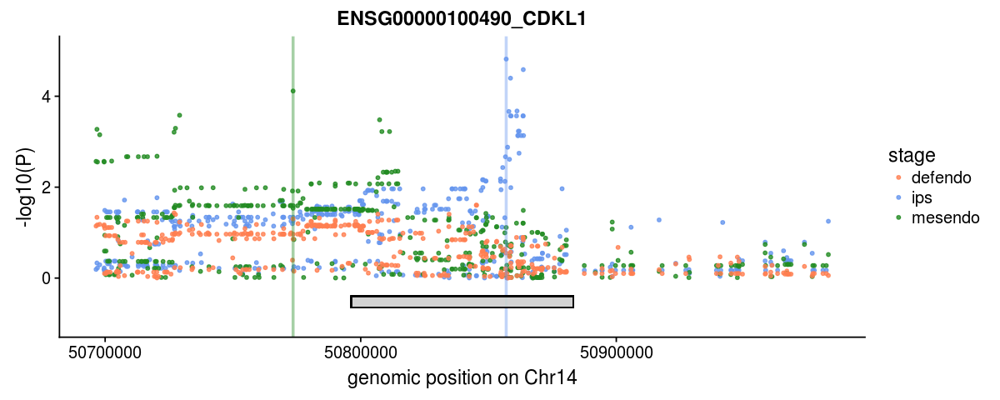

In [41]:
lead_switches = dupl[dupl$lead.switch == "T",]
i = 20
gene = unique(lead_switches$feature)[i]
gene
gene_start = 50796310
gene_end = 50883179
res = lead_switches[lead_switches$feature == gene,]
df0 = res.ips[res.ips$feature == gene,]
df0$stage = "ips"
df1 = res.mes[res.mes$feature == gene,]
df1$stage = "mesendo"
df2 = res.defendo[res.defendo$feature == gene,]
df2$stage = "defendo"
df = rbind(df0,df1,df2)
m = min(df$p_value)
p = ggplot(df, aes(x = pos, y = -log10(p_value), colour = stage))
p = p + geom_point(size = 1, alpha = 0.8)  
p = p + scale_colour_manual(values = c("coral","cornflowerblue","forestgreen")) 
p = p + xlab(paste0("genomic position on Chr", df$chrom[1])) + ylab("-log10(P)") 
p = p + ylim(c(-1,-log10(m)+0.2))
p = p + ggtitle(gene)
p = p + geom_vline(xintercept = res[res$stage == "defendo","snp_position"], col = "coral", alpha = 0.4, size = 1)
p = p + geom_vline(xintercept = res[res$stage == "mesendo","snp_position"], col = "forestgreen", alpha = 0.4, size = 1)
p = p + geom_vline(xintercept = res[res$stage == "ips","snp_position"], col = "cornflowerblue", alpha = 0.4, size = 1)
p = p + geom_rect(mapping = aes(xmin = gene_start, xmax = gene_end, ymin = -0.65, ymax = -0.4), 
                  color = "black", alpha = 0.1, fill = "lightgrey")
options(repr.plot.width = 10, repr.plot.height = 4)
p

[1] "ENSG00000102858_MGRN1"

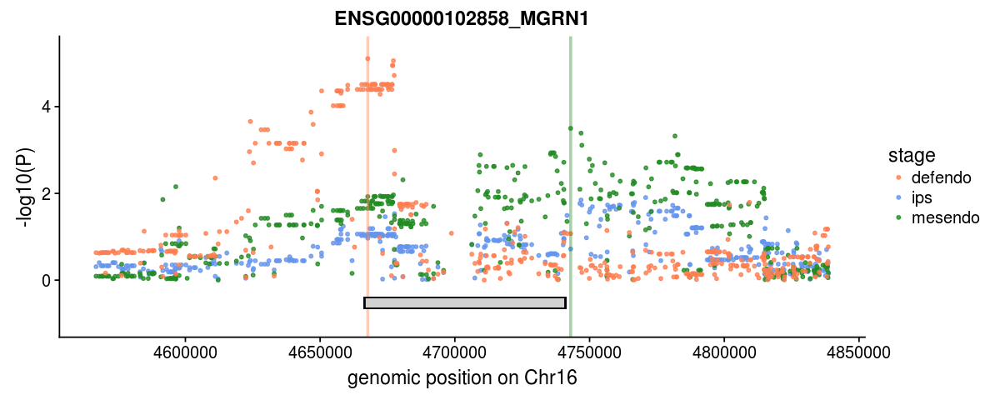

In [45]:
lead_switches = dupl[dupl$lead.switch == "T",]
i = 23
gene = unique(lead_switches$feature)[i]
gene
gene_start = 4666494
gene_end = 4740975
res = lead_switches[lead_switches$feature == gene,]
df0 = res.ips[res.ips$feature == gene,]
df0$stage = "ips"
df1 = res.mes[res.mes$feature == gene,]
df1$stage = "mesendo"
df2 = res.defendo[res.defendo$feature == gene,]
df2$stage = "defendo"
df = rbind(df0,df1,df2)
m = min(df$p_value)
p = ggplot(df, aes(x = pos, y = -log10(p_value), colour = stage))
p = p + geom_point(size = 1, alpha = 0.8)  
p = p + scale_colour_manual(values = c("coral","cornflowerblue","forestgreen")) 
p = p + xlab(paste0("genomic position on Chr", df$chrom[1])) + ylab("-log10(P)") 
p = p + ylim(c(-1,-log10(m)+0.2))
p = p + ggtitle(gene)
p = p + geom_vline(xintercept = res[res$stage == "defendo","snp_position"], col = "coral", alpha = 0.4, size = 1)
p = p + geom_vline(xintercept = res[res$stage == "mesendo","snp_position"], col = "forestgreen", alpha = 0.4, size = 1)
p = p + geom_vline(xintercept = res[res$stage == "ips","snp_position"], col = "cornflowerblue", alpha = 0.4, size = 1)
p = p + geom_rect(mapping = aes(xmin = gene_start, xmax = gene_end, ymin = -0.65, ymax = -0.4), 
                  color = "black", alpha = 0.1, fill = "lightgrey")
options(repr.plot.width = 10, repr.plot.height = 4)
p

[1] 1


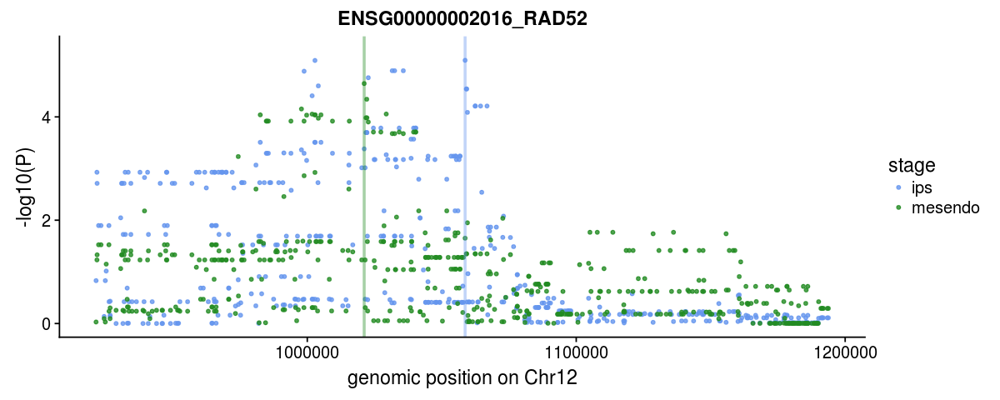

[1] 5


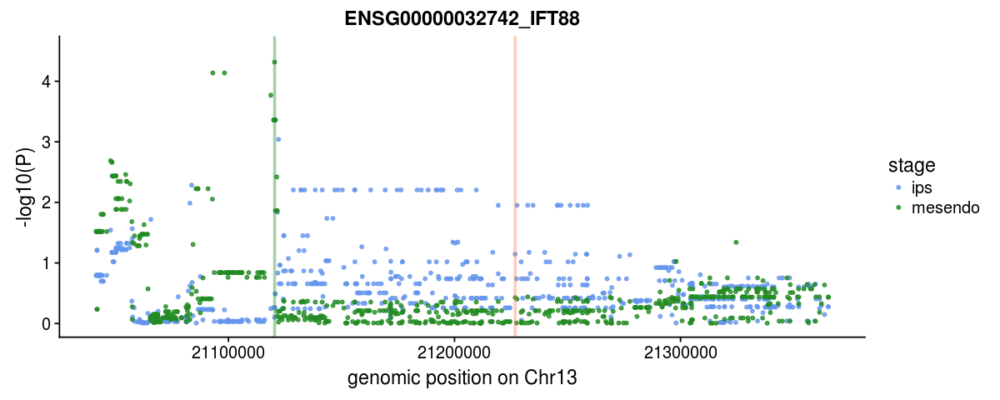

[1] 21


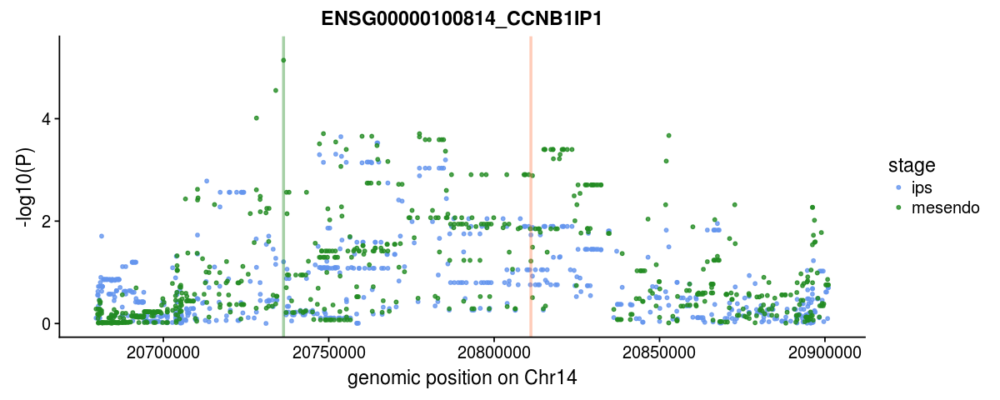

[1] 35


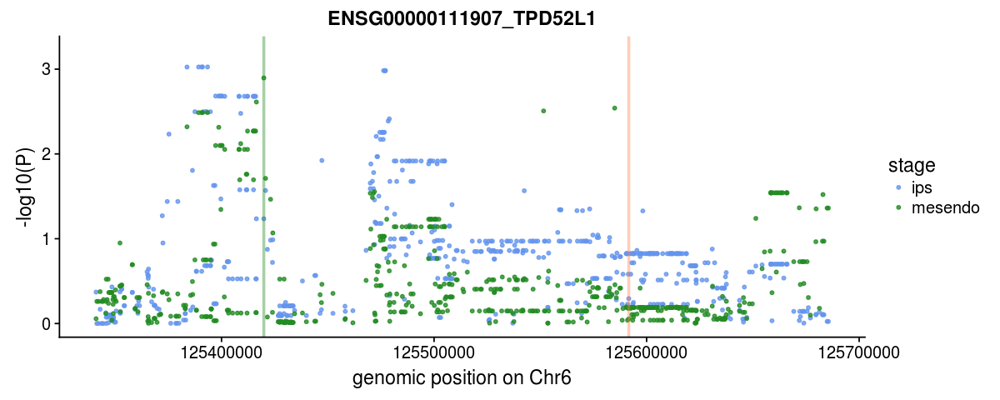

[1] 48


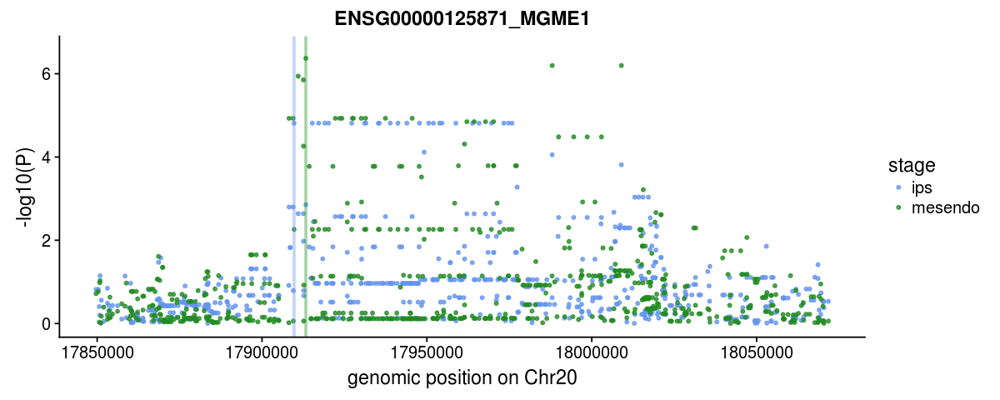

[1] 61


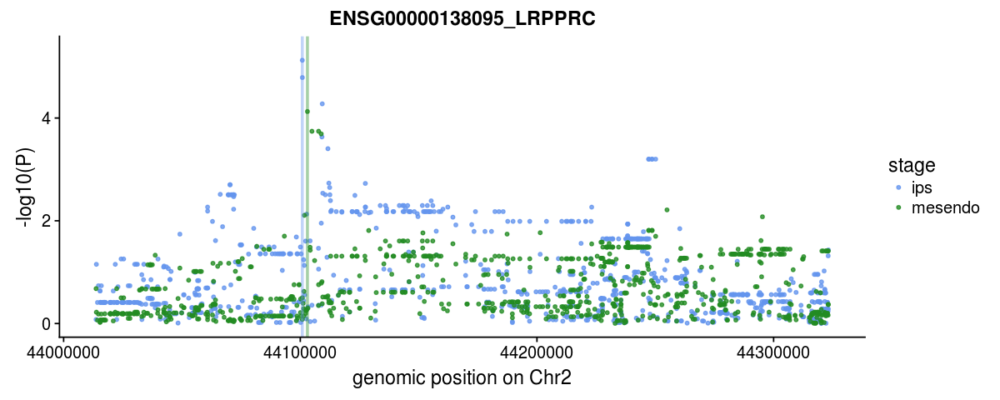

[1] 78


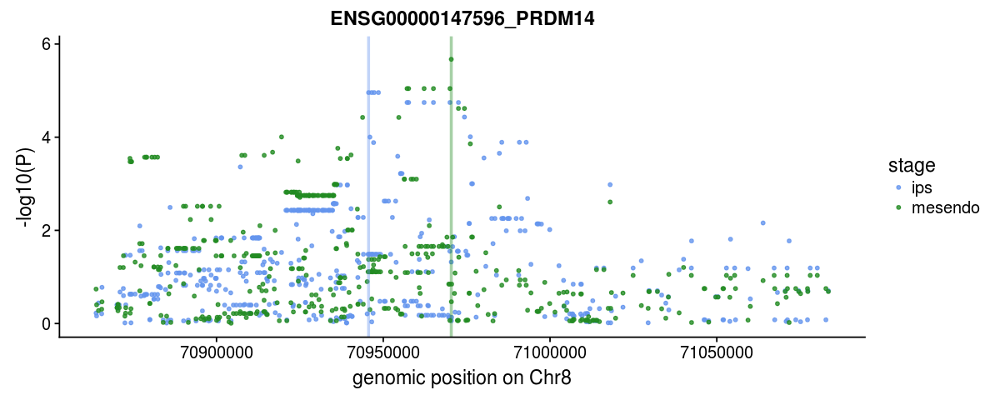

[1] 95


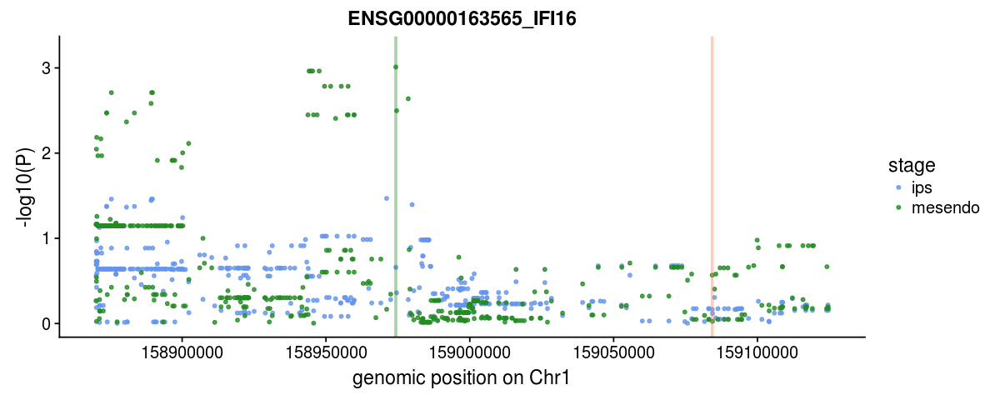

[1] 129


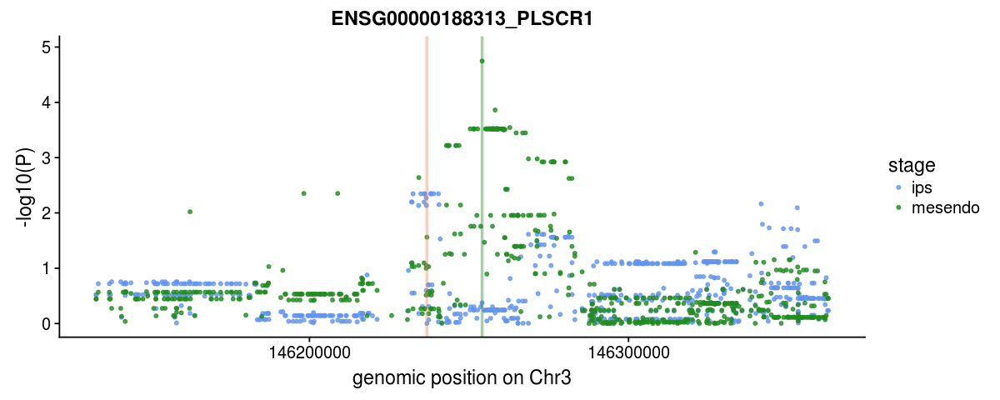

[1] 138


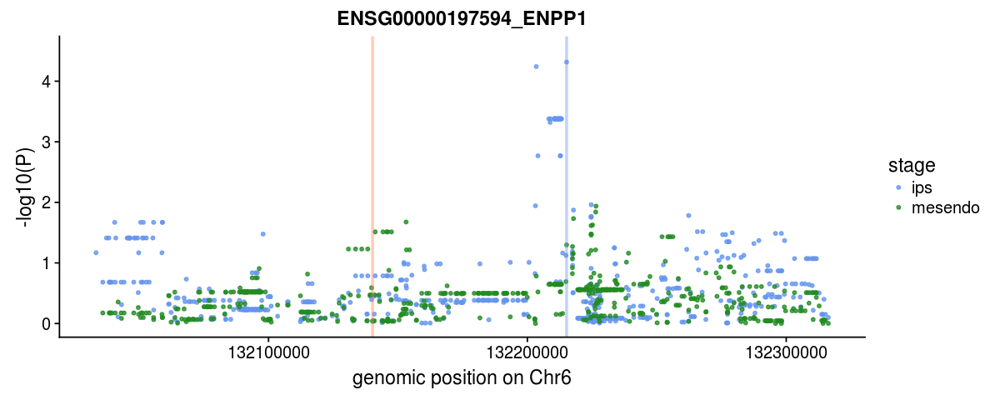

In [79]:
lead_switches = dupl[dupl$lead.switch == "T",]
for (i in 1:length(unique(lead_switches$feature))){
# for (i in 138){
    if (!(i %in% c(1, 5, 21, 35, 48, 61, 78, 95, 129, 138))){ next }
    gene = unique(lead_switches$feature)[i]
    res = lead_switches[lead_switches$feature == gene,]
    df0 = res.ips[res.ips$feature == gene,]
    df0$stage = "ips"
    # head(df0)
    df1 = res.mes[res.mes$feature == gene,]
    df1$stage = "mesendo"
    # head(df1)
    # head(df2)
    df = rbind(df0,df1)
    # head(df)
    m = min(df$p_value)
    p = ggplot(df, aes(x = pos, y = -log10(p_value), colour = stage))
    p = p + geom_point(size = 1, alpha = 0.8)  
    p = p + scale_colour_manual(values = c("cornflowerblue","forestgreen")) 
    p = p + xlab(paste0("genomic position on Chr", df$chrom[1])) + ylab("-log10(P)") 
    p = p + ylim(c(0,-log10(m)+0.2))
    p = p + ggtitle(gene)
    p = p + geom_vline(xintercept = res[res$stage == "defendo","snp_position"], col = "coral", alpha = 0.4, size = 1)
    p = p + geom_vline(xintercept = res[res$stage == "mesendo","snp_position"], col = "forestgreen", alpha = 0.4, size = 1)
    p = p + geom_vline(xintercept = res[res$stage == "ips","snp_position"], col = "cornflowerblue", alpha = 0.4, size = 1)
    options(repr.plot.width = 10, repr.plot.height = 4)
    print(p)
    print (i)
}


In [48]:
paste0(res[1, "snp_id"], "-", res[1, "feature"])

[1] "15_65816621_C_T-ENSG00000074696_PTPLAD1"

In [49]:
res[2,"eQTL"]

[1] "15_65772135_T_C-ENSG00000074603_DPP8;15_65865265_A_T-ENSG00000074696_PTPLAD1"

In [57]:
(grep(paste0(res[1, "snp_id"], "-", res[1, "feature"]),res[2,"eQTL"]) > 0 |
grep(paste0(res[2,"snp_id"],"-",res[2,"feature"]), res[1,"eQTL"]) > 0)

logical(0)

In [18]:
grep(paste0(res[1,"snp_id"],"-",res[1,"feature"]), res[2,"eQTL"])

[1] 1

In [19]:
paste0(res[1,"snp_id"],"-",res[1,"feature"])

[1] "7_91764128_C_A-ENSG00000001630_CYP51A1"

In [20]:
res[2,"eQTL"]

[1] "7_91764128_C_A-ENSG00000001630_CYP51A1;7_91643402_G_T-ENSG00000001630_CYP51A1"

In [21]:
grep(paste0(res[2,"snp_id"],"-",res[2,"feature"]), res[1,"eQTL"])

[1] 1

In [22]:
paste0(res[2,"snp_id"],"-",res[2,"feature"])
res[1,"eQTL"]

[1] "7_91643402_G_T-ENSG00000001630_CYP51A1"

[1] "7_91764128_C_A-ENSG00000001630_CYP51A1;7_91643402_G_T-ENSG00000001630_CYP51A1"